# Applying SAIPy Network: loading data - multiple stations

This notebook demonstrates the use of the package for multiple stations.
* May 2025.

In [1]:
import os
import pandas as pd
import time
import torch
from datetime import datetime
from saipy.data.realdata import load_streams, preprocessing
from saipy.utils.networktools import make_monitor_multistations, network_detect
from saipy.utils.visualizations import *

#  Customized by the user – adjust filename as needed and date format!
from saipy.user_settings import date_format_object, set_filename

2025-08-19 14:06:37.156934: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [2]:
%reload_ext autoreload
%autoreload 2
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

## $(\mathrm{i})$ Paths

In [3]:
# Path to be defined by users
dirmodel = '../saipy/saved_models/'
dirwork = '../'
dirdata = os.path.join(dirwork,'Data_examples/Data_network/')
subnm = datetime.now().strftime("%Y-%m-%d_%H-%M-%S")

dirout = os.path.join(dirwork,f"results/test_network_{subnm}/")
# Create output folder
os.mkdir(dirout)

## $(\mathrm{ii})$ Customized Parameters
## **********************  Warning  ****************************************
### You must edit **user_settings.py** to customize the functions to match
### the file naming convention and format used in your dataset!
####
### - **set_filename** & **date_format_object** : file name structures,
### which are used in the SAIPy's modules to load data, label plots
### and keys in dictionaries to store results.
####
### - **read_non_seismic_format** : read data in case that your data format
### is not supported by Obspy
### ************************************************************************

In [4]:
# Files names & Parameters
channels = ['E','N','Z']
station_list = ['PR34','PR44'] # station ID.
dir_stat_name = ['PR34_data','PR44_data'] # name of folders per station.
format = ".mseed"  #".SAC" # File extension

# For output results
# Create a dictionary with the start time as in the file name (date, hour, minute, and second)
time_dict = {"20170908": ["170000","190000"],
             "20170909": ["060000"],
            }
# Example using format in Jualian day:
#time_dict = {"2017.151": ["000000"]} 

## $(\mathrm{iii})$ Single-Station process

In [ ]:
# Parameters
# For single station monitoring
lw = 15 # len_win: total time window per earthquake for phase picking (in seconds) 
dw = 5 # detection_windows: number of consecutive positive outputs of Creime_RT for detection


** Reading data: station PR34, date 2017-09-08 17:00:00... **

** Preprocessing data... **
Time elapsed: 0.17078900337219238 

** Monitoring data... **
Earthquake scan time window: 15 seconds
Stepsize for detection: 10 samples
Earthquake detected with 5 consecutive positive detections
Stepsize for picking: 10 samples

1) Running Creime_rt for event detection and magnitude


/Volumes/GUAN_YIN/SAIPy_Network_Paper/SAIPy_network/venv_saipy/lib/python3.8/site-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


141/141 [==============================] - 588s 4s/step
Time elapsed: 603.03 seconds
Number of detected earthquake windows: 4177

___________________________________________

Detected event window indices: [1854, 1856, 1857, 1859, 1860]
Continuity check result: False
No events detected till 2017-09-08T17:03:04.600000Z

___________________________________________

Detected event window indices: [1856, 1857, 1859, 1860, 1892]
Continuity check result: False
No events detected till 2017-09-08T17:03:04.900000Z

___________________________________________

Detected event window indices: [1859, 1860, 1892, 1894, 1895]
Continuity check result: False
No events detected till 2017-09-08T17:03:08.200000Z

___________________________________________

Detected event window indices: [1892, 1894, 1895, 1896, 1897]
Continuity check result: False
No events detected till 2017-09-08T17:03:08.400000Z

___________________________________________

Detected event window indices: [1894, 1895, 1896, 1897, 1898]

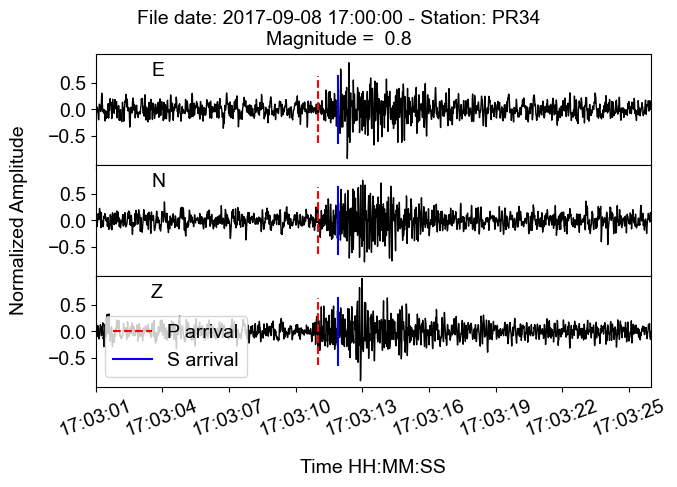

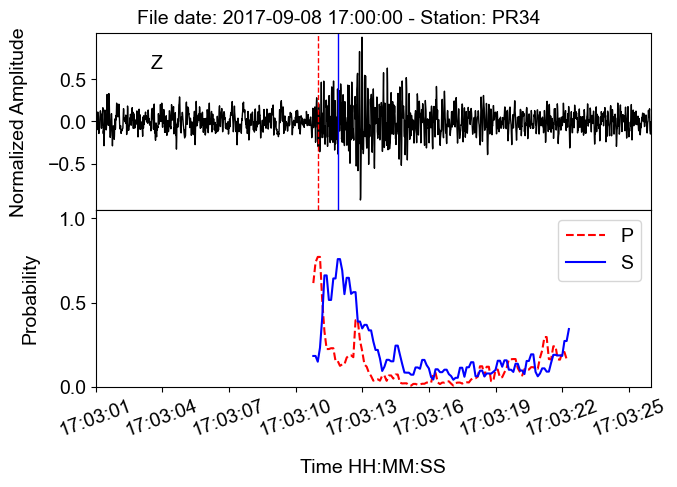

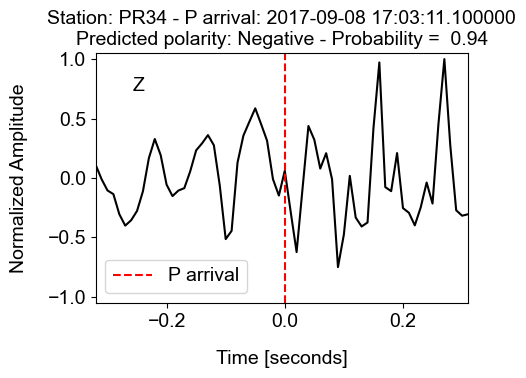


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [4271, 4272, 4273, 4274, 4275]
Continuity check result: True

____________ Event: 2 _____________

2) Running DynaPicker for phase picking
Time elapsed: 20.05 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 210ms/step
Time elapsed: 0.60 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:07:15.400000Z
S-arrival: 2017-09-08T17:07:16.500000Z
Magnitude: 0.4000000059604645
Polarity: Positive (Probability: 0.985)


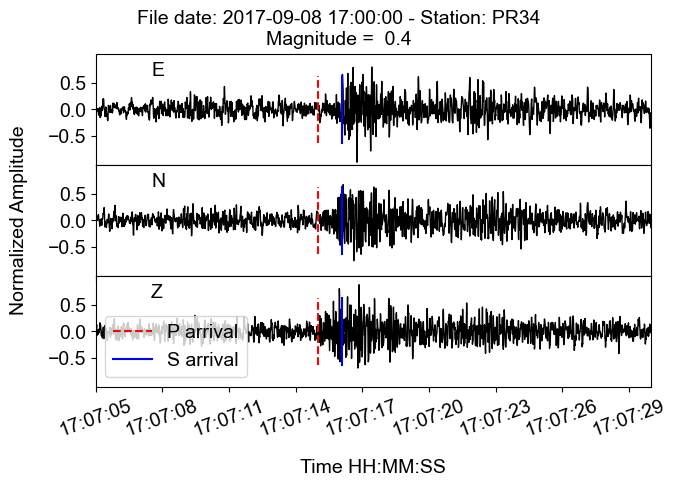

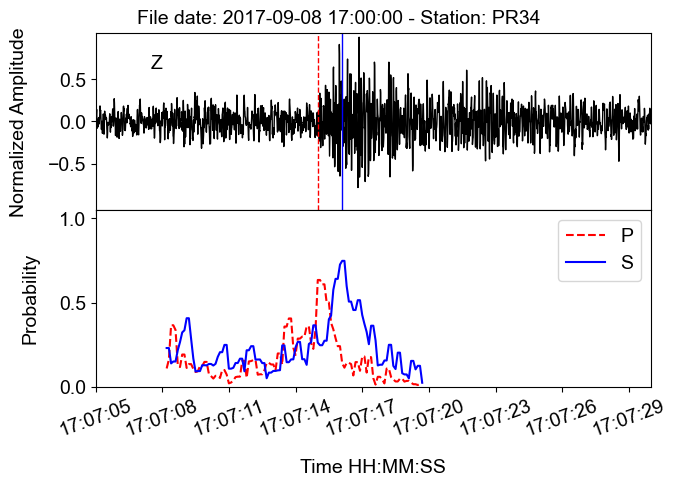

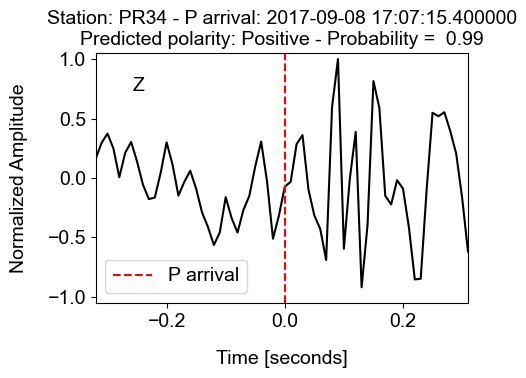


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [4544, 4545, 4546, 4547, 4548]
Continuity check result: True

____________ Event: 3 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.34 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 414ms/step
Time elapsed: 0.94 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:07:42.800000Z
S-arrival: 2017-09-08T17:07:43.800000Z
Magnitude: 1.0
Polarity: Positive (Probability: 0.844)


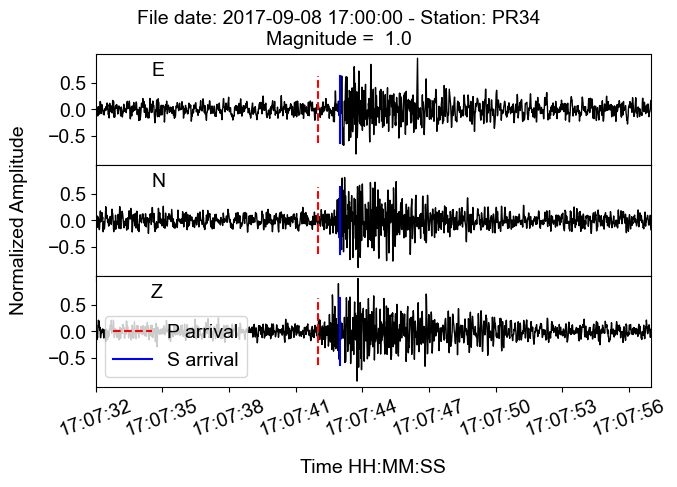

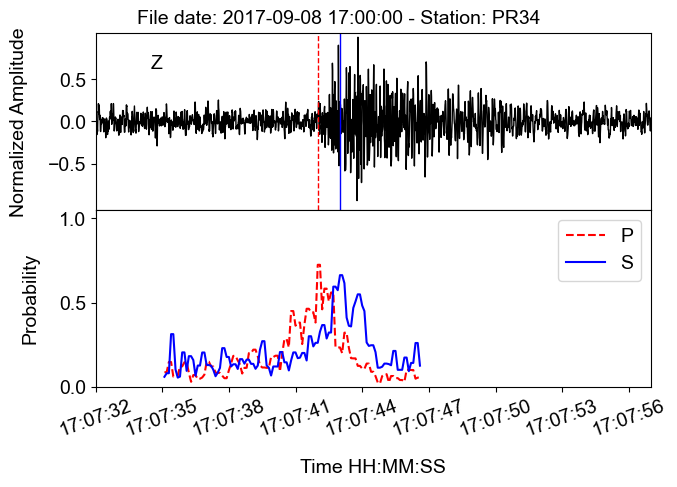

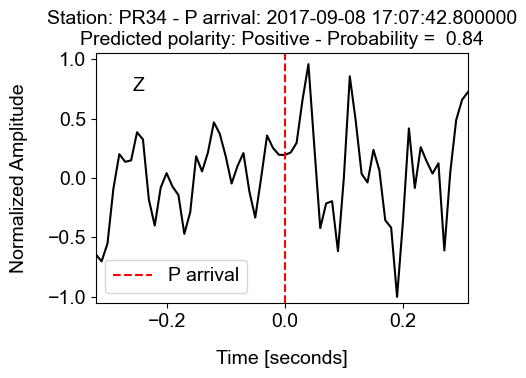


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [4830, 4831, 4832, 4833, 4834]
Continuity check result: True

____________ Event: 4 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.49 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 210ms/step
Time elapsed: 0.69 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:08:11.700000Z
S-arrival: 2017-09-08T17:08:12.100000Z
Magnitude: 0.800000011920929
Polarity: Negative (Probability: 0.998)


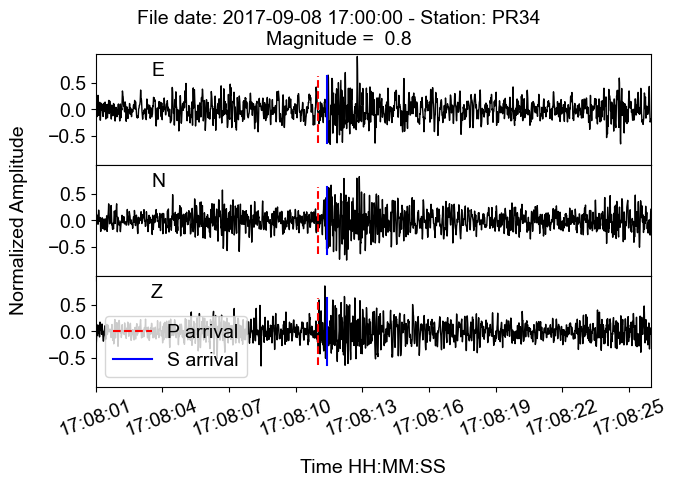

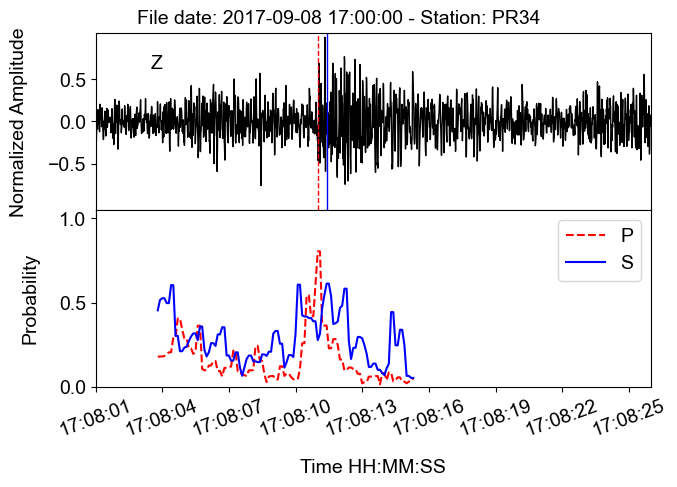

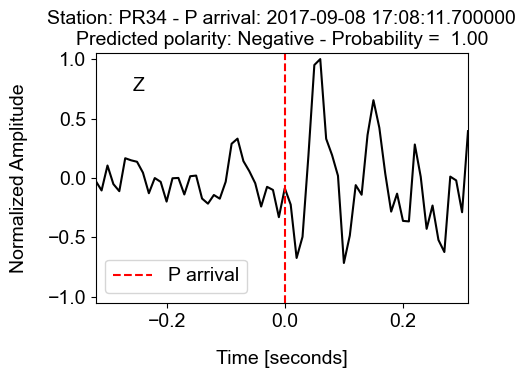


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [5202, 5204, 5205, 5206, 5207]
Continuity check result: False
No events detected till 2017-09-08T17:08:39.400000Z

___________________________________________

Detected event window indices: [5204, 5205, 5206, 5207, 5208]
Continuity check result: True

____________ Event: 5 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.67 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 244ms/step
Time elapsed: 0.68 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:08:53.400000Z
S-arrival: 2017-09-08T17:08:53.400000Z
Magnitude: 0.4000000059604645
Polarity: Positive (Probability: 0.991)


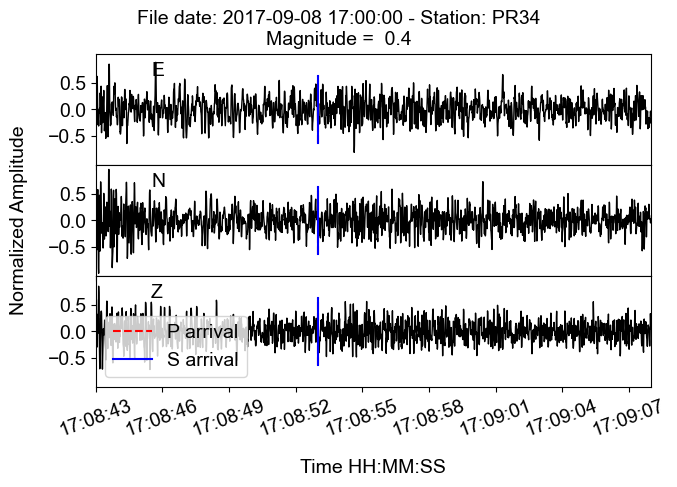

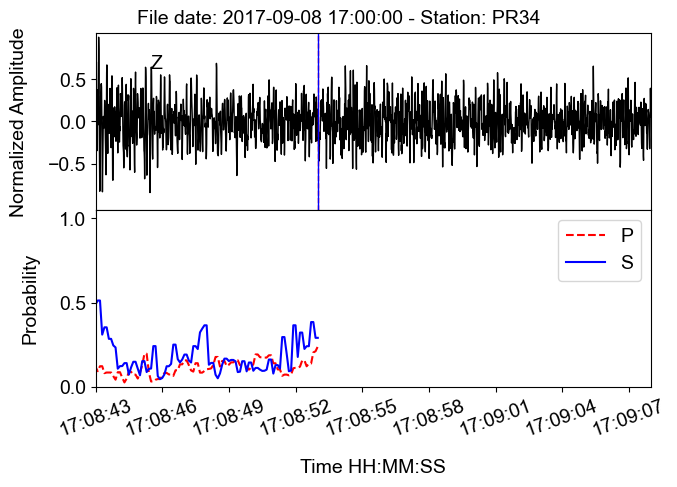

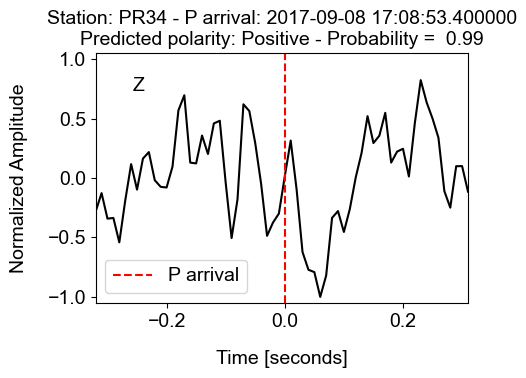


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [5444, 5446, 5454, 5455, 5456]
Continuity check result: False
No events detected till 2017-09-08T17:09:03.600000Z

___________________________________________

Detected event window indices: [5446, 5454, 5455, 5456, 5457]
Continuity check result: False
No events detected till 2017-09-08T17:09:04.400000Z

___________________________________________

Detected event window indices: [5454, 5455, 5456, 5457, 5467]
Continuity check result: False
No events detected till 2017-09-08T17:09:05.700000Z

___________________________________________

Detected event window indices: [5467, 5468, 5469, 5470, 5471]
Continuity check result: True

____________ Event: 6 _____________

2) Running DynaPicker for phase picking
Time elapsed:

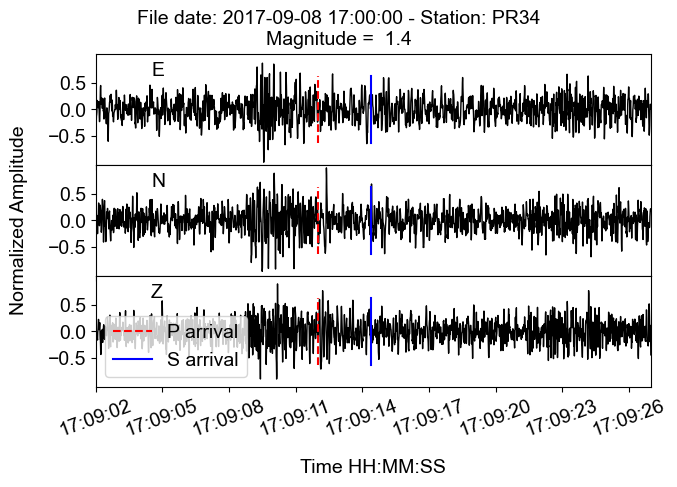

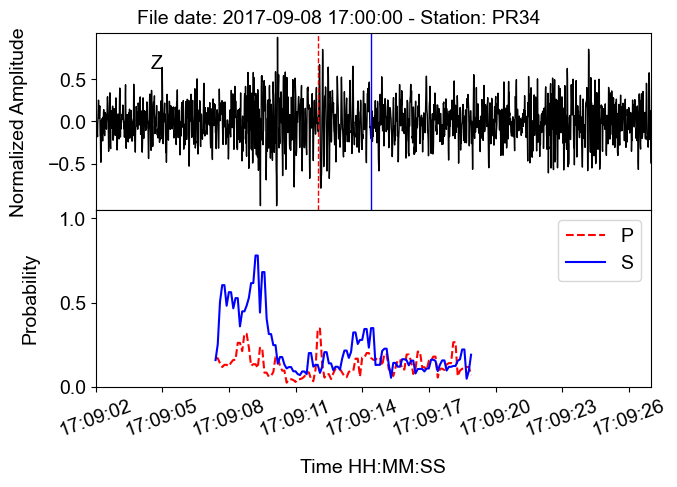

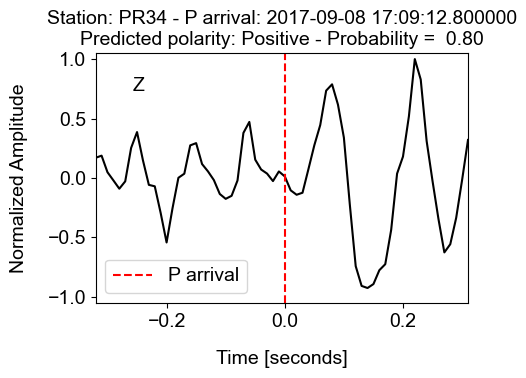


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [5946, 5947, 5948, 5949, 5950]
Continuity check result: True

____________ Event: 7 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.31 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 260ms/step
Time elapsed: 0.63 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:10:03.300000Z
S-arrival: 2017-09-08T17:10:04.100000Z
Magnitude: 1.100000023841858
Polarity: Negative (Probability: 0.998)


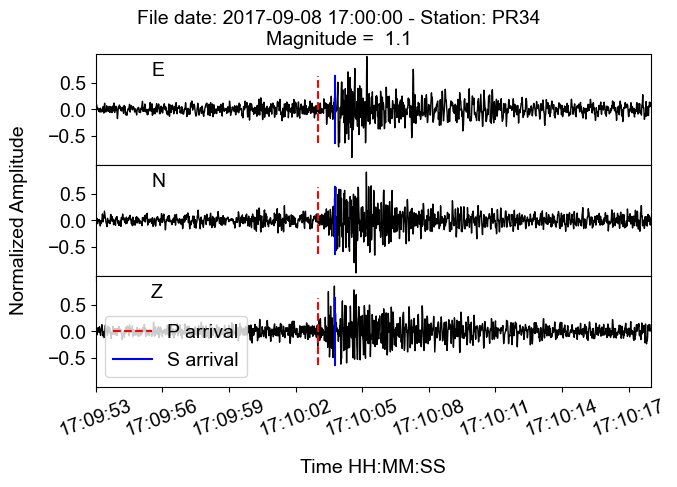

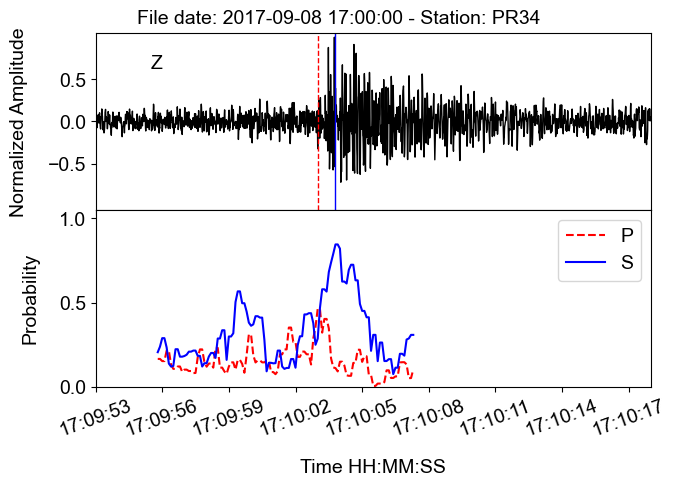

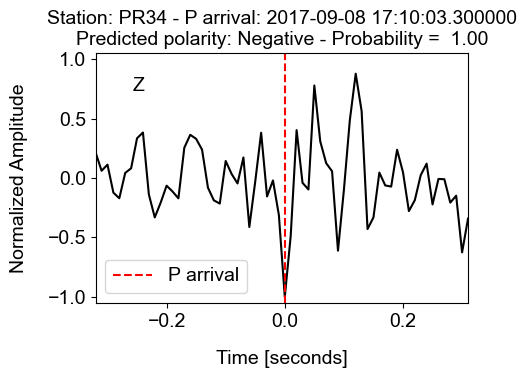


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [6193, 6195, 6196, 6197, 6198]
Continuity check result: False
No events detected till 2017-09-08T17:10:18.500000Z

___________________________________________

Detected event window indices: [6195, 6196, 6197, 6198, 6199]
Continuity check result: True

____________ Event: 8 _____________

2) Running DynaPicker for phase picking
Time elapsed: 15.17 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 248ms/step
Time elapsed: 1.05 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:10:27.600000Z
S-arrival: 2017-09-08T17:10:28.300000Z
Magnitude: 1.100000023841858
Polarity: Positive (Probability: 0.624)


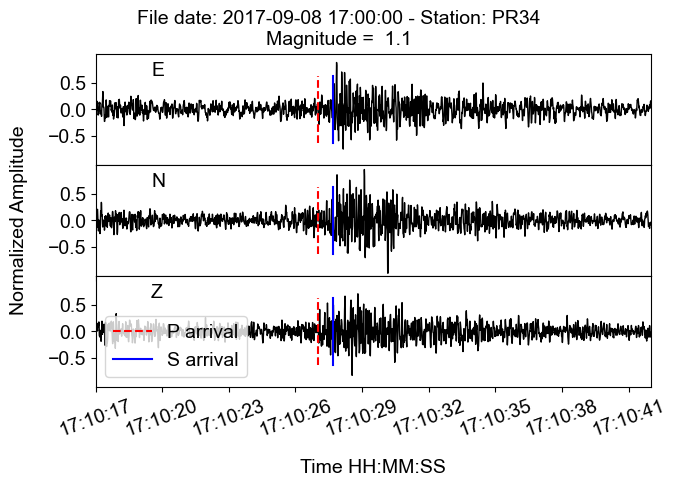

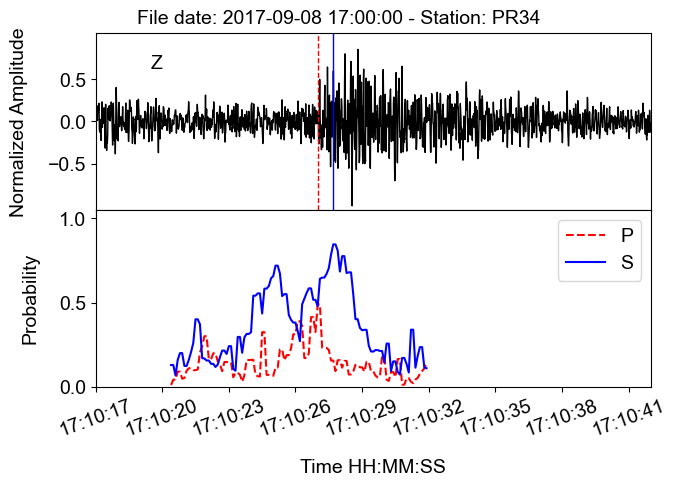

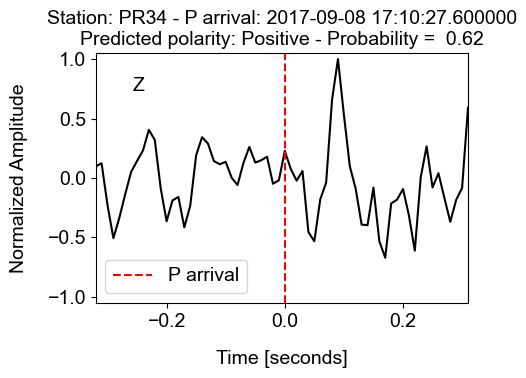


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [6708, 6709, 6710, 6711, 6712]
Continuity check result: True

____________ Event: 9 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.82 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 306ms/step
Time elapsed: 0.82 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:11:14.200000Z
S-arrival: 2017-09-08T17:11:14.300000Z
Magnitude: 1.2999999523162842
Polarity: Positive (Probability: 0.992)


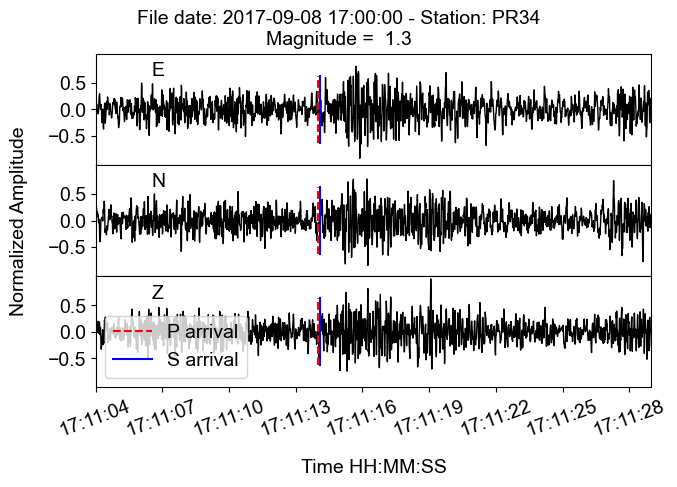

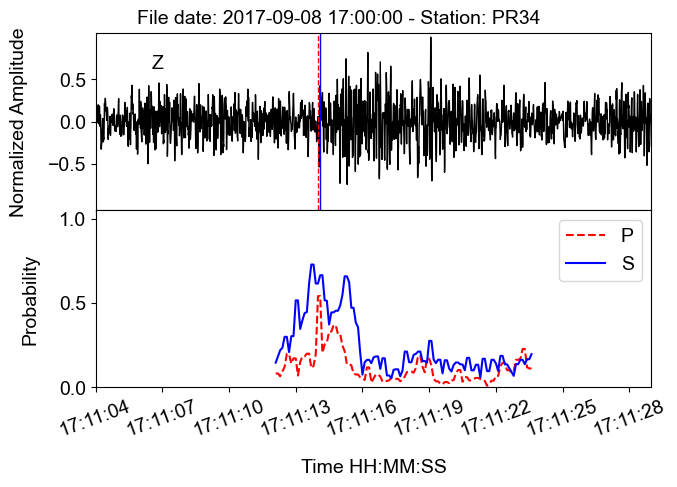

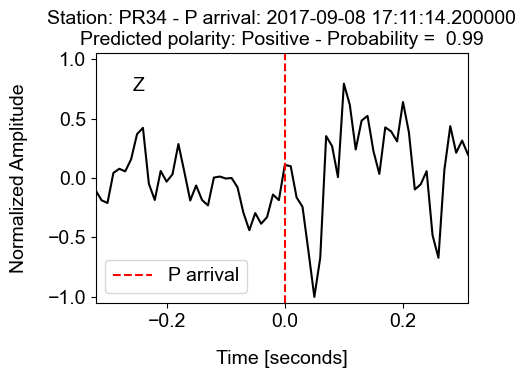


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [6858, 6859, 6860, 6861, 6867]
Continuity check result: False
No events detected till 2017-09-08T17:11:25.700000Z

___________________________________________

Detected event window indices: [6867, 6868, 6869, 6871, 6872]
Continuity check result: False
No events detected till 2017-09-08T17:11:26.100000Z

___________________________________________

Detected event window indices: [6871, 6872, 6873, 6874, 6875]
Continuity check result: True

____________ Event: 10 _____________

2) Running DynaPicker for phase picking
Time elapsed: 15.51 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 342ms/step
Time elapsed: 0.88 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:11:32

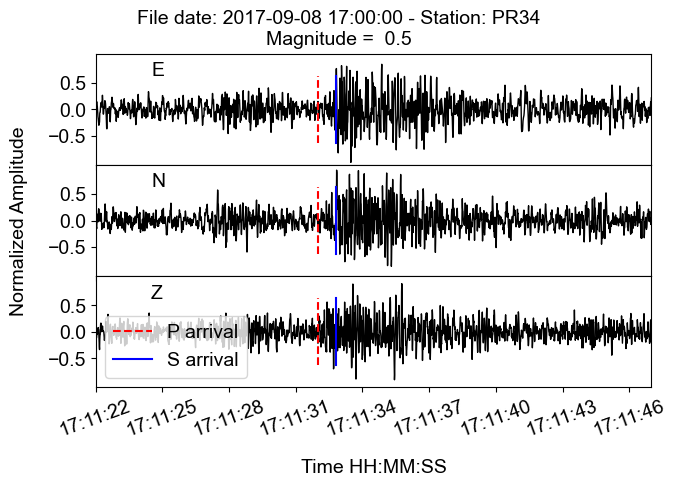

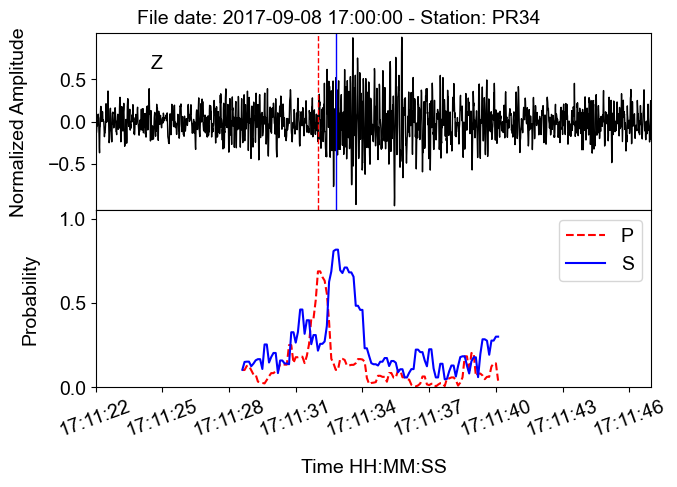

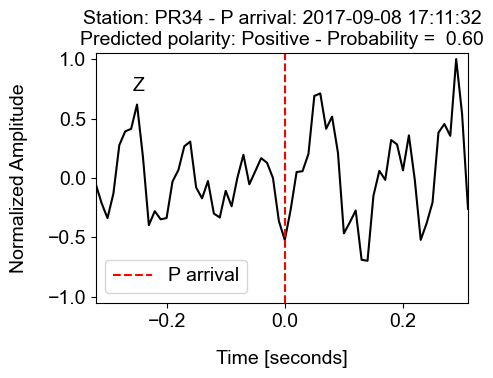


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [7294, 7295, 7296, 7300, 7301]
Continuity check result: False
No events detected till 2017-09-08T17:12:09.000000Z

___________________________________________

Detected event window indices: [7300, 7301, 7302, 7303, 7304]
Continuity check result: True

____________ Event: 11 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.08 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 311ms/step
Time elapsed: 1.18 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:12:17.400000Z
S-arrival: 2017-09-08T17:12:17.700000Z
Magnitude: 0.10000000149011612
Polarity: Negative (Probability: 0.999)


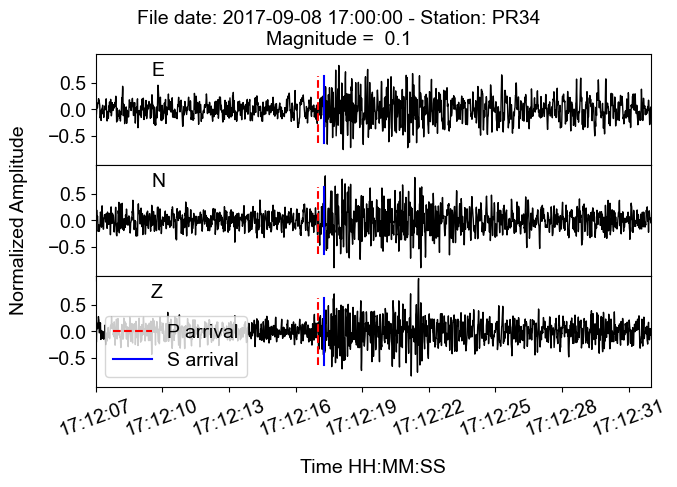

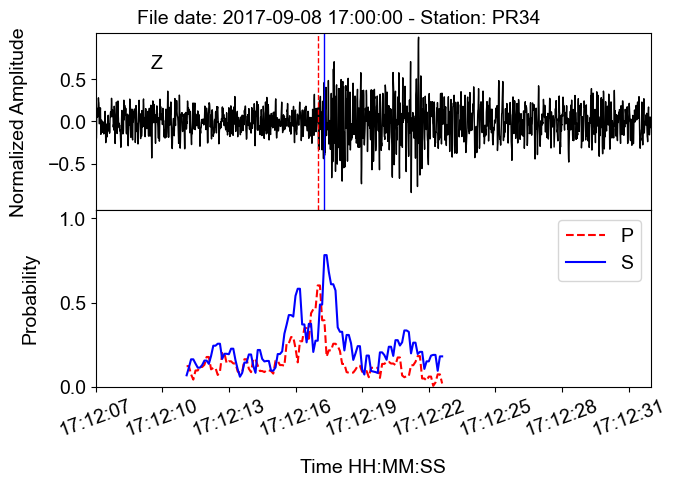

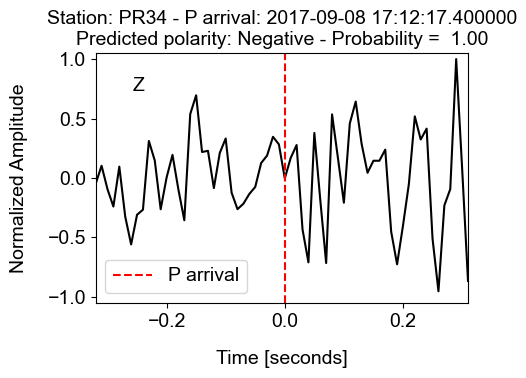


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [7684, 7685, 7686, 7687, 7688]
Continuity check result: True

____________ Event: 12 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.27 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 231ms/step
Time elapsed: 0.62 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:12:56.400000Z
S-arrival: 2017-09-08T17:12:56.900000Z
Magnitude: 0.4000000059604645
Polarity: Negative (Probability: 0.840)


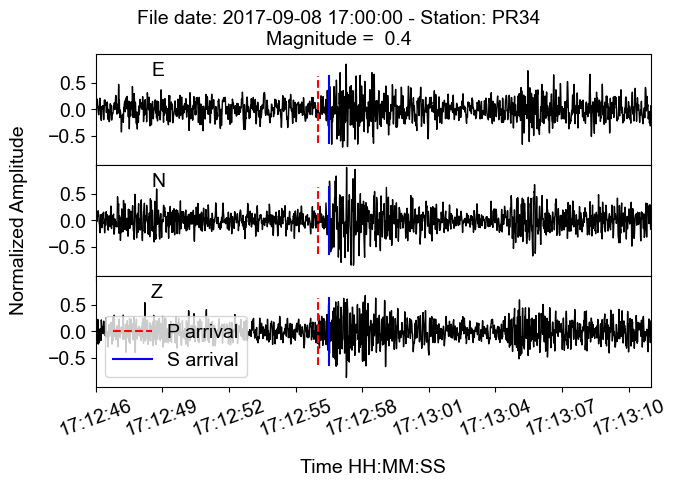

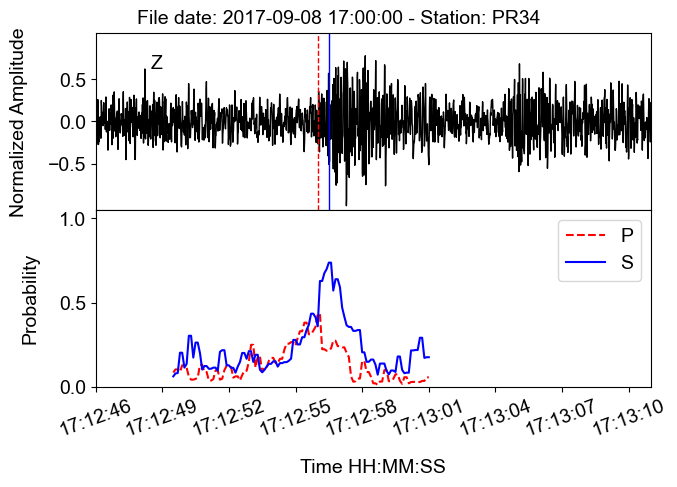

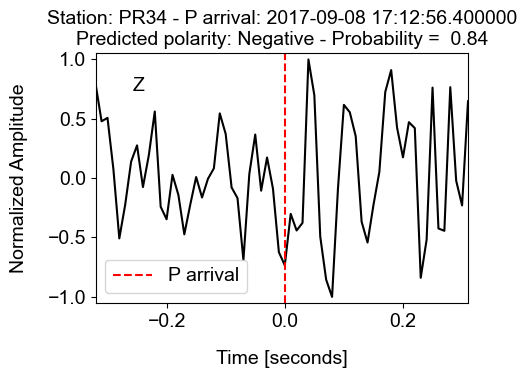


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [7835, 8040, 8050, 8076, 8085]
Continuity check result: False
No events detected till 2017-09-08T17:13:23.000000Z

___________________________________________

Detected event window indices: [8040, 8050, 8076, 8085, 8086]
Continuity check result: False
No events detected till 2017-09-08T17:13:24.000000Z

___________________________________________

Detected event window indices: [8050, 8076, 8085, 8086, 8087]
Continuity check result: False
No events detected till 2017-09-08T17:13:26.600000Z

___________________________________________

Detected event window indices: [8076, 8085, 8086, 8087, 8088]
Continuity check result: False
No events detected till 2017-09-08T17:13:27.500000Z

_____________________________________

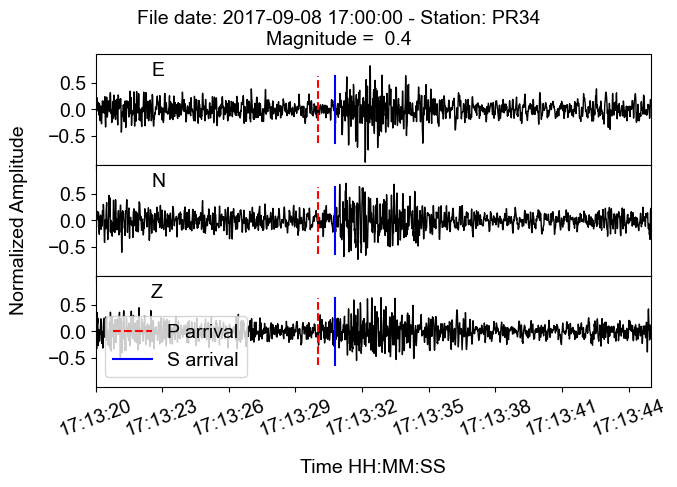

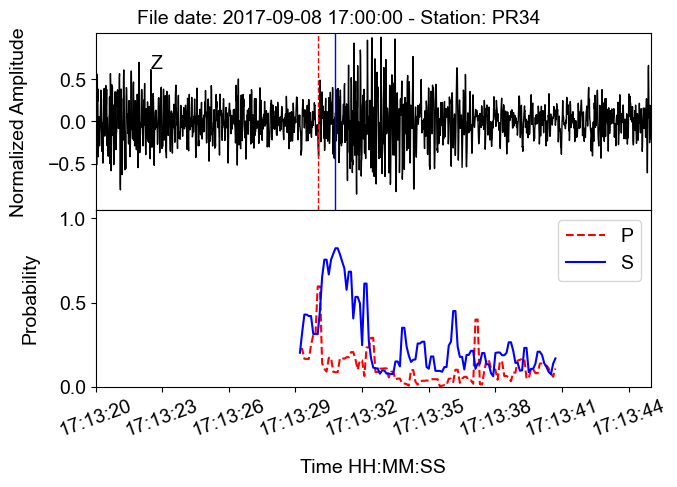

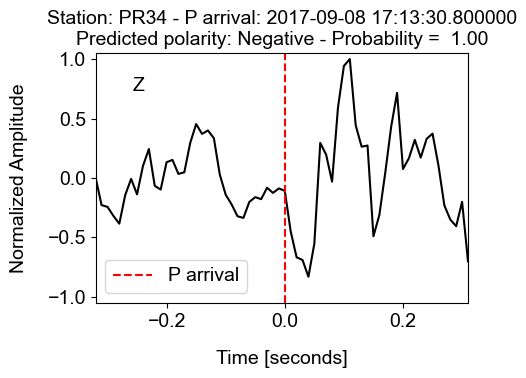


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [8406, 8407, 8408, 8409, 8410]
Continuity check result: True

____________ Event: 14 _____________

2) Running DynaPicker for phase picking
Time elapsed: 16.03 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 376ms/step
Time elapsed: 0.98 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:14:07.000000Z
S-arrival: 2017-09-08T17:14:08.500000Z
Magnitude: 1.0
Polarity: Negative (Probability: 0.999)


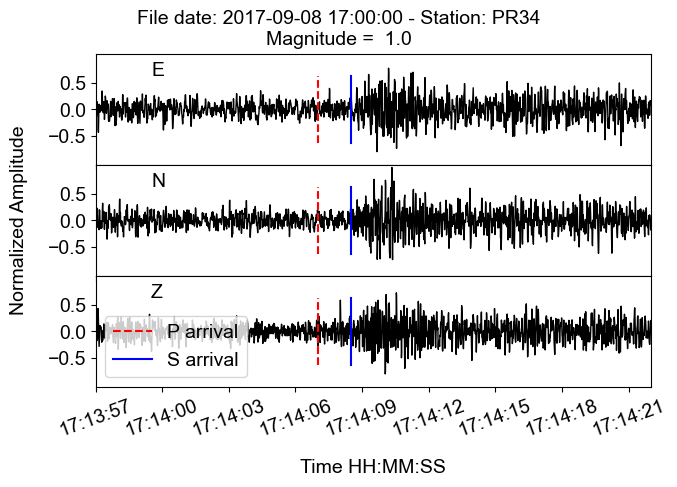

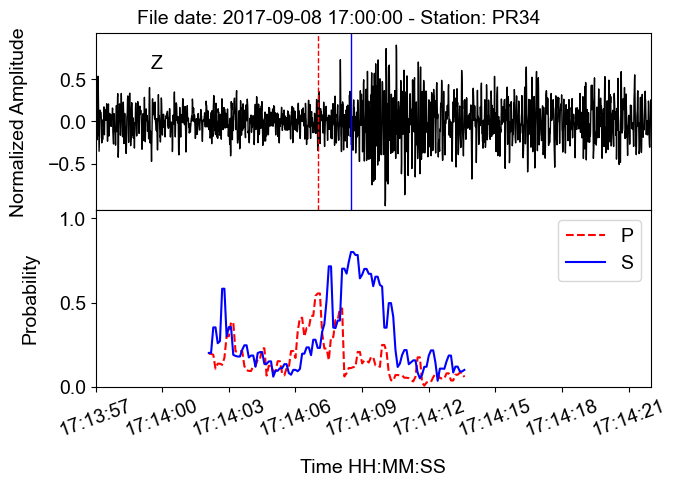

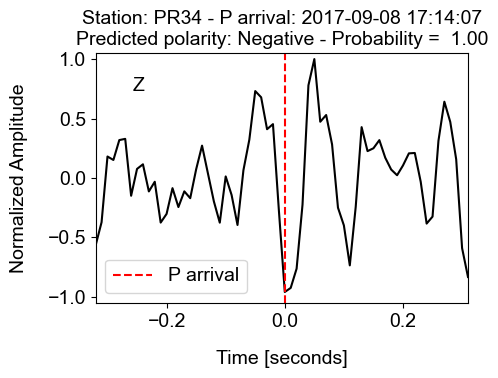


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [8593, 8594, 8595, 8596, 8597]
Continuity check result: True

____________ Event: 15 _____________

2) Running DynaPicker for phase picking
Time elapsed: 25.70 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 295ms/step
Time elapsed: 0.76 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:14:27.900000Z
S-arrival: 2017-09-08T17:14:29.300000Z
Magnitude: 1.7000000476837158
Polarity: Negative (Probability: 0.996)


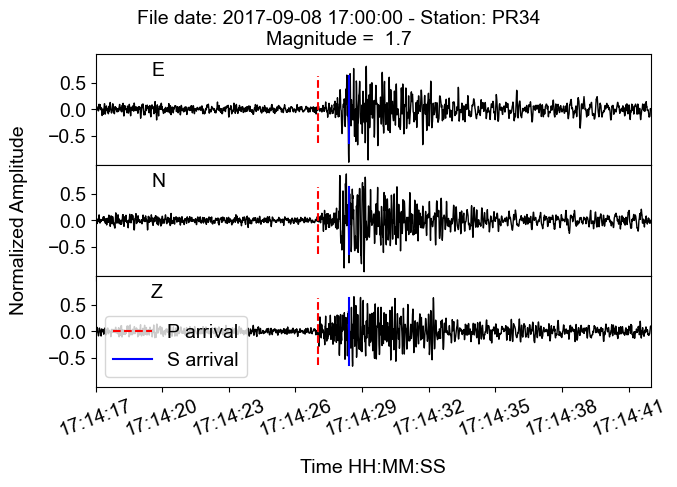

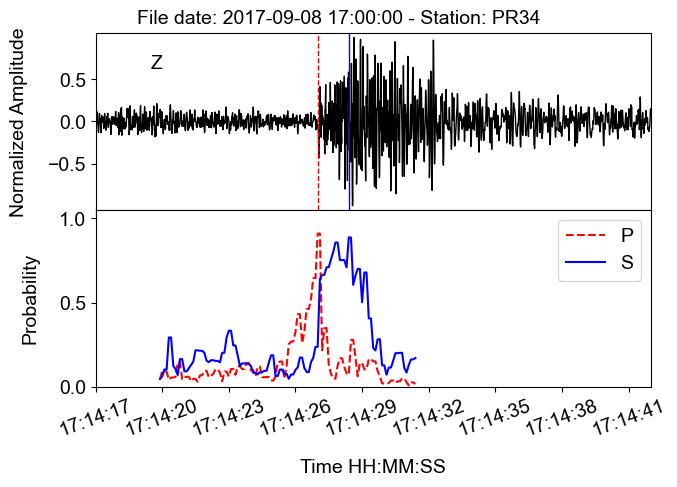

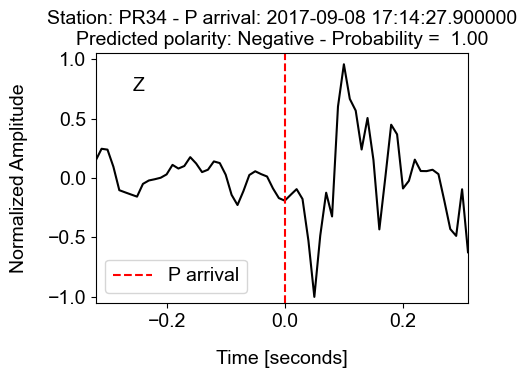


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [8887, 8888, 8889, 9023, 9025]
Continuity check result: False
No events detected till 2017-09-08T17:15:01.300000Z

___________________________________________

Detected event window indices: [9023, 9025, 9026, 9027, 9028]
Continuity check result: False
No events detected till 2017-09-08T17:15:01.500000Z

___________________________________________

Detected event window indices: [9025, 9026, 9027, 9028, 9044]
Continuity check result: False
No events detected till 2017-09-08T17:15:03.400000Z

___________________________________________

Detected event window indices: [9044, 9146, 9147, 9148, 9149]
Continuity check result: False
No events detected till 2017-09-08T17:15:13.600000Z

_____________________________________

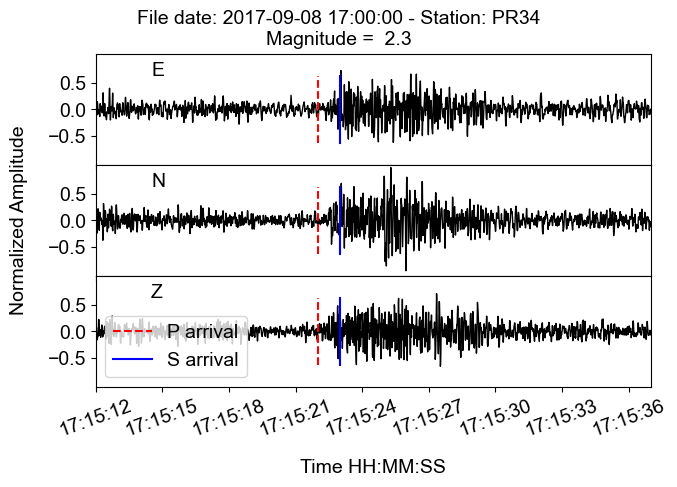

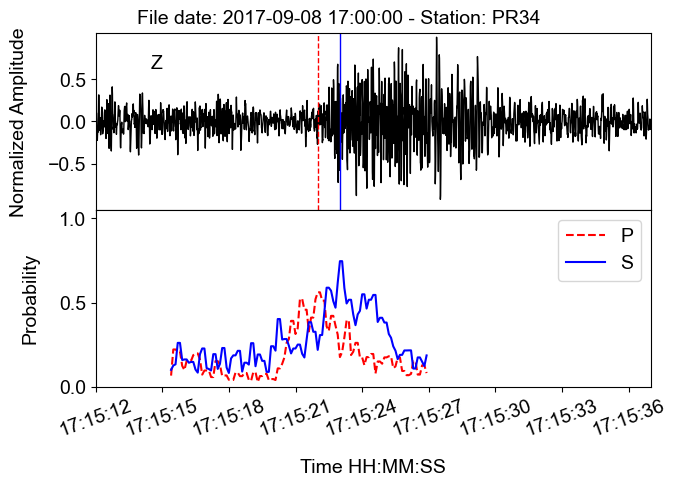

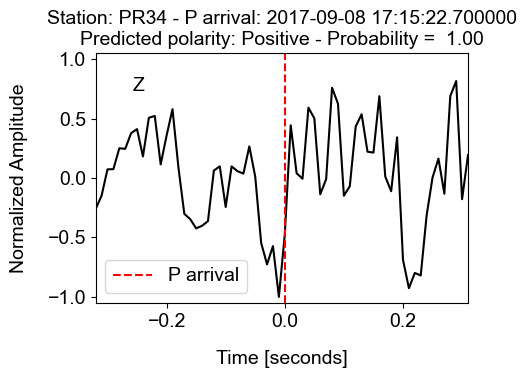


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [9363, 9364, 9365, 9366, 9367]
Continuity check result: True

____________ Event: 17 _____________

2) Running DynaPicker for phase picking
Time elapsed: 24.27 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 205ms/step
Time elapsed: 0.58 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:15:45.200000Z
S-arrival: 2017-09-08T17:15:46.200000Z
Magnitude: 0.20000000298023224
Polarity: Negative (Probability: 0.993)


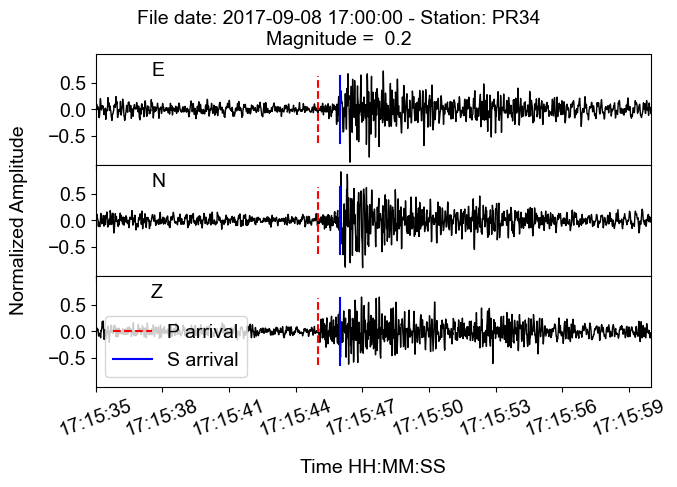

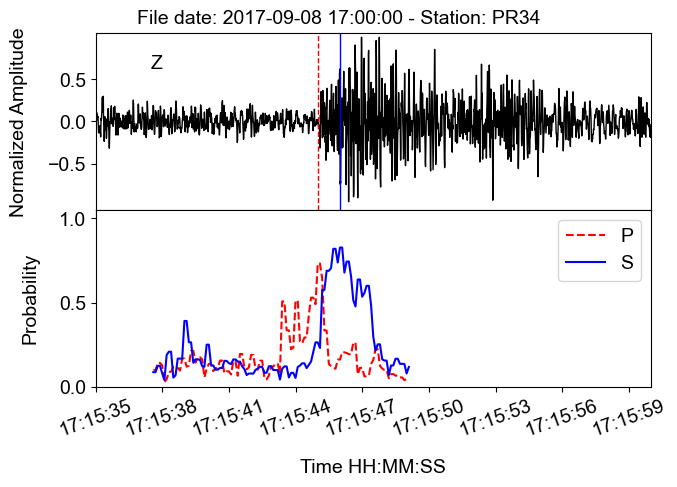

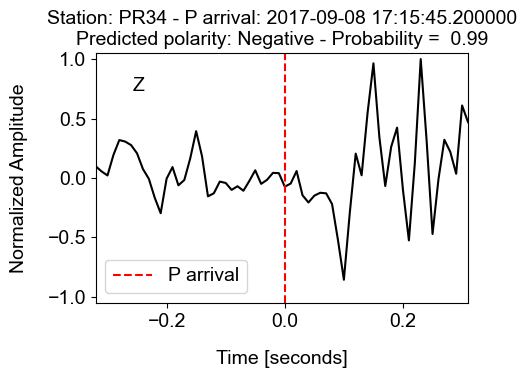


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [9683, 9684, 9685, 9686, 9687]
Continuity check result: True

____________ Event: 18 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.22 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 297ms/step
Time elapsed: 0.82 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:16:17.300000Z
S-arrival: 2017-09-08T17:16:18.000000Z
Magnitude: 2.0999999046325684
Polarity: Positive (Probability: 0.795)


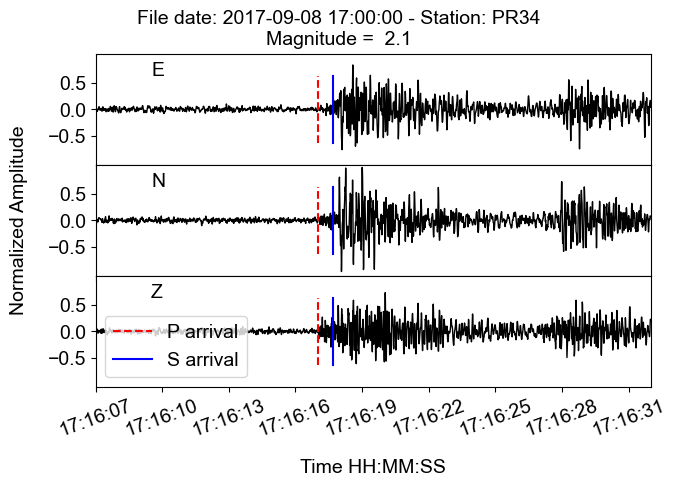

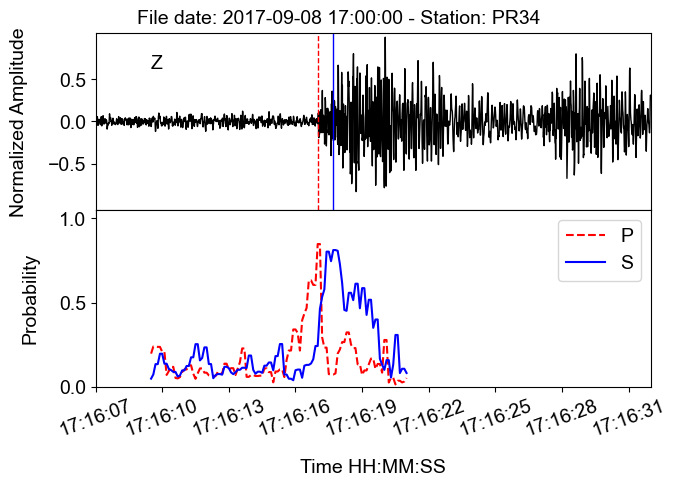

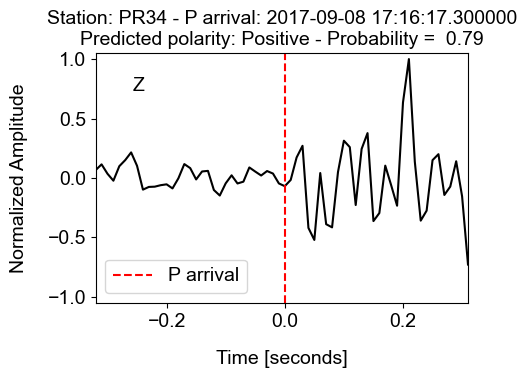


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [9833, 9834, 9835, 9836, 9837]
Continuity check result: True

____________ Event: 19 _____________

2) Running DynaPicker for phase picking
Time elapsed: 15.16 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 488ms/step
Time elapsed: 0.95 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:16:26.200000Z
S-arrival: 2017-09-08T17:16:28.200000Z
Magnitude: 1.899999976158142
Polarity: Positive (Probability: 0.878)


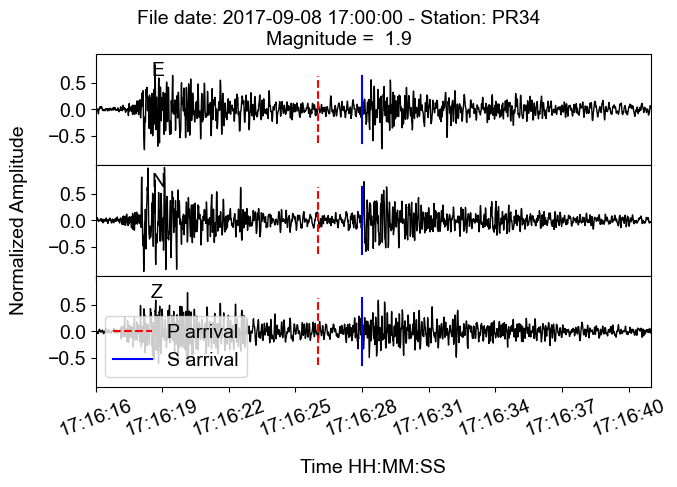

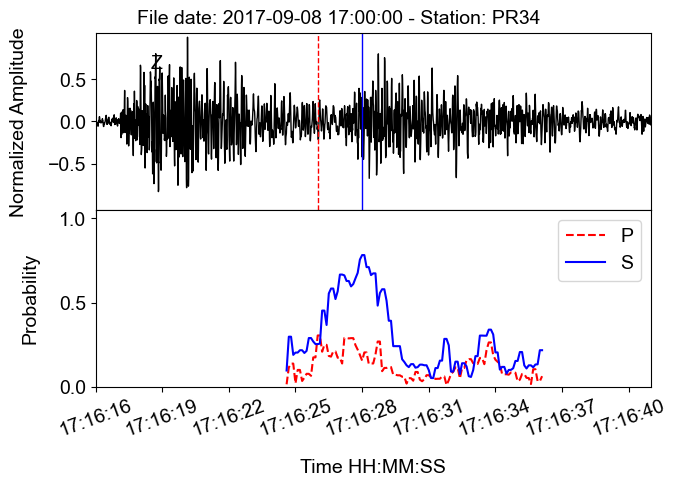

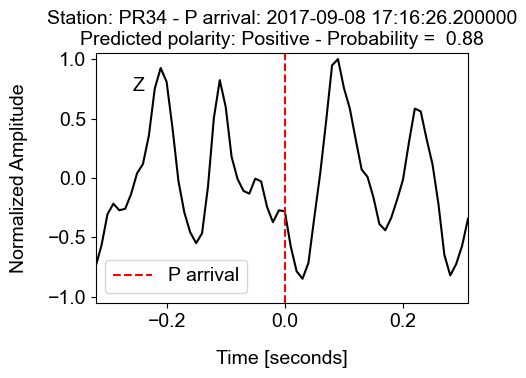


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [10240, 10241, 10242, 10243, 10244]
Continuity check result: True

____________ Event: 20 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.58 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 216ms/step
Time elapsed: 0.59 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:17:13.300000Z
S-arrival: 2017-09-08T17:17:14.200000Z
Magnitude: 0.5
Polarity: Positive (Probability: 0.992)


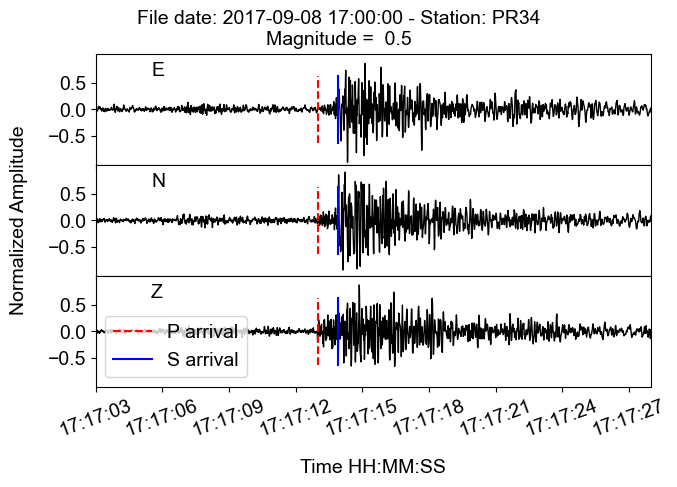

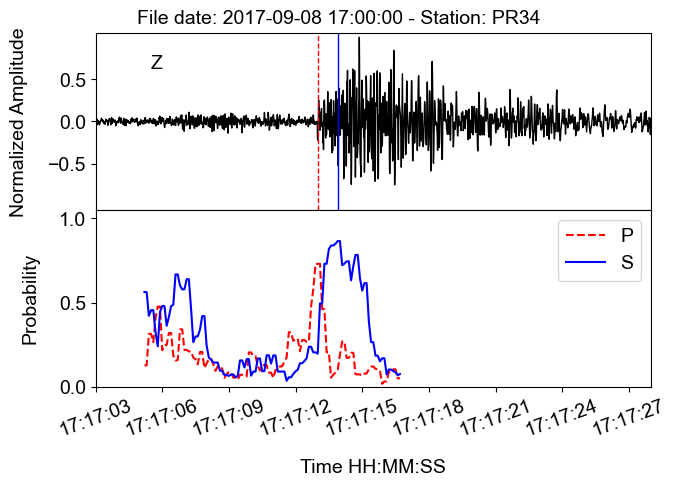

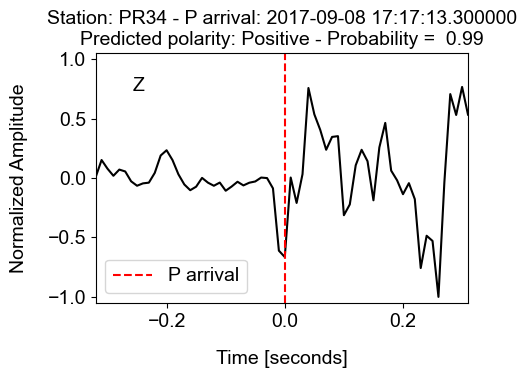


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [10572, 10573, 10574, 10575, 10576]
Continuity check result: True

____________ Event: 21 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.14 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 248ms/step
Time elapsed: 0.64 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:17:45.100000Z
S-arrival: 2017-09-08T17:17:46.400000Z
Magnitude: 1.100000023841858
Polarity: Negative (Probability: 1.000)


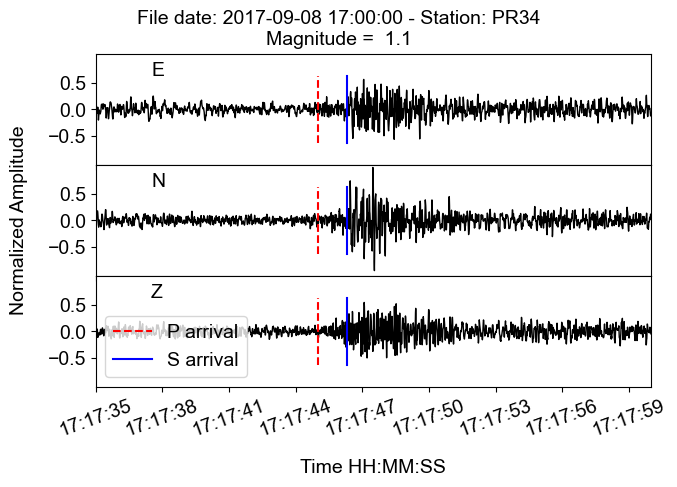

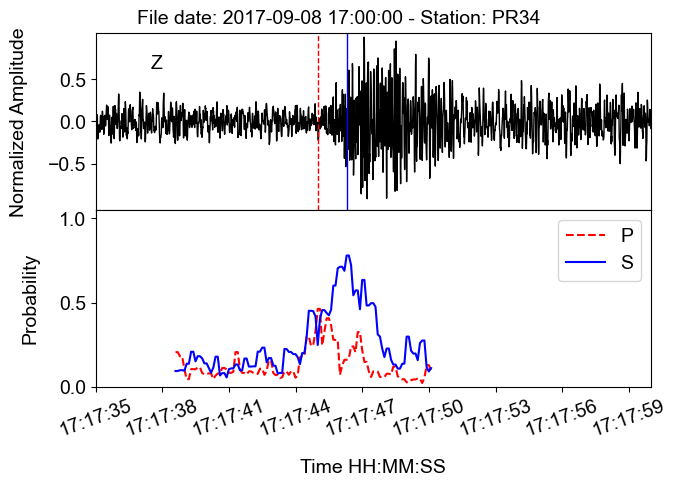

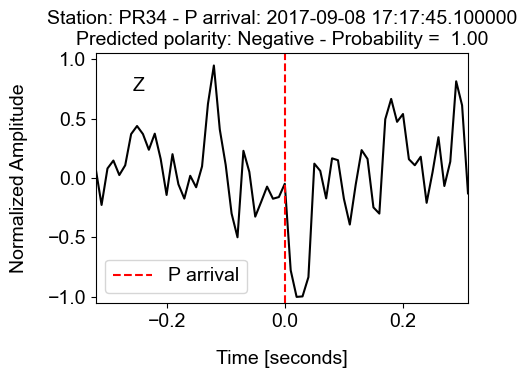


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [10774, 10778, 10779, 10780, 10781]
Continuity check result: False
No events detected till 2017-09-08T17:17:56.800000Z

___________________________________________

Detected event window indices: [10778, 10779, 10780, 10781, 10782]
Continuity check result: True

____________ Event: 22 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.67 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 215ms/step
Time elapsed: 0.58 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:18:05.500000Z
S-arrival: 2017-09-08T17:18:06.300000Z
Magnitude: 0.30000001192092896
Polarity: Negative (Probability: 0.623)


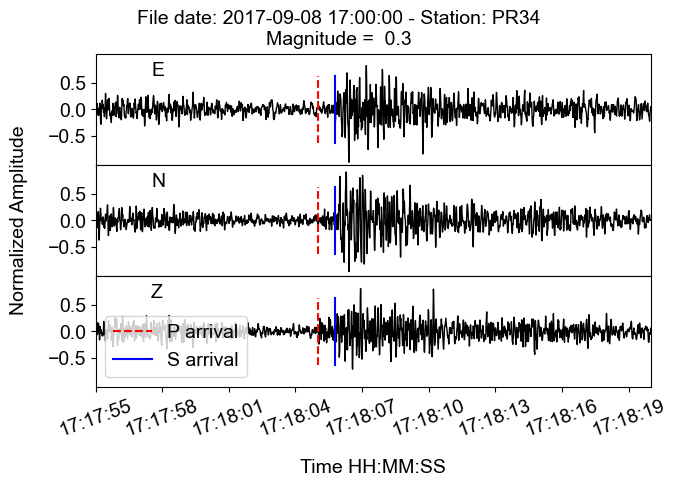

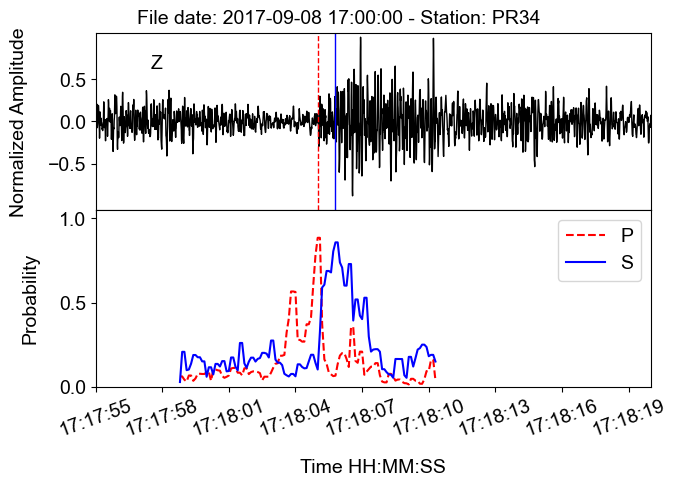

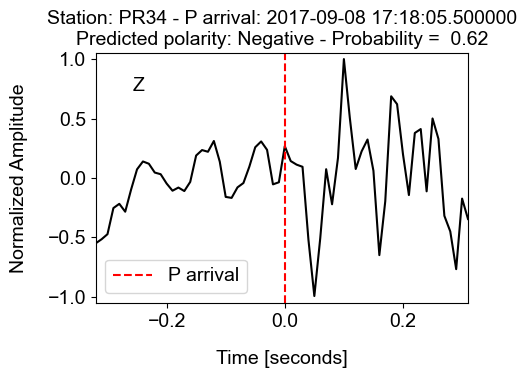


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [10975, 10979, 10980, 10981, 10982]
Continuity check result: False
No events detected till 2017-09-08T17:18:16.900000Z

___________________________________________

Detected event window indices: [10979, 10980, 10981, 10982, 10983]
Continuity check result: True

____________ Event: 23 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.27 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 227ms/step
Time elapsed: 0.61 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:18:20.700000Z
S-arrival: 2017-09-08T17:18:25.100000Z
Magnitude: 1.0
Polarity: Negative (Probability: 0.994)


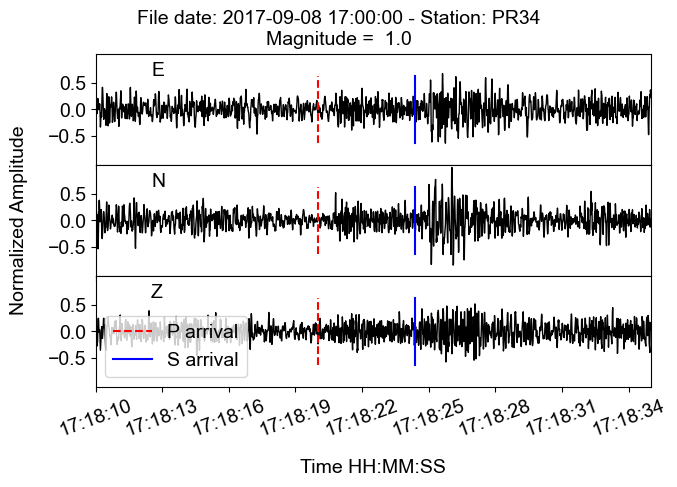

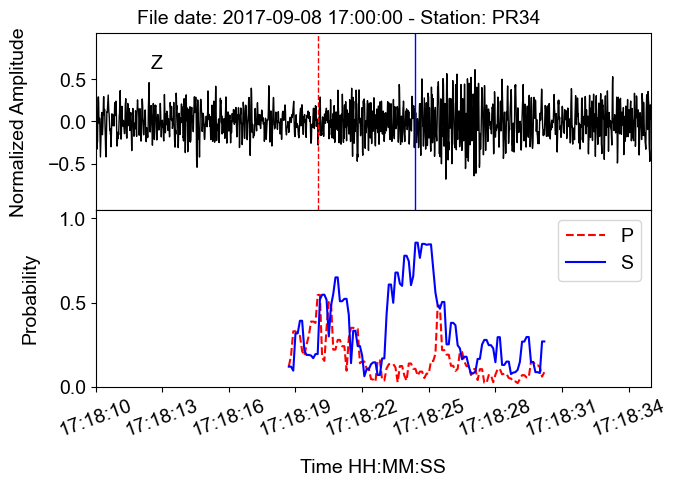

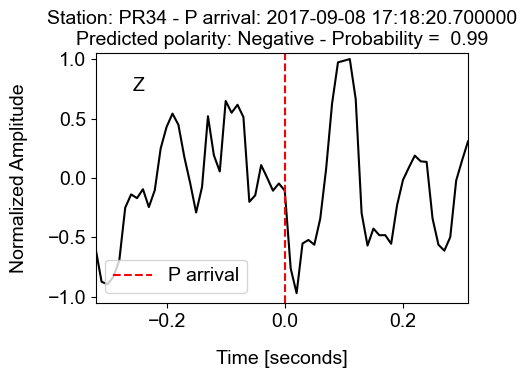


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [11410, 11411, 11412, 11413, 11414]
Continuity check result: True

____________ Event: 24 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.04 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 251ms/step
Time elapsed: 1.05 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:19:09.600000Z
S-arrival: 2017-09-08T17:19:11.100000Z
Magnitude: 1.100000023841858
Polarity: Positive (Probability: 1.000)


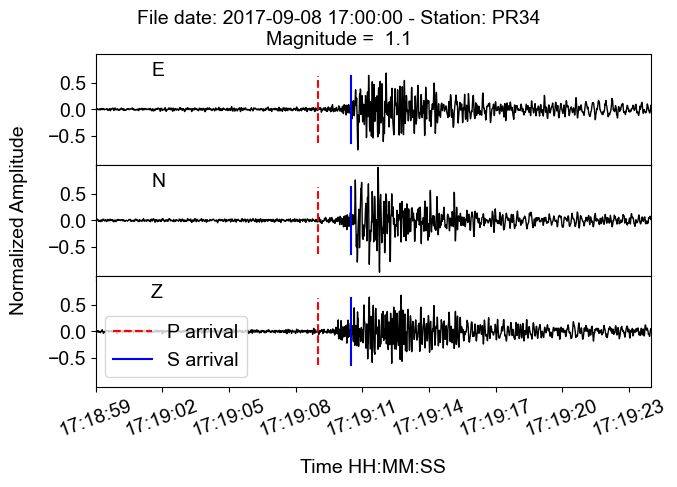

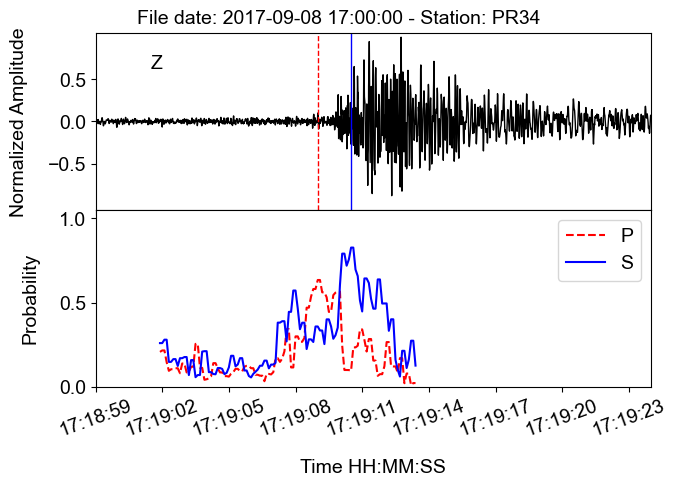

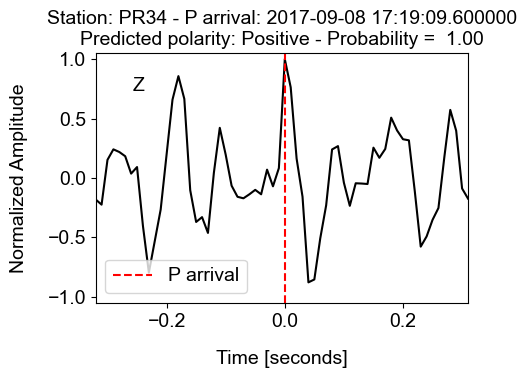


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [11922, 11923, 11924, 11925, 11926]
Continuity check result: True

____________ Event: 25 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.89 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 233ms/step
Time elapsed: 0.66 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:20:00.900000Z
S-arrival: 2017-09-08T17:20:01.900000Z
Magnitude: 2.0999999046325684
Polarity: Negative (Probability: 0.710)


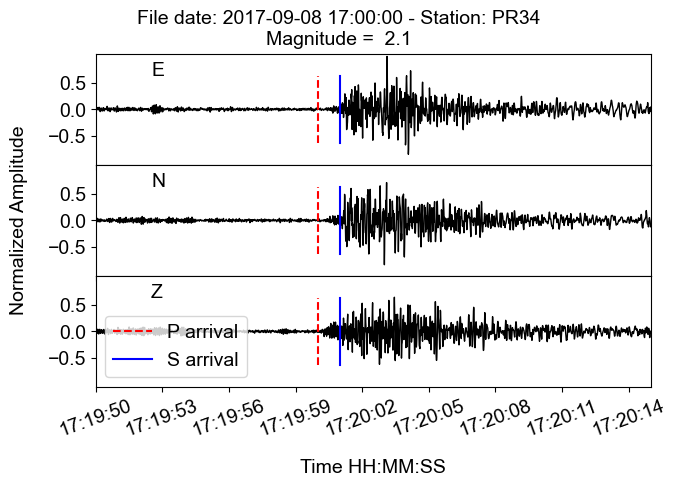

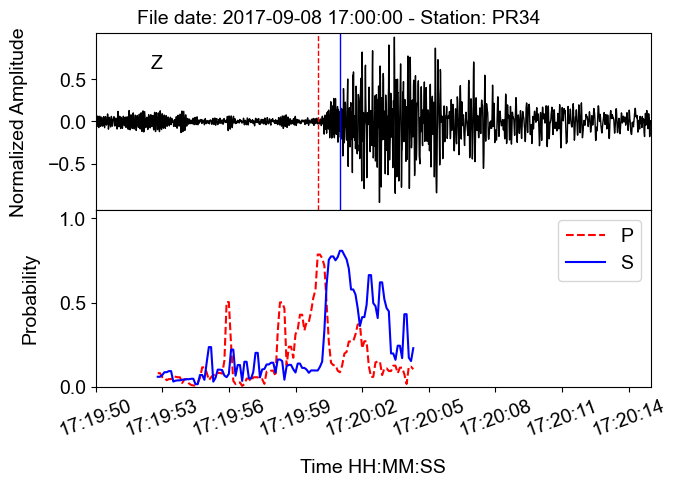

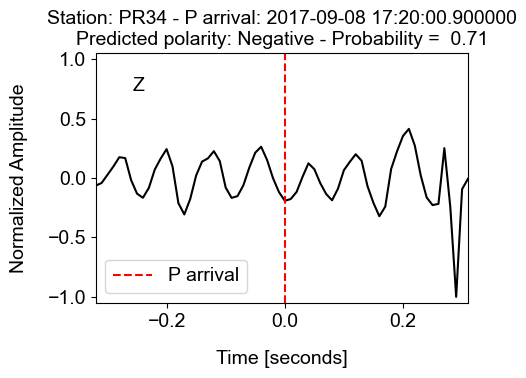


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [12402, 12430, 12432, 12627, 12628]
Continuity check result: False
No events detected till 2017-09-08T17:20:42.000000Z

___________________________________________

Detected event window indices: [12430, 12432, 12627, 12628, 12629]
Continuity check result: False
No events detected till 2017-09-08T17:20:42.200000Z

___________________________________________

Detected event window indices: [12432, 12627, 12628, 12629, 12630]
Continuity check result: False
No events detected till 2017-09-08T17:21:01.700000Z

___________________________________________

Detected event window indices: [12627, 12628, 12629, 12630, 12867]
Continuity check result: False
No events detected till 2017-09-08T17:21:25.700000Z

_________________

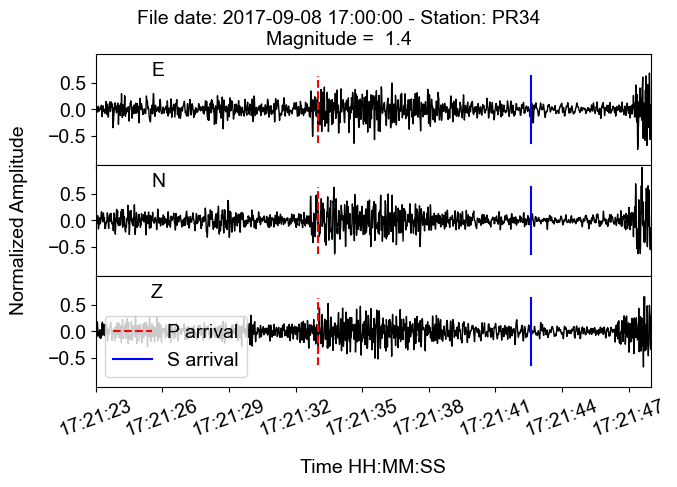

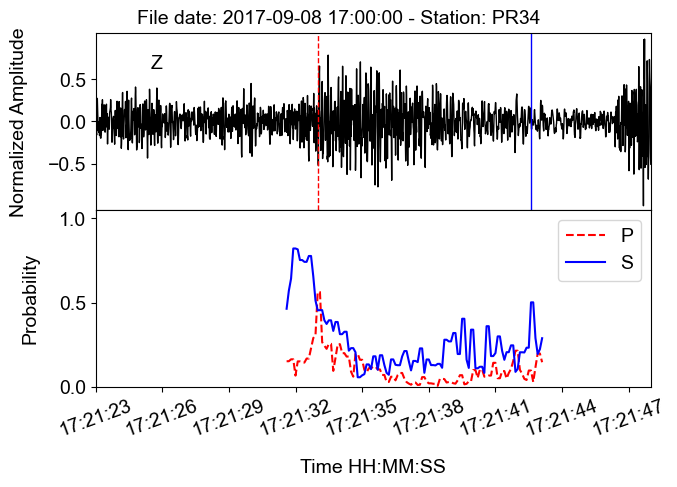

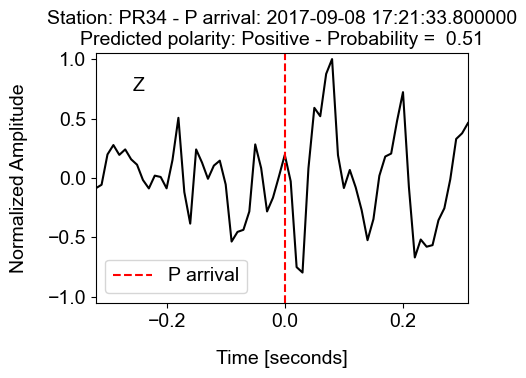


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [13059, 13060, 13061, 13062, 13063]
Continuity check result: True

____________ Event: 27 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.89 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 277ms/step
Time elapsed: 0.89 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:21:54.000000Z
S-arrival: 2017-09-08T17:21:57.100000Z
Magnitude: 2.0
Polarity: Negative (Probability: 0.999)


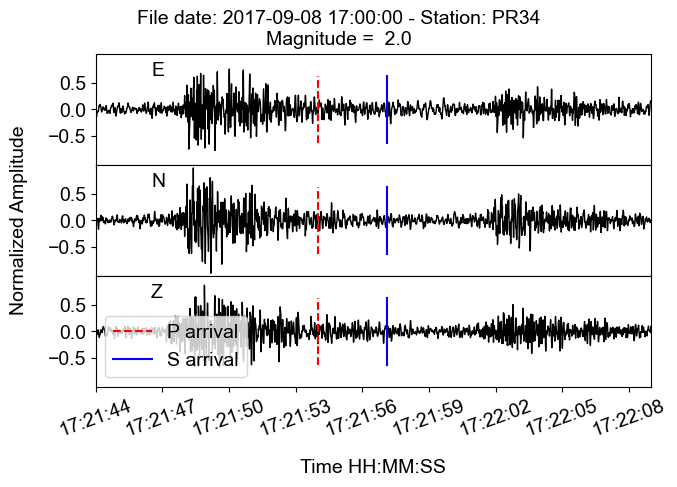

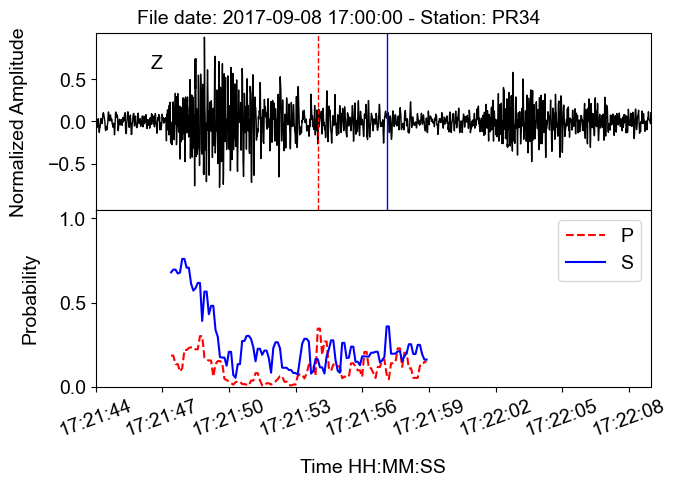

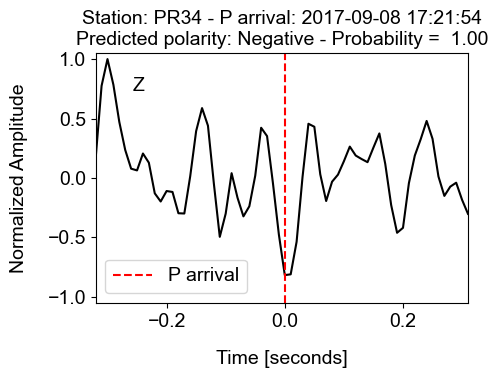


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [13282, 13283, 13284, 13285, 13286]
Continuity check result: True

____________ Event: 28 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.66 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 233ms/step
Time elapsed: 0.65 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:22:13.900000Z
S-arrival: 2017-09-08T17:22:16.000000Z
Magnitude: 0.20000000298023224
Polarity: Positive (Probability: 0.997)


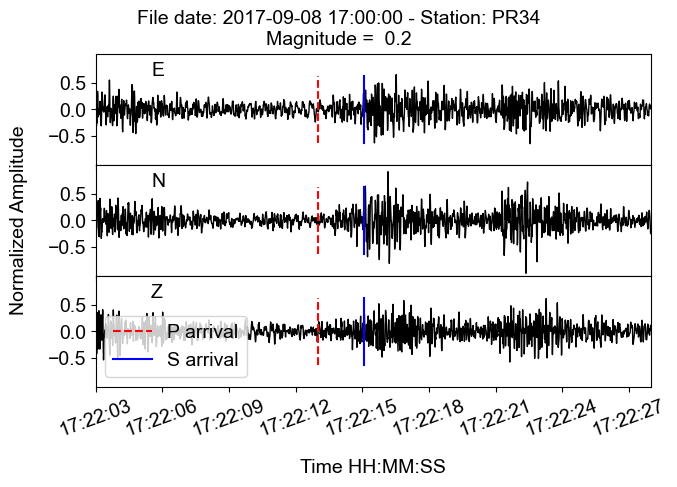

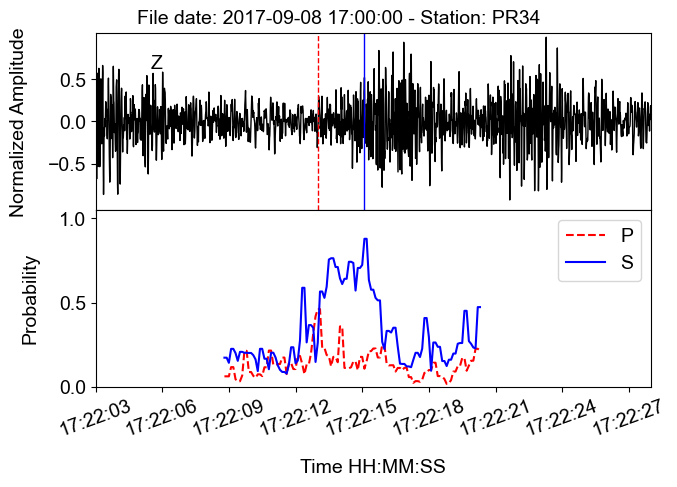

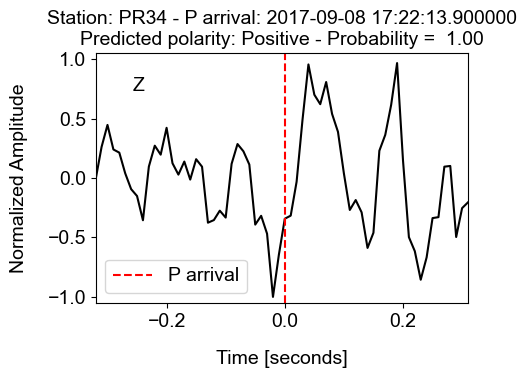


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [13474, 13475, 13476, 13477, 13478]
Continuity check result: True

____________ Event: 29 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.80 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 236ms/step
Time elapsed: 0.66 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:22:36.500000Z
S-arrival: 2017-09-08T17:22:37.400000Z
Magnitude: 2.0999999046325684
Polarity: Negative (Probability: 0.937)


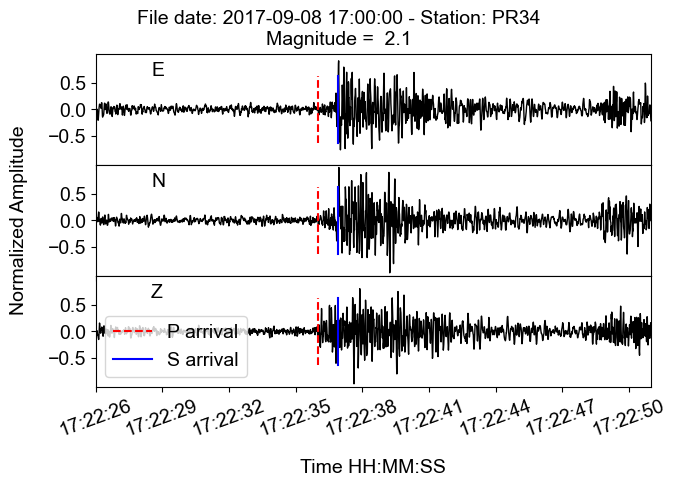

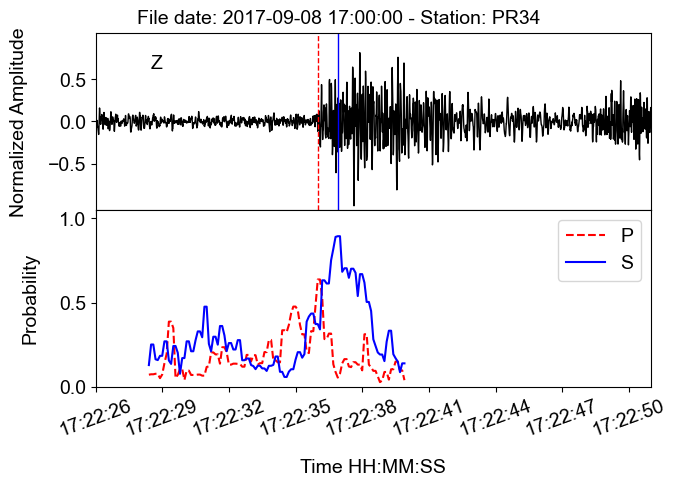

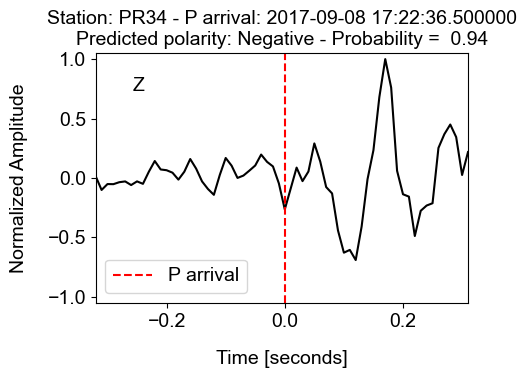


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [13639, 13641, 13661, 13663, 13665]
Continuity check result: False
No events detected till 2017-09-08T17:22:43.100000Z

___________________________________________

Detected event window indices: [13641, 13661, 13663, 13665, 13667]
Continuity check result: False
No events detected till 2017-09-08T17:22:45.100000Z

___________________________________________

Detected event window indices: [13661, 13663, 13665, 13667, 13668]
Continuity check result: False
No events detected till 2017-09-08T17:22:45.300000Z

___________________________________________

Detected event window indices: [13663, 13665, 13667, 13668, 13669]
Continuity check result: False
No events detected till 2017-09-08T17:22:45.500000Z

_________________

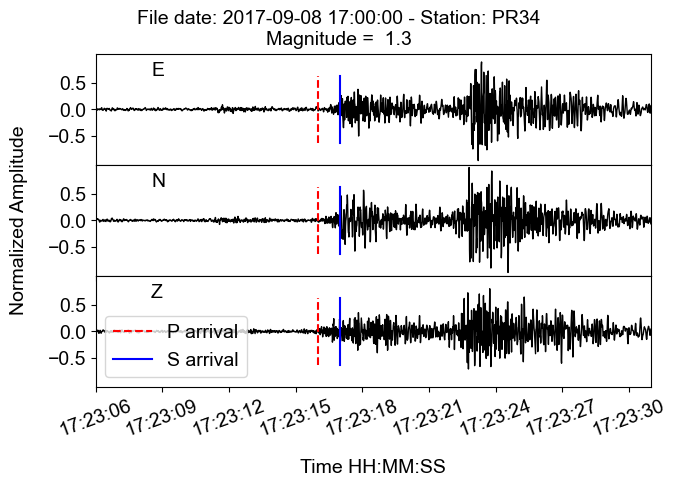

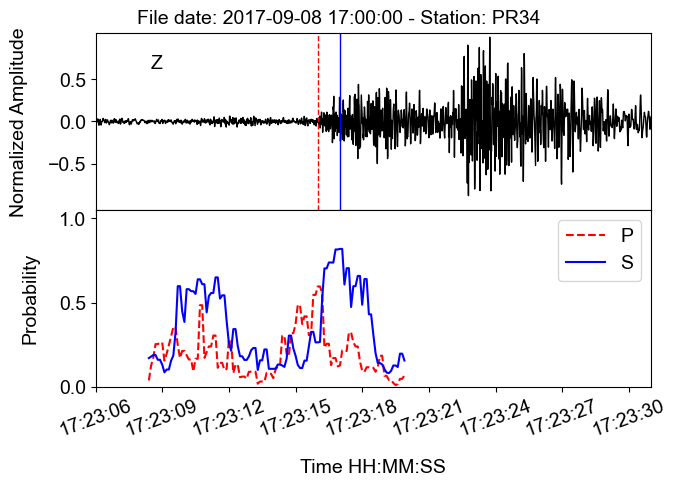

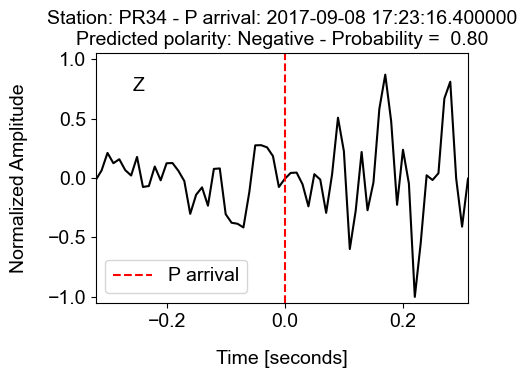


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [14313, 14314, 14315, 14316, 14317]
Continuity check result: True

____________ Event: 31 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.22 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 249ms/step
Time elapsed: 0.63 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:24:00.200000Z
S-arrival: 2017-09-08T17:24:01.000000Z
Magnitude: 1.899999976158142
Polarity: Positive (Probability: 0.969)


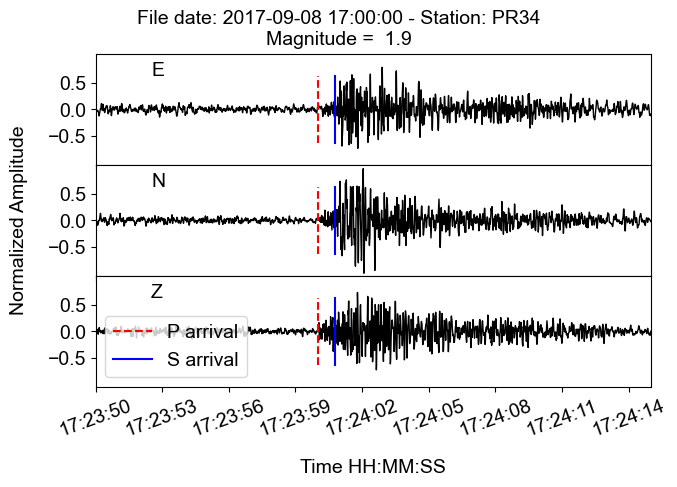

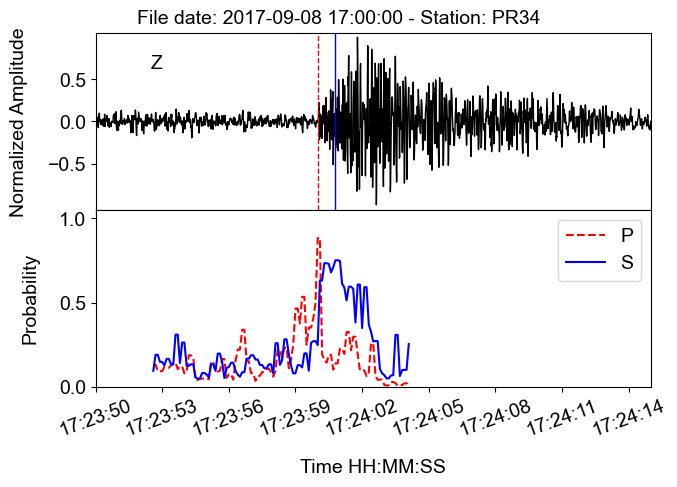

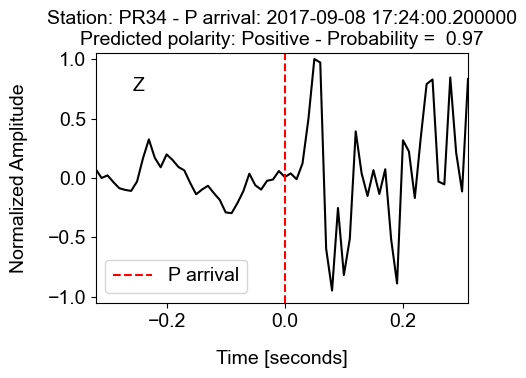


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [14595, 14596, 14597, 14598, 14599]
Continuity check result: True

____________ Event: 32 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.58 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 210ms/step
Time elapsed: 0.57 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:24:27.900000Z
S-arrival: 2017-09-08T17:24:28.600000Z
Magnitude: 1.0
Polarity: Negative (Probability: 0.590)


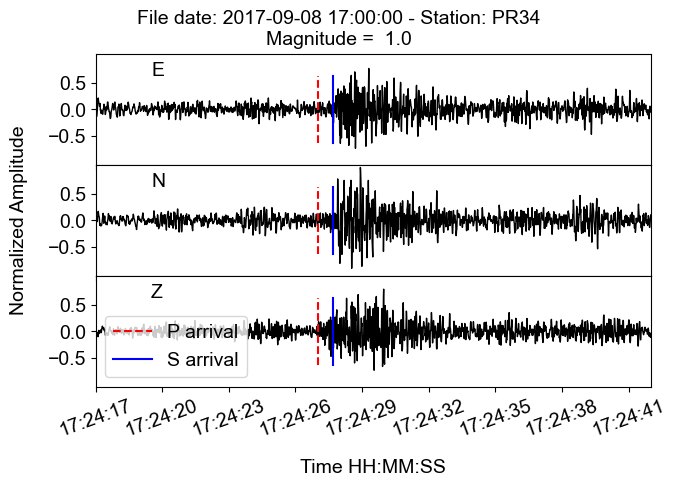

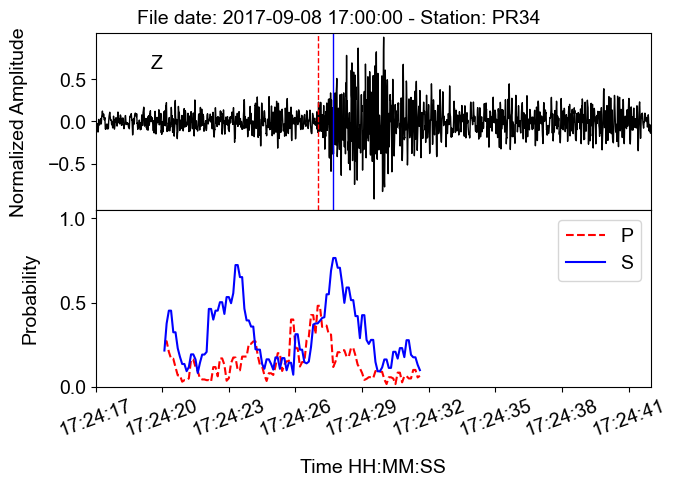

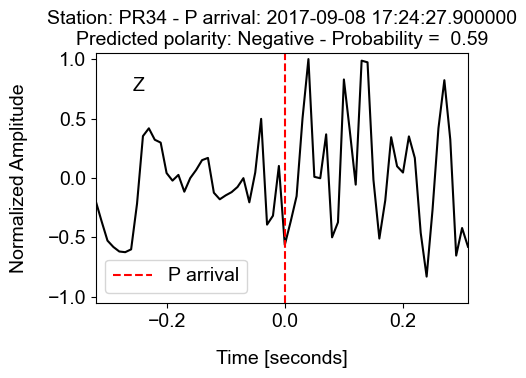


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [14860, 14861, 14862, 14863, 14864]
Continuity check result: True

____________ Event: 33 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.00 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 220ms/step
Time elapsed: 0.60 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:24:54.400000Z
S-arrival: 2017-09-08T17:24:55.500000Z
Magnitude: 0.8999999761581421
Polarity: Negative (Probability: 0.978)


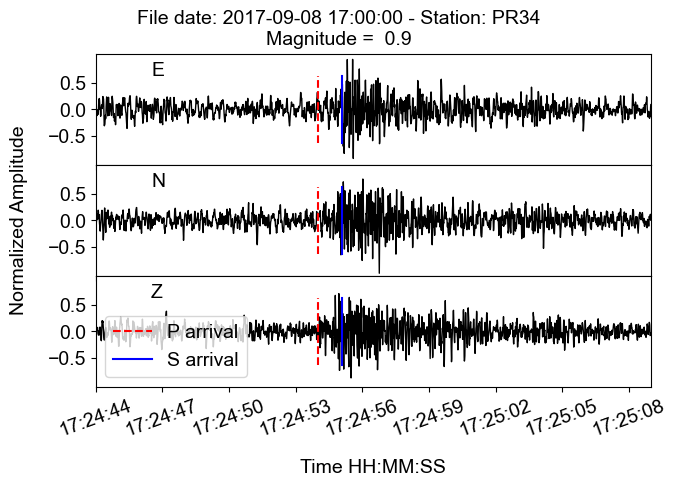

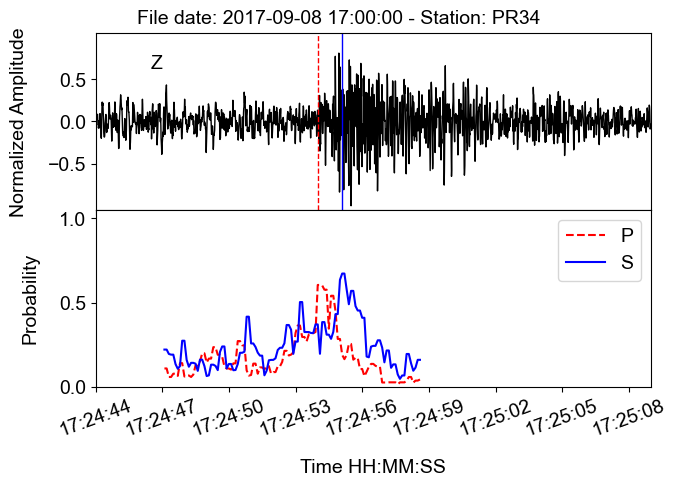

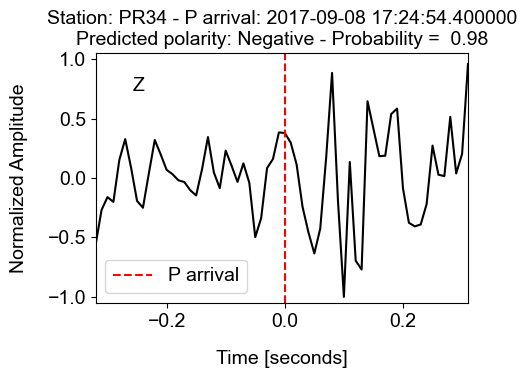


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [15189, 15190, 15191, 15192, 15193]
Continuity check result: True

____________ Event: 34 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.77 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 212ms/step
Time elapsed: 0.69 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:25:25.800000Z
S-arrival: 2017-09-08T17:25:27.700000Z
Magnitude: 0.4000000059604645
Polarity: Positive (Probability: 0.845)


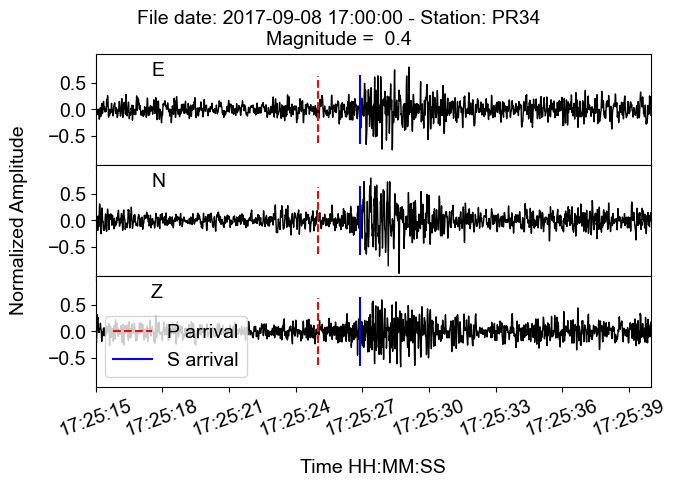

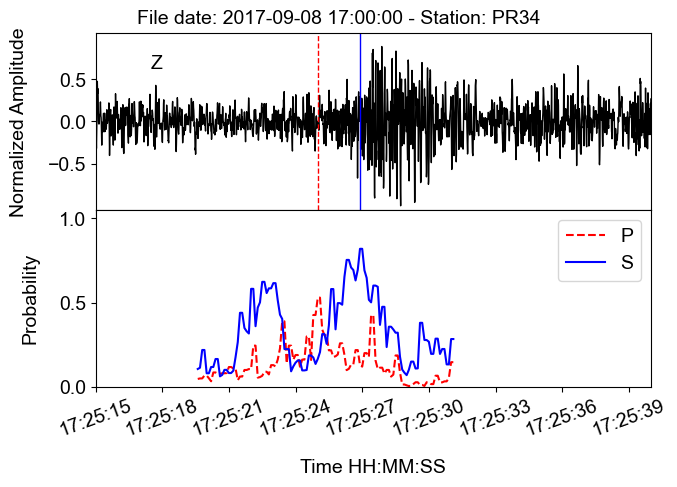

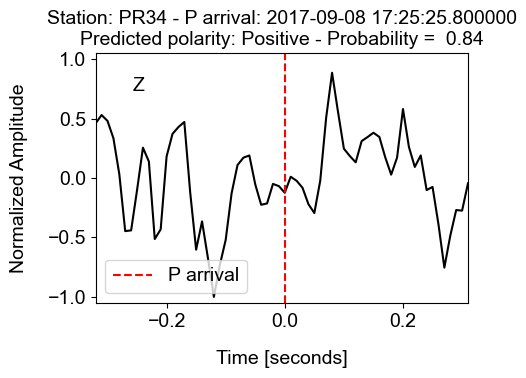


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [15819, 15822, 15823, 15824, 15825]
Continuity check result: False
No events detected till 2017-09-08T17:26:21.200000Z

___________________________________________

Detected event window indices: [15822, 15823, 15824, 15825, 15834]
Continuity check result: False
No events detected till 2017-09-08T17:26:22.400000Z

___________________________________________

Detected event window indices: [15834, 15835, 15836, 15837, 15838]
Continuity check result: True

____________ Event: 35 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.84 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 238ms/step
Time elapsed: 0.65 seconds

4) Results
Result:
P-arrival: 2017

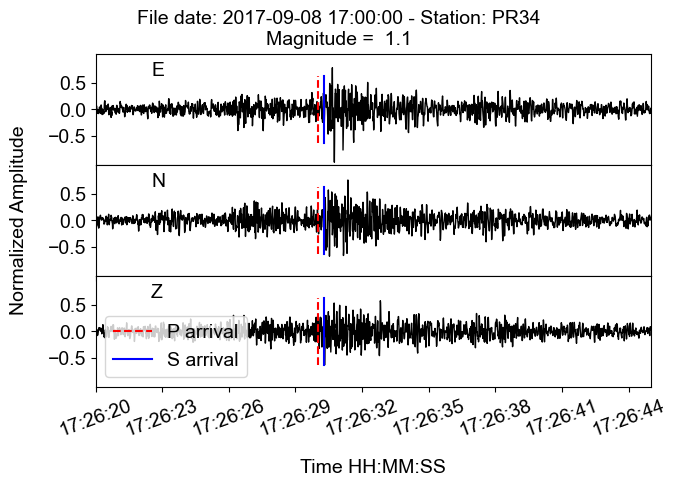

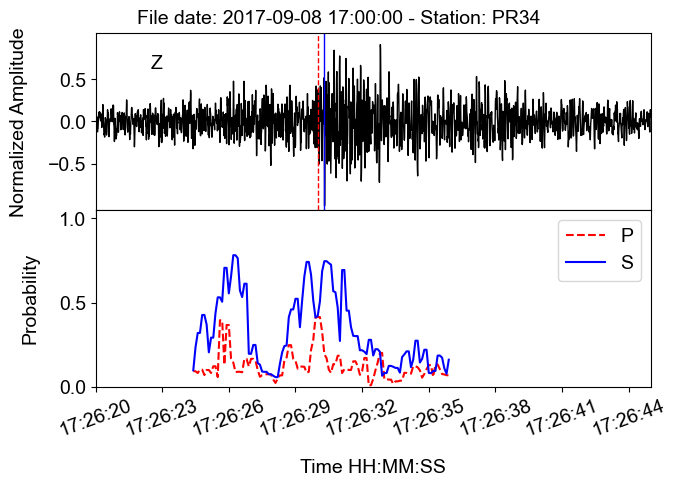

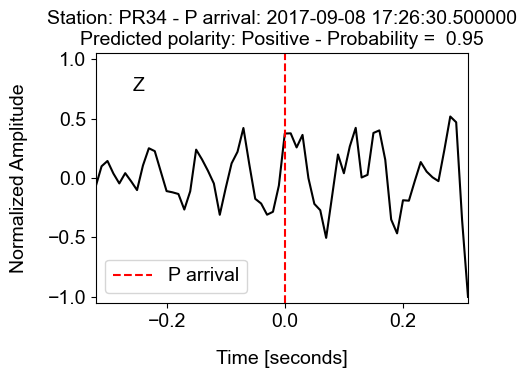


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [16073, 16080, 16081, 16082, 16083]
Continuity check result: False
No events detected till 2017-09-08T17:26:47.000000Z

___________________________________________

Detected event window indices: [16080, 16081, 16082, 16083, 16084]
Continuity check result: True

____________ Event: 36 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.86 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 217ms/step
Time elapsed: 0.62 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:26:59.000000Z
S-arrival: 2017-09-08T17:26:59.700000Z
Magnitude: 1.899999976158142
Polarity: Negative (Probability: 1.000)


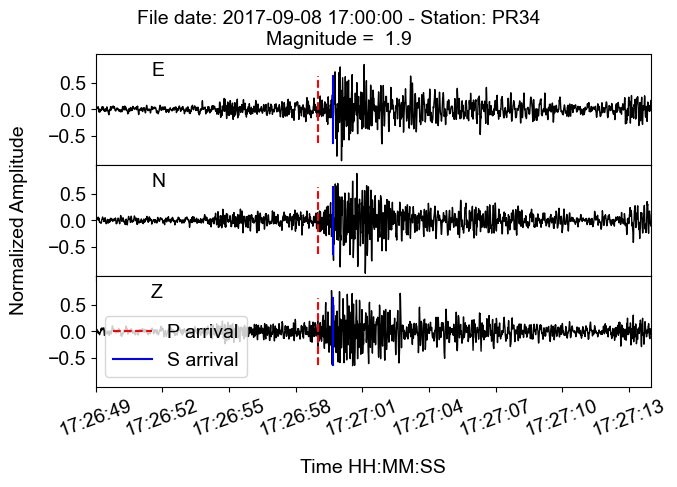

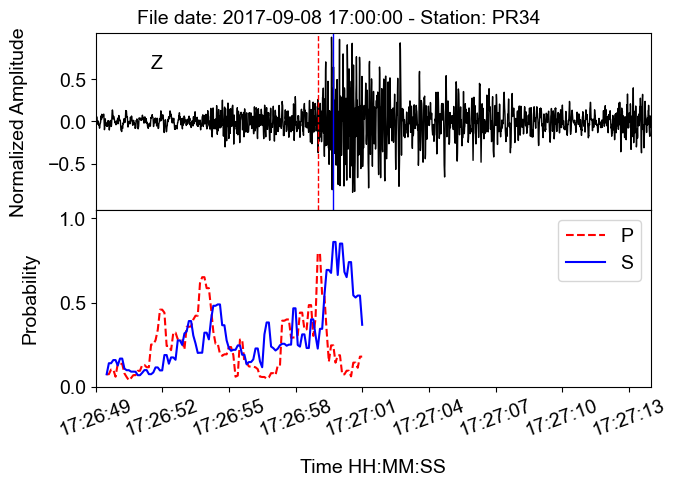

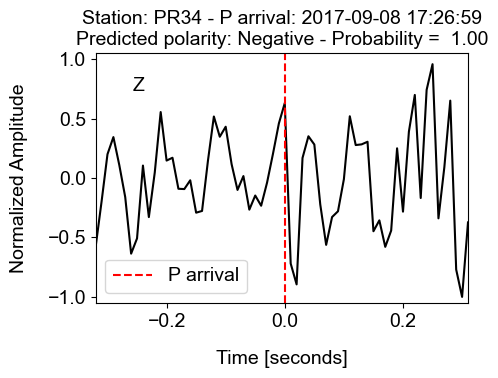


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [16373, 16375, 16376, 16377, 16378]
Continuity check result: False
No events detected till 2017-09-08T17:27:16.500000Z

___________________________________________

Detected event window indices: [16375, 16376, 16377, 16378, 16379]
Continuity check result: True

____________ Event: 37 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.59 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 219ms/step
Time elapsed: 0.61 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:27:25.400000Z
S-arrival: 2017-09-08T17:27:26.500000Z
Magnitude: 0.699999988079071
Polarity: Negative (Probability: 0.889)


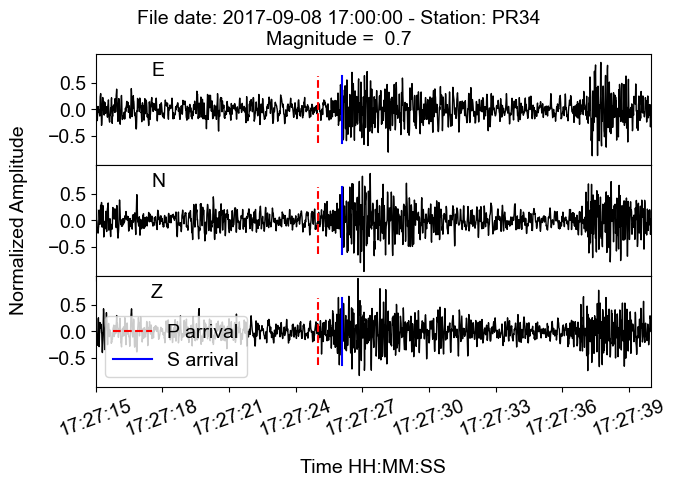

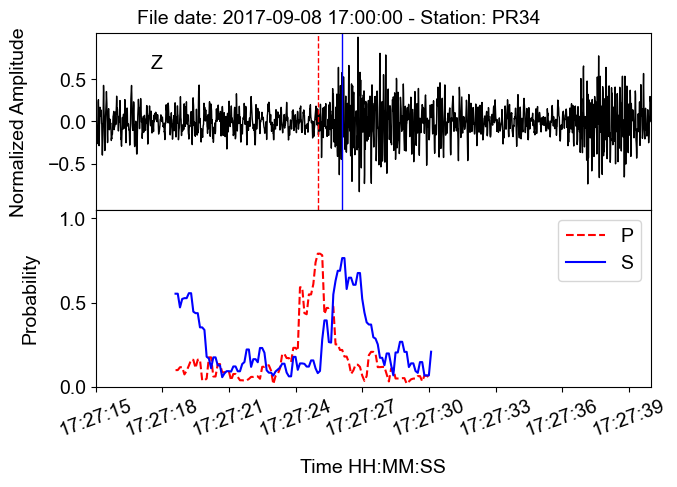

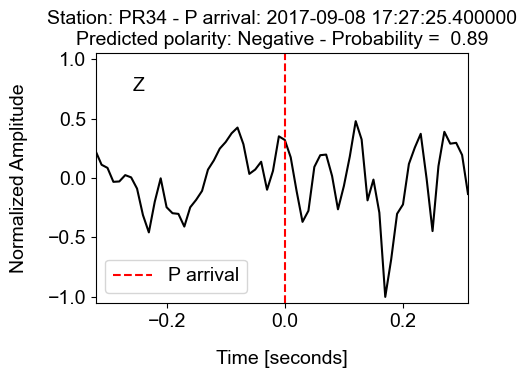


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [16525, 16526, 16527, 16528, 16532]
Continuity check result: False
No events detected till 2017-09-08T17:27:32.200000Z

___________________________________________

Detected event window indices: [16532, 16533, 16534, 16539, 16540]
Continuity check result: False
No events detected till 2017-09-08T17:27:32.900000Z

___________________________________________

Detected event window indices: [16539, 16540, 16541, 16542, 16543]
Continuity check result: True

____________ Event: 38 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.54 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 217ms/step
Time elapsed: 0.59 seconds

4) Results
Result:
P-arrival: 2017

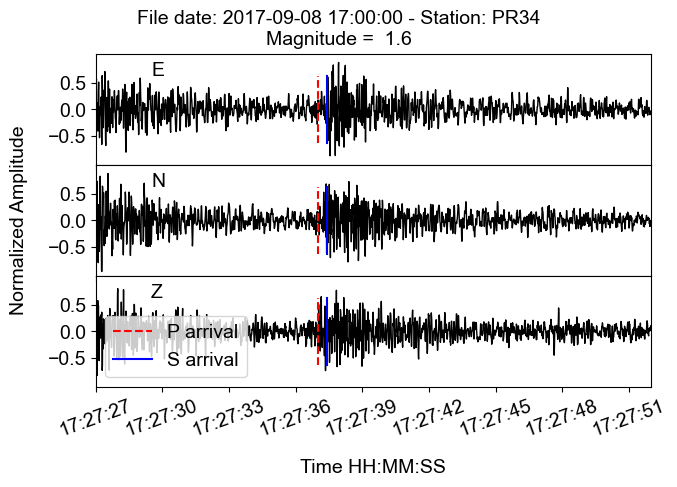

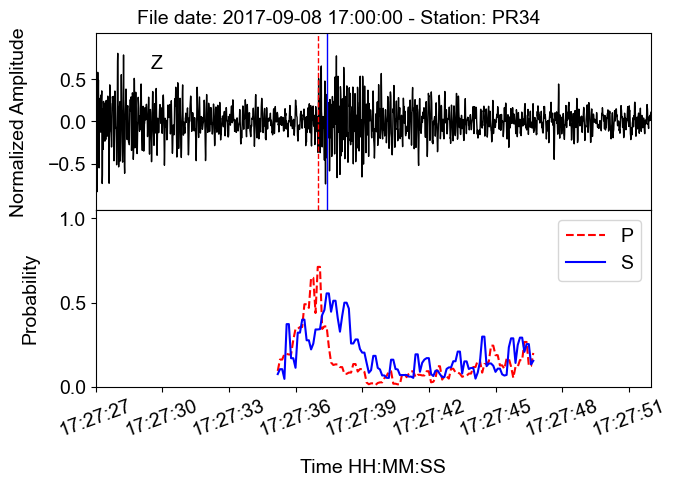

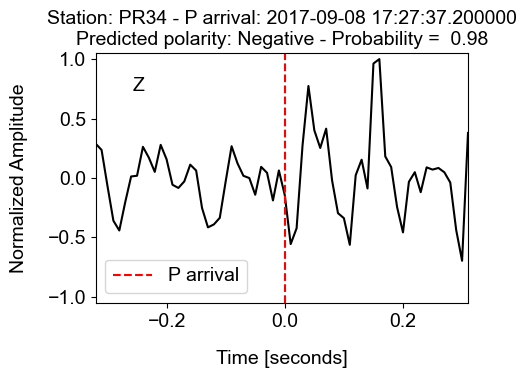


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [16689, 16690, 16691, 16692, 16693]
Continuity check result: True

____________ Event: 39 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.39 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 226ms/step
Time elapsed: 0.59 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:27:54.700000Z
S-arrival: 2017-09-08T17:27:55.500000Z
Magnitude: 1.7000000476837158
Polarity: Positive (Probability: 0.985)


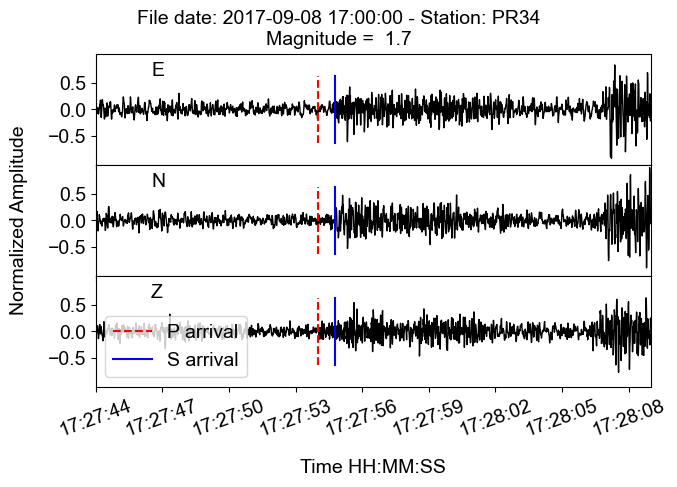

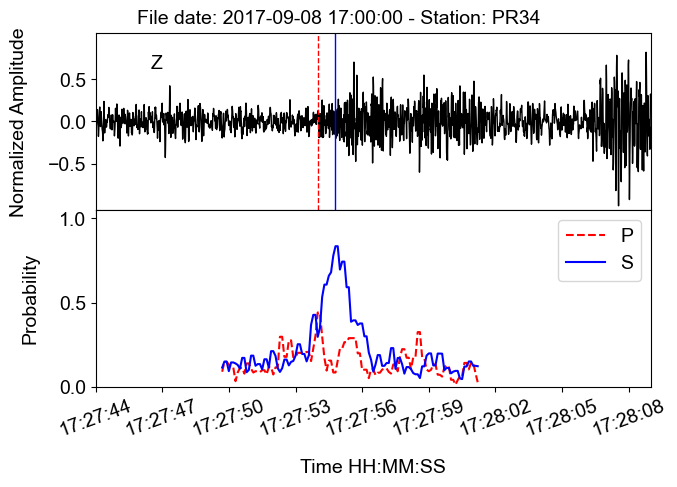

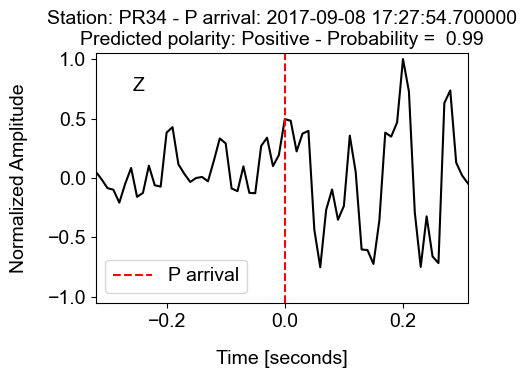


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [16839, 16840, 16841, 16842, 16843]
Continuity check result: True

____________ Event: 40 _____________

2) Running DynaPicker for phase picking
Time elapsed: 17.47 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 215ms/step
Time elapsed: 0.60 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:28:07.000000Z
S-arrival: 2017-09-08T17:28:07.800000Z
Magnitude: 2.4000000953674316
Polarity: Positive (Probability: 0.971)


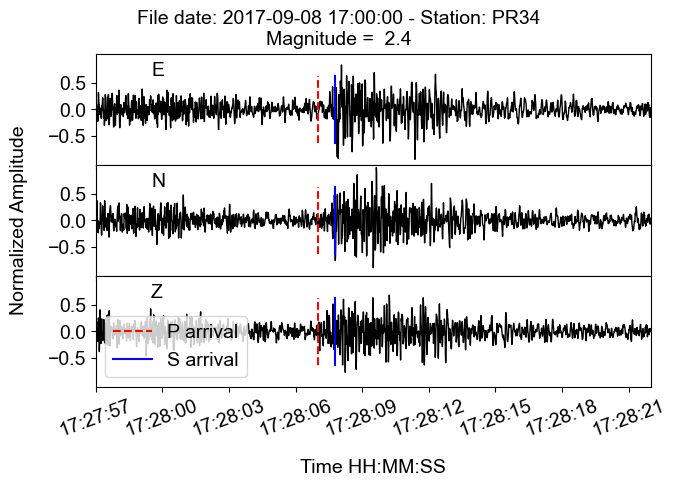

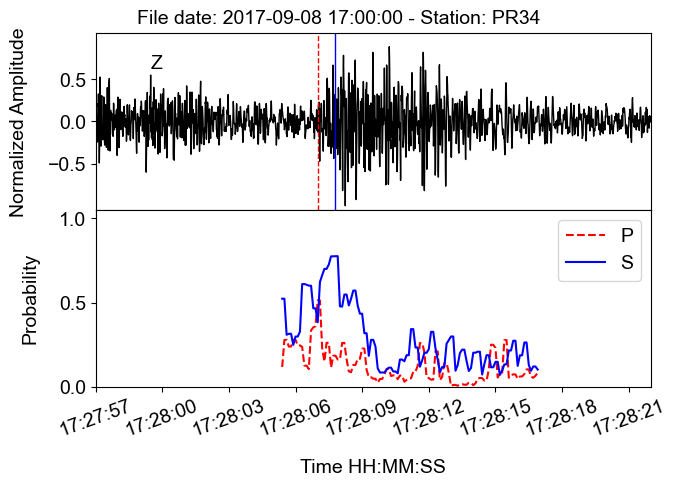

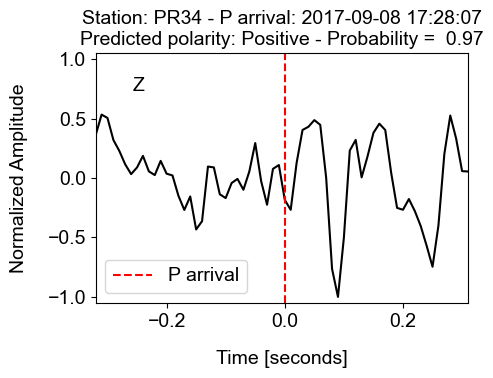


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [17134, 17135, 17136, 17138, 17139]
Continuity check result: False
No events detected till 2017-09-08T17:28:32.800000Z

___________________________________________

Detected event window indices: [17138, 17139, 17140, 17141, 17142]
Continuity check result: True

____________ Event: 41 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.56 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 215ms/step
Time elapsed: 0.59 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:28:36.400000Z
S-arrival: 2017-09-08T17:28:36.400000Z
Magnitude: 0.10000000149011612
Polarity: Positive (Probability: 0.997)


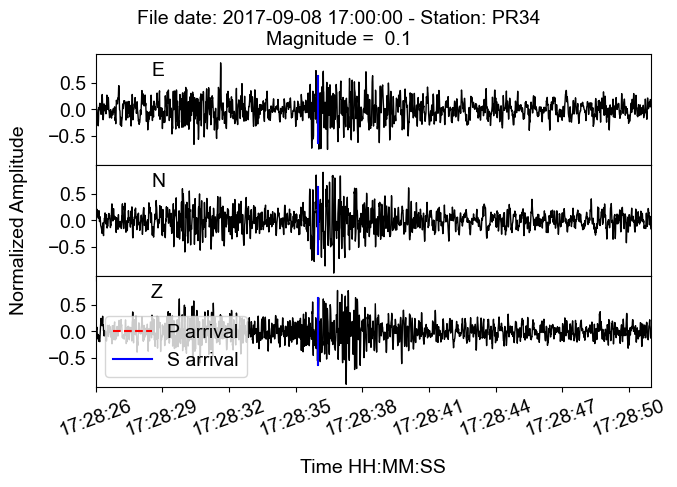

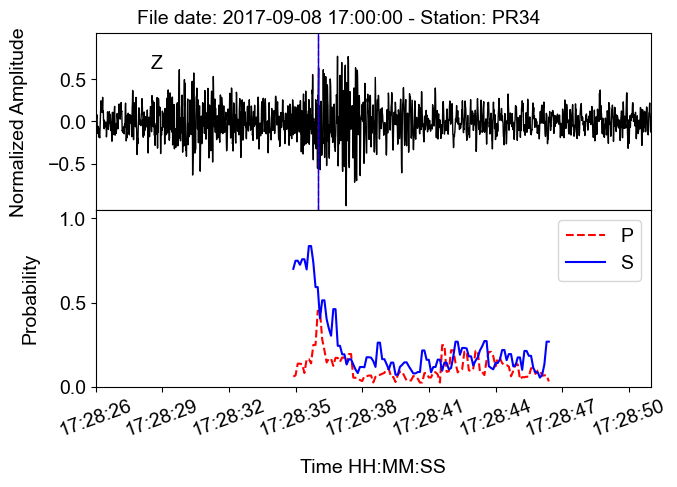

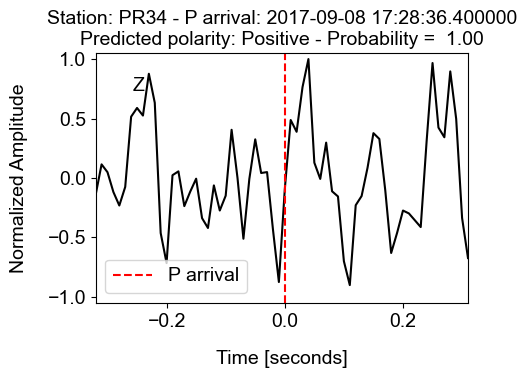


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [17493, 17495, 17498, 17499, 17500]
Continuity check result: False
No events detected till 2017-09-08T17:29:08.500000Z

___________________________________________

Detected event window indices: [17495, 17498, 17499, 17500, 17646]
Continuity check result: False
No events detected till 2017-09-08T17:29:08.800000Z

___________________________________________

Detected event window indices: [17498, 17499, 17500, 17646, 17648]
Continuity check result: False
No events detected till 2017-09-08T17:29:23.600000Z

___________________________________________

Detected event window indices: [17646, 17648, 17650, 17651, 17652]
Continuity check result: False
No events detected till 2017-09-08T17:29:23.800000Z

_________________

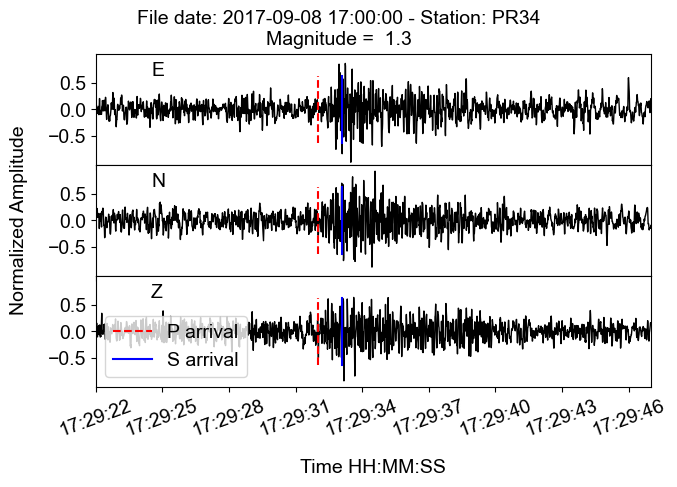

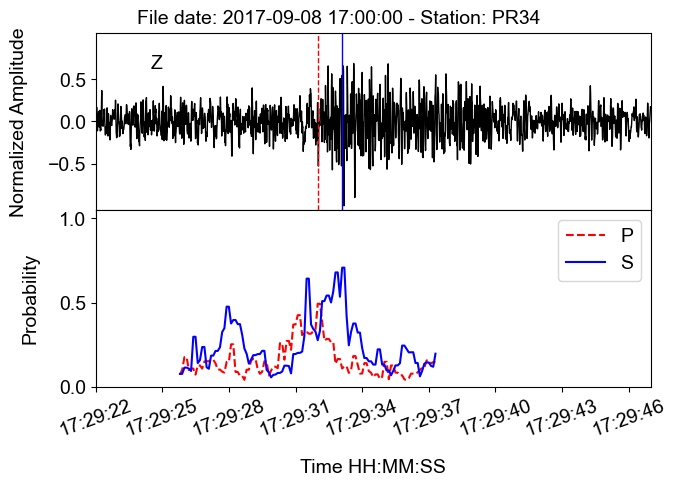

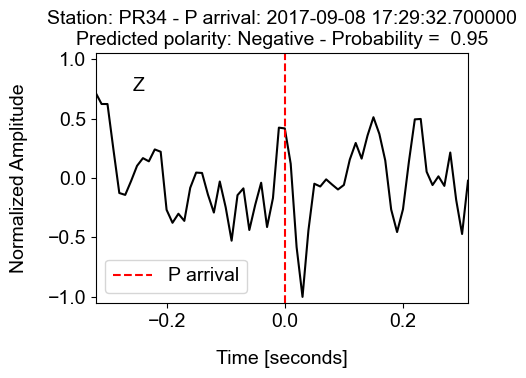


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [17826, 17870, 17871, 17872, 17873]
Continuity check result: False
No events detected till 2017-09-08T17:29:46.000000Z

___________________________________________

Detected event window indices: [17870, 17871, 17872, 17873, 17874]
Continuity check result: True

____________ Event: 43 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.92 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 339ms/step
Time elapsed: 0.88 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:29:59.700000Z
S-arrival: 2017-09-08T17:30:00.000000Z
Magnitude: 0.800000011920929
Polarity: Negative (Probability: 0.564)


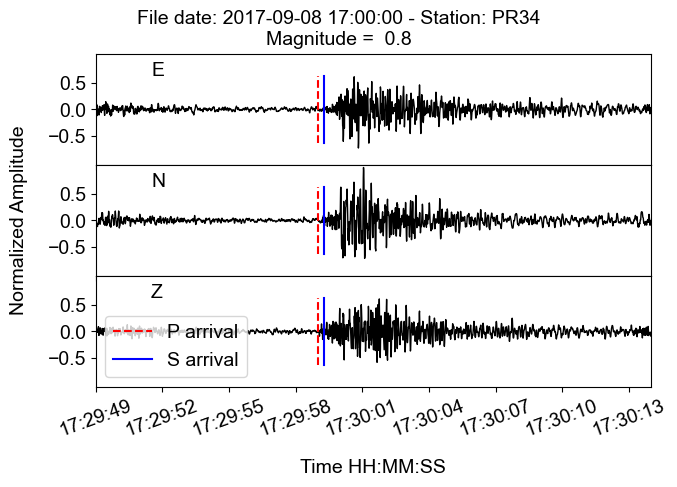

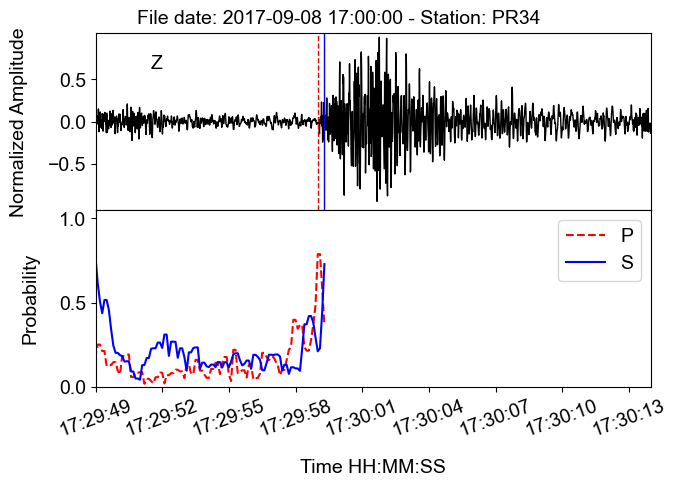

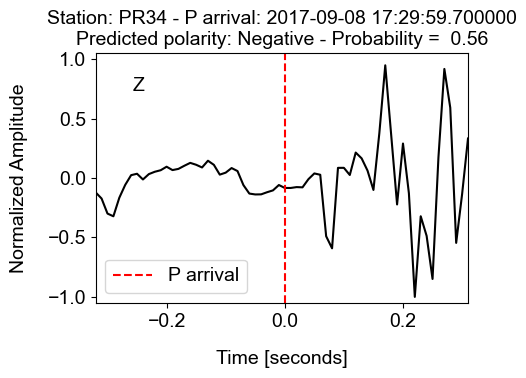


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [18318, 18319, 18320, 18321, 18322]
Continuity check result: True

____________ Event: 44 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.35 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 210ms/step
Time elapsed: 0.62 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:30:39.800000Z
S-arrival: 2017-09-08T17:30:40.800000Z
Magnitude: 0.800000011920929
Polarity: Positive (Probability: 0.686)


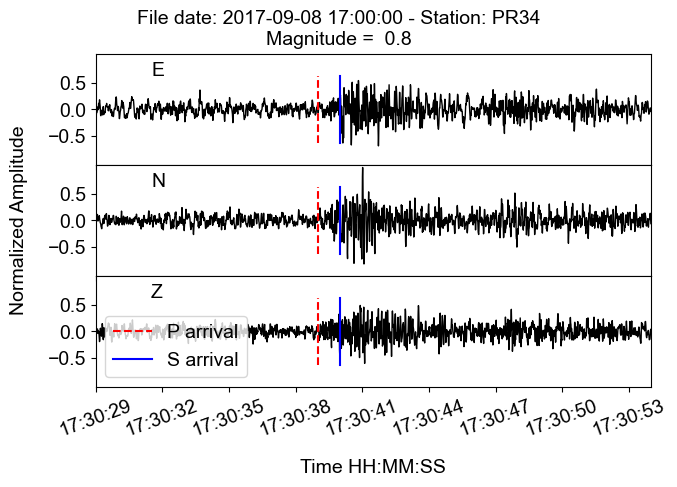

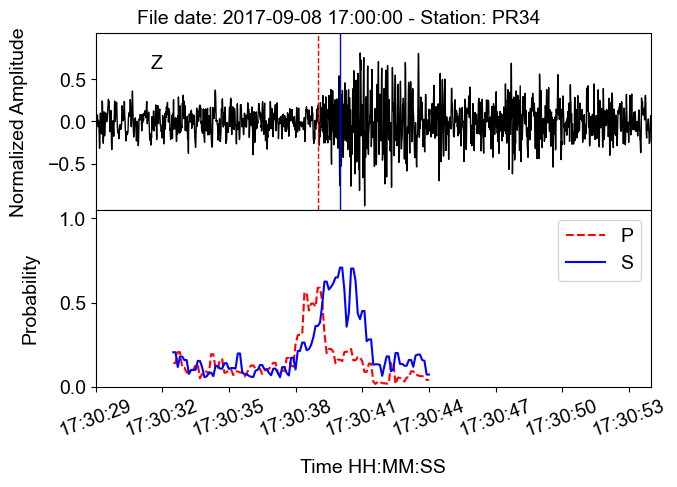

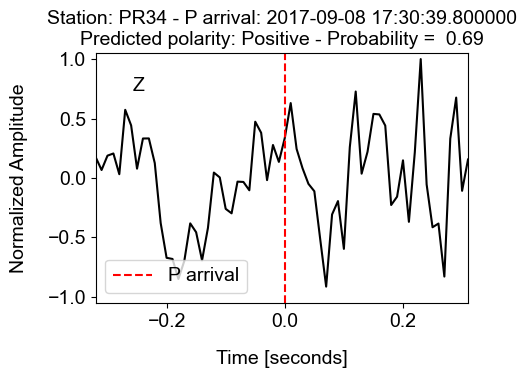


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [18485, 18486, 18487, 18488, 18489]
Continuity check result: True

____________ Event: 45 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.52 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 245ms/step
Time elapsed: 0.62 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:31:01.000000Z
S-arrival: 2017-09-08T17:31:01.500000Z
Magnitude: 0.4000000059604645
Polarity: Negative (Probability: 0.999)


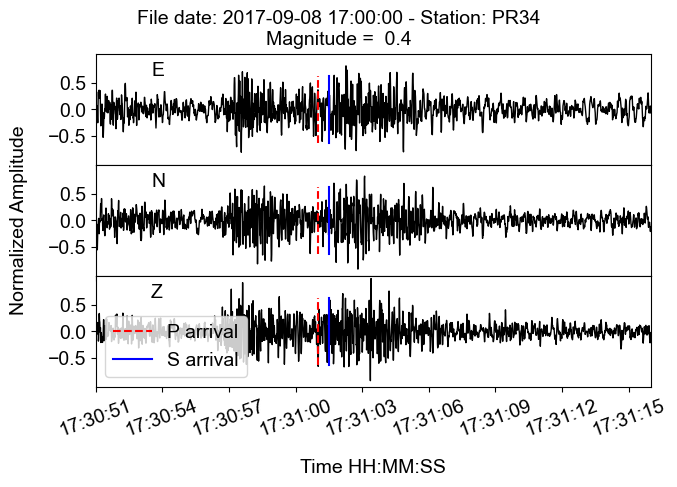

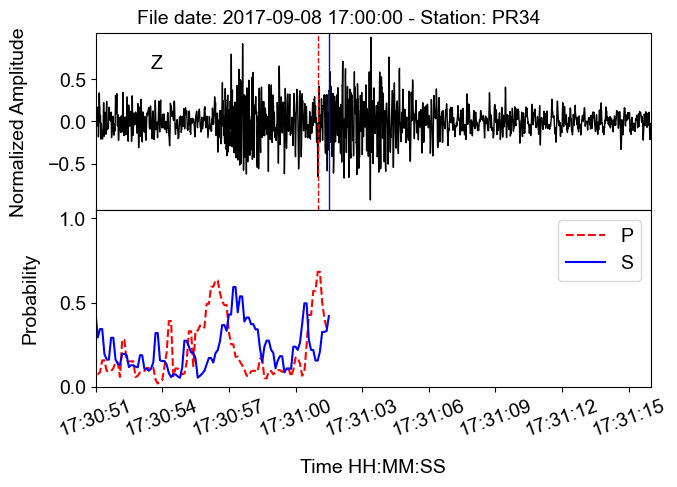

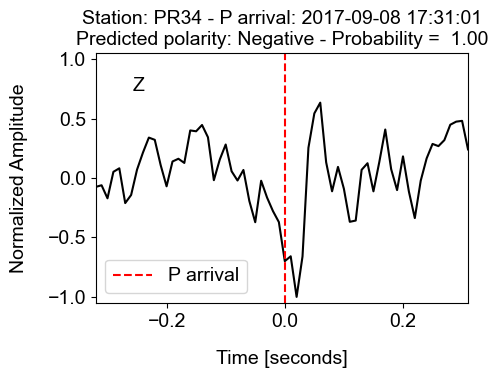


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [18728, 18729, 18731, 18732, 18785]
Continuity check result: False
No events detected till 2017-09-08T17:31:12.100000Z

___________________________________________

Detected event window indices: [18731, 18732, 18785, 18787, 18788]
Continuity check result: False
No events detected till 2017-09-08T17:31:17.500000Z

___________________________________________

Detected event window indices: [18785, 18787, 18788, 18789, 18790]
Continuity check result: False
No events detected till 2017-09-08T17:31:17.700000Z

___________________________________________

Detected event window indices: [18787, 18788, 18789, 18790, 18791]
Continuity check result: True

____________ Event: 46 _____________

2) Running DynaPicker for phase 

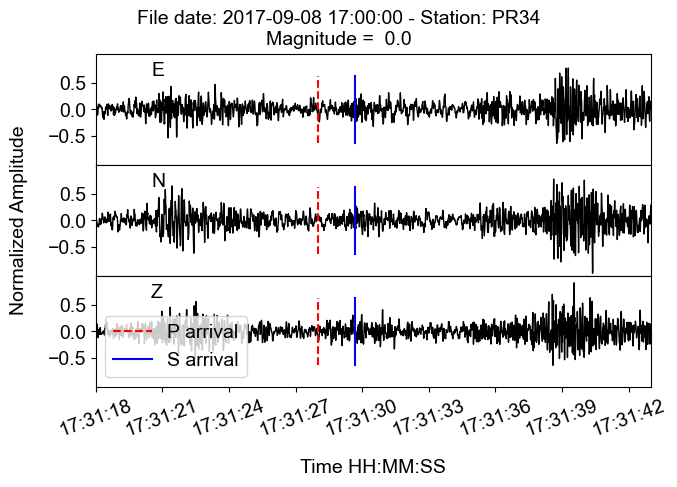

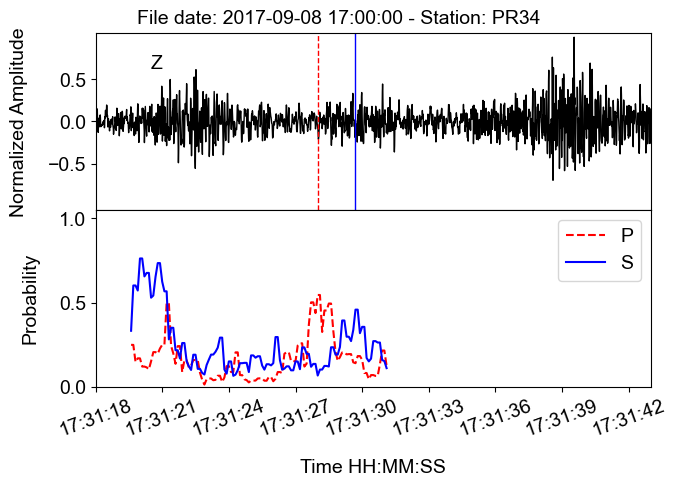

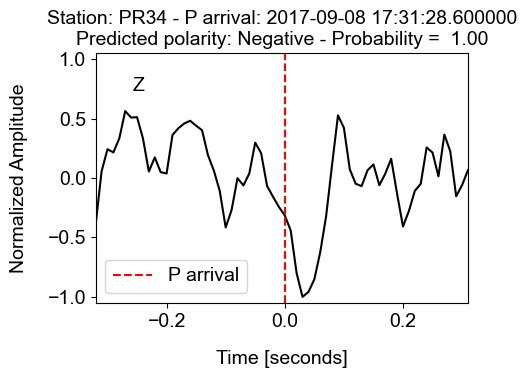


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [18937, 18938, 18939, 18940, 18941]
Continuity check result: True

____________ Event: 47 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.25 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 219ms/step
Time elapsed: 0.67 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:31:35.300000Z
S-arrival: 2017-09-08T17:31:39.200000Z
Magnitude: 0.699999988079071
Polarity: Negative (Probability: 0.984)


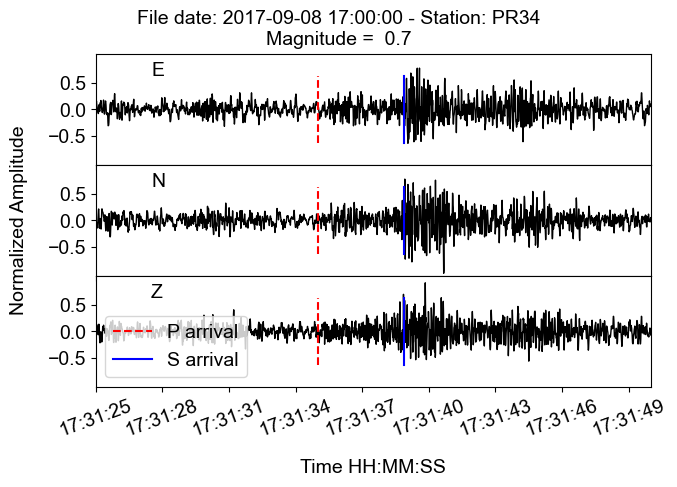

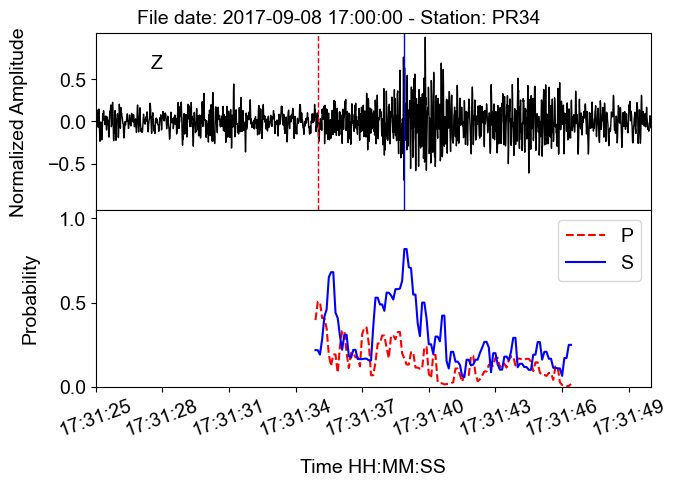

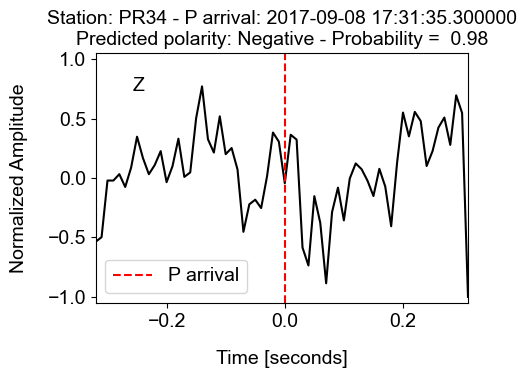


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [19099, 19130, 19131, 19132, 19133]
Continuity check result: False
No events detected till 2017-09-08T17:31:52.000000Z

___________________________________________

Detected event window indices: [19130, 19131, 19132, 19133, 19134]
Continuity check result: True

____________ Event: 48 _____________

2) Running DynaPicker for phase picking
Time elapsed: 15.97 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 354ms/step
Time elapsed: 0.88 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:32:05.700000Z
S-arrival: 2017-09-08T17:32:05.800000Z
Magnitude: 0.699999988079071
Polarity: Positive (Probability: 0.998)


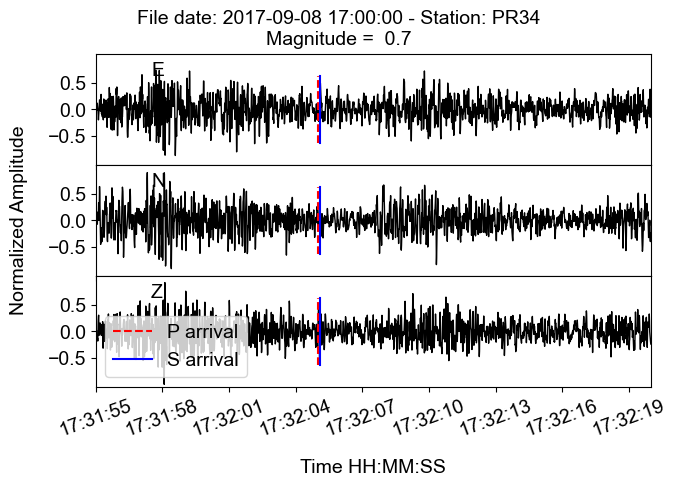

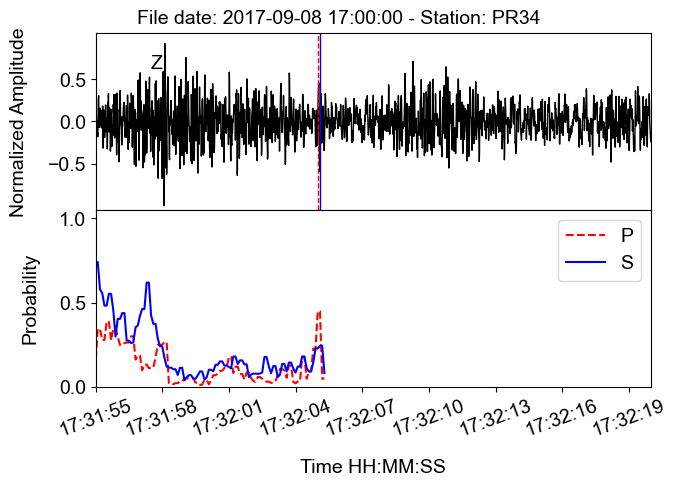

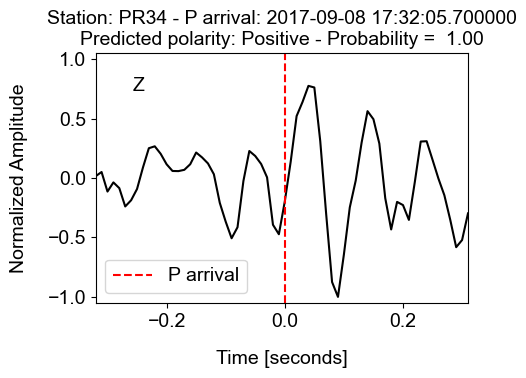


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [19442, 19443, 19444, 19445, 19446]
Continuity check result: True

____________ Event: 49 _____________

2) Running DynaPicker for phase picking
Time elapsed: 16.62 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 303ms/step
Time elapsed: 0.91 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:32:33.100000Z
S-arrival: 2017-09-08T17:32:33.800000Z
Magnitude: 1.600000023841858
Polarity: Positive (Probability: 0.964)


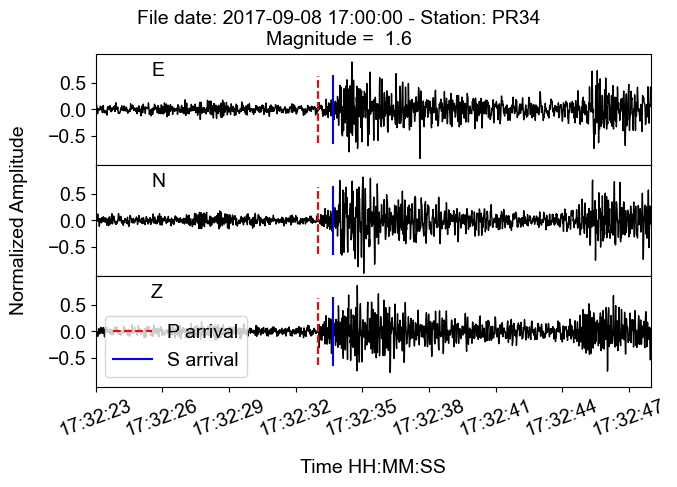

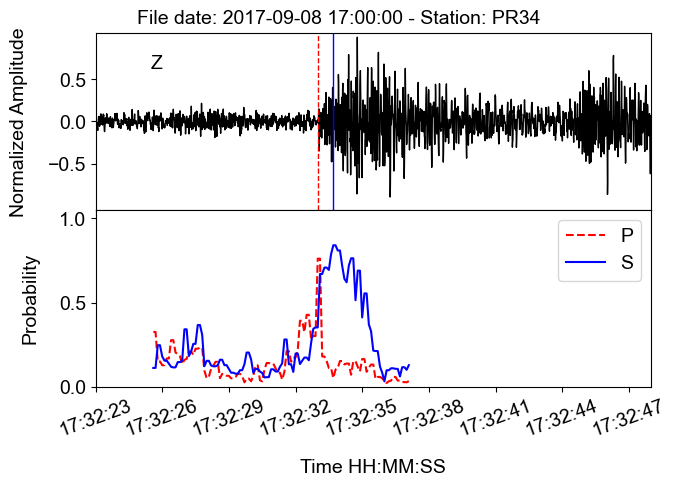

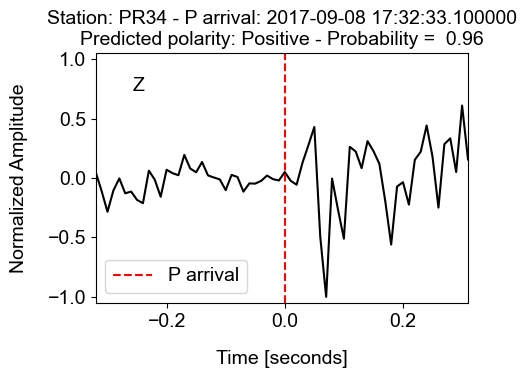


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [19595, 19596, 19597, 19600, 19602]
Continuity check result: False
No events detected till 2017-09-08T17:32:39.000000Z

___________________________________________

Detected event window indices: [19600, 19602, 19603, 19604, 19608]
Continuity check result: False
No events detected till 2017-09-08T17:32:39.200000Z

___________________________________________

Detected event window indices: [19602, 19603, 19604, 19608, 19618]
Continuity check result: False
No events detected till 2017-09-08T17:32:39.800000Z

___________________________________________

Detected event window indices: [19608, 19618, 19619, 19620, 19621]
Continuity check result: False
No events detected till 2017-09-08T17:32:40.800000Z

_________________

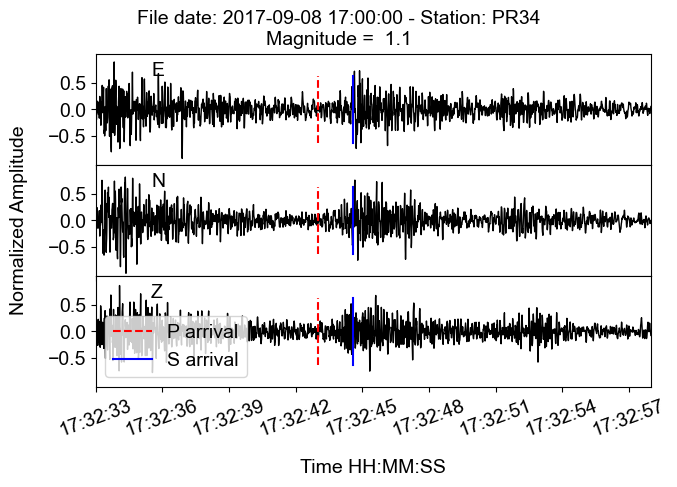

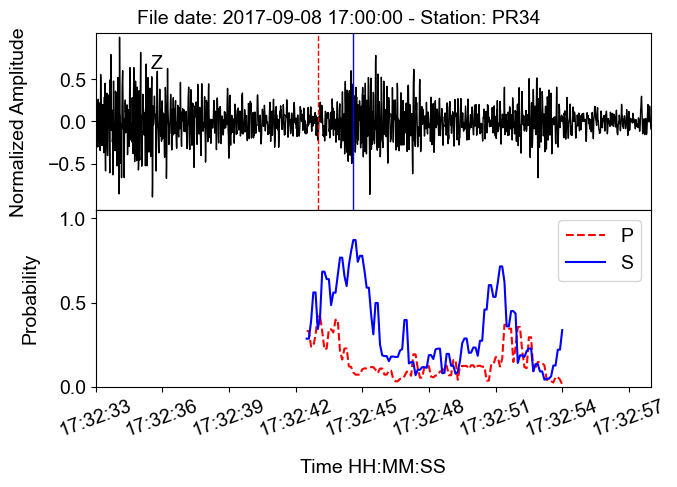

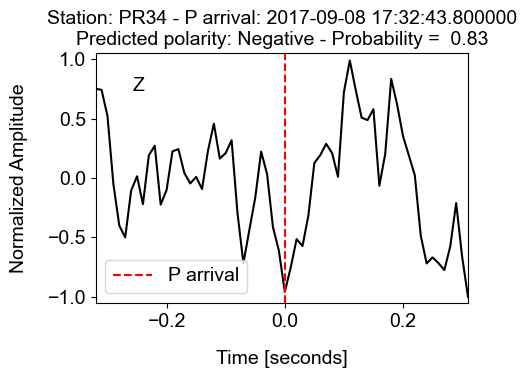


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [19960, 19969, 19971, 19972, 19973]
Continuity check result: False
No events detected till 2017-09-08T17:33:15.900000Z

___________________________________________

Detected event window indices: [19969, 19971, 19972, 19973, 19994]
Continuity check result: False
No events detected till 2017-09-08T17:33:16.100000Z

___________________________________________

Detected event window indices: [19971, 19972, 19973, 19994, 19997]
Continuity check result: False
No events detected till 2017-09-08T17:33:18.400000Z

___________________________________________

Detected event window indices: [19994, 19997, 19998, 19999, 20204]
Continuity check result: False
No events detected till 2017-09-08T17:33:18.700000Z

_________________

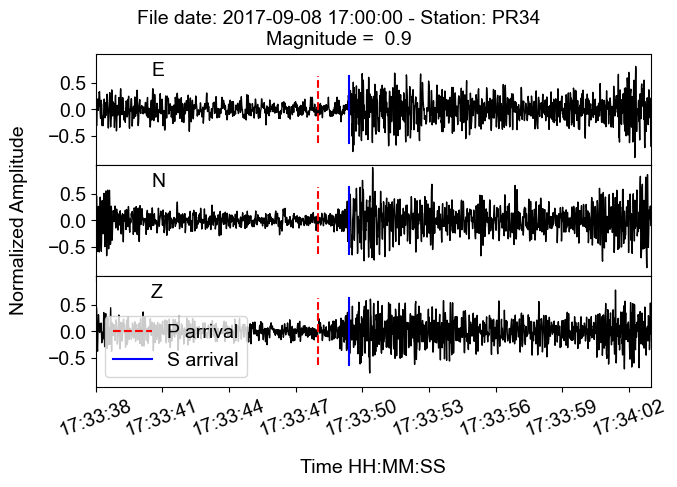

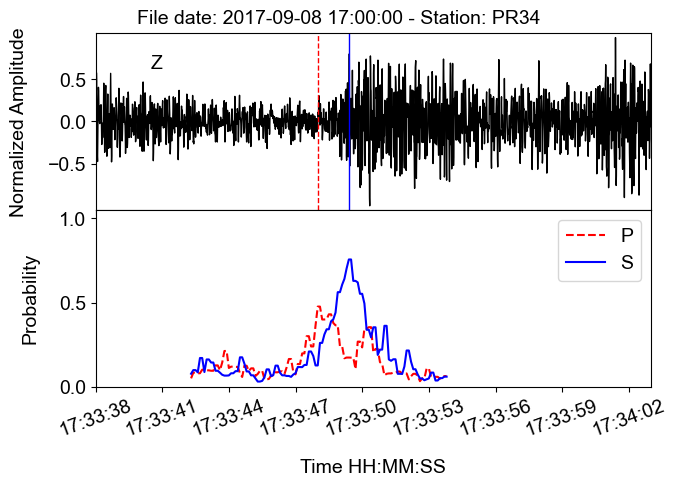

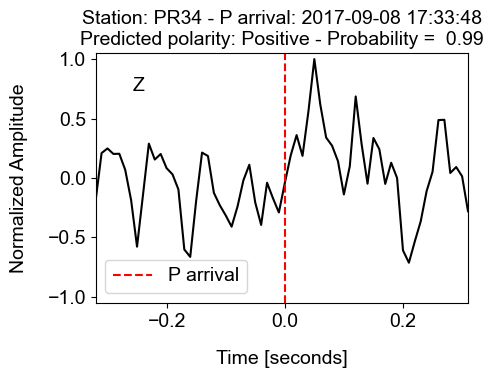


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [20669, 20670, 20671, 20672, 20673]
Continuity check result: True

____________ Event: 52 _____________

2) Running DynaPicker for phase picking
Time elapsed: 15.12 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 294ms/step
Time elapsed: 0.79 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:34:33.800000Z
S-arrival: 2017-09-08T17:34:36.200000Z
Magnitude: 1.100000023841858
Polarity: Positive (Probability: 0.985)


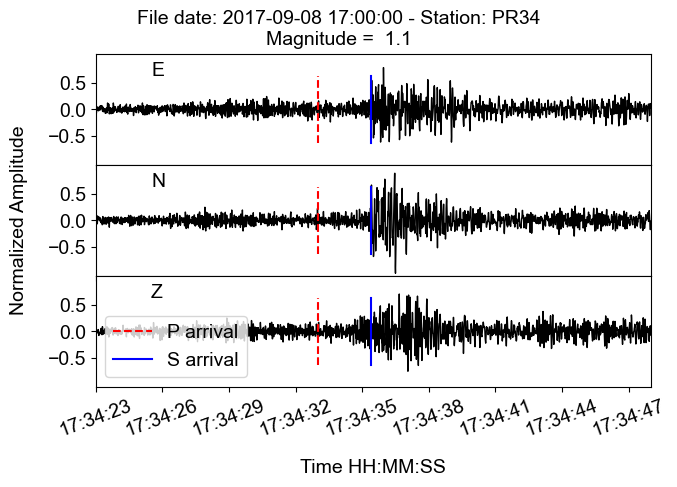

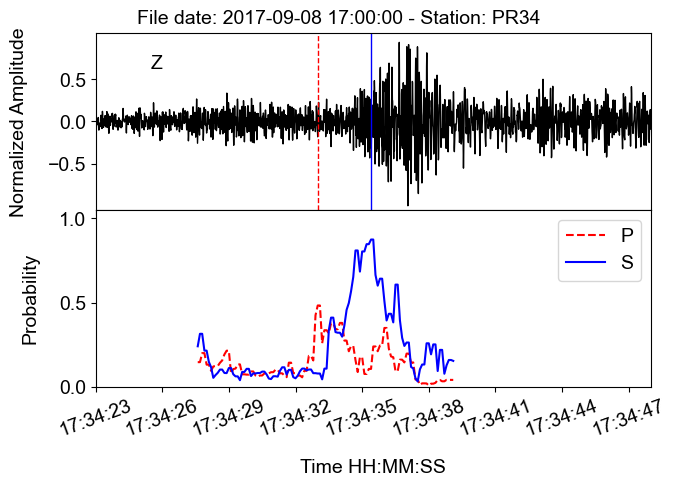

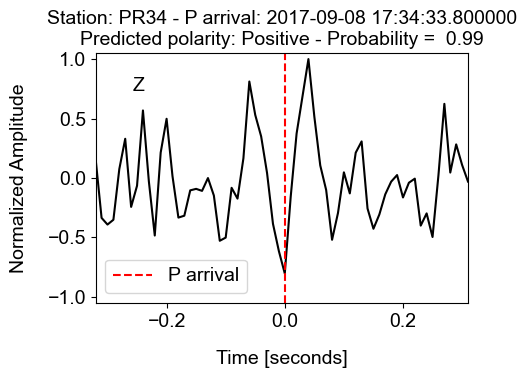


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [21722, 21723, 21724, 21725, 21726]
Continuity check result: True

____________ Event: 53 _____________

2) Running DynaPicker for phase picking
Time elapsed: 15.97 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 245ms/step
Time elapsed: 0.84 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:36:20.000000Z
S-arrival: 2017-09-08T17:36:20.900000Z
Magnitude: 0.0
Polarity: Negative (Probability: 1.000)


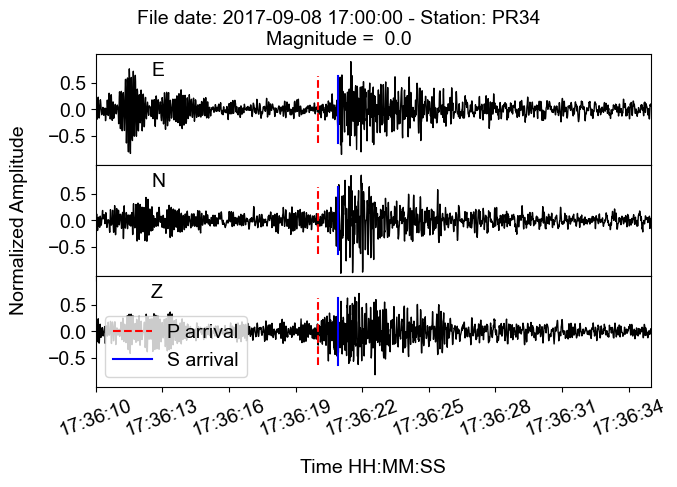

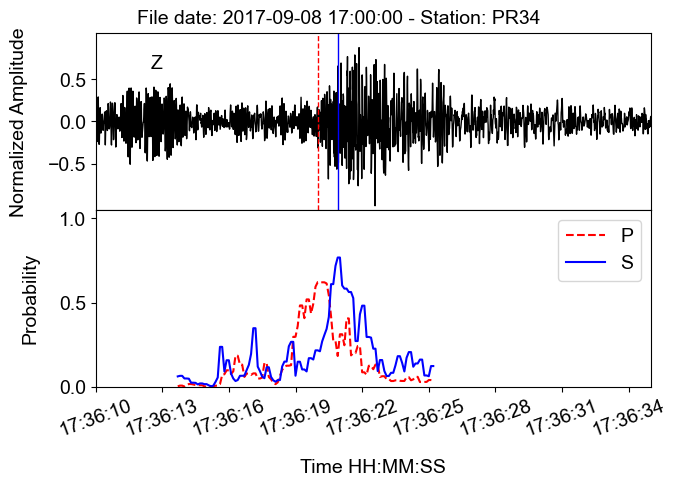

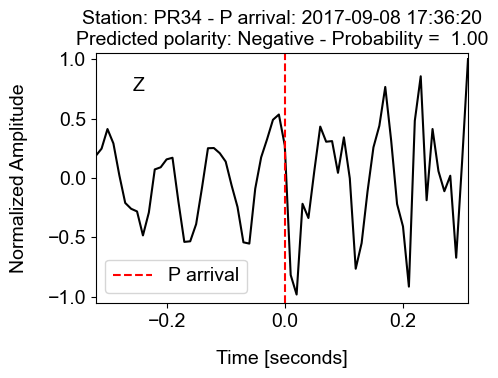


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [22362, 22364, 22369, 22370, 22371]
Continuity check result: False
No events detected till 2017-09-08T17:37:15.400000Z

___________________________________________

Detected event window indices: [22364, 22369, 22370, 22371, 22372]
Continuity check result: False
No events detected till 2017-09-08T17:37:15.900000Z

___________________________________________

Detected event window indices: [22369, 22370, 22371, 22372, 22373]
Continuity check result: True

____________ Event: 54 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.82 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 242ms/step
Time elapsed: 0.77 seconds

4) Results
Result:
P-arrival: 2017

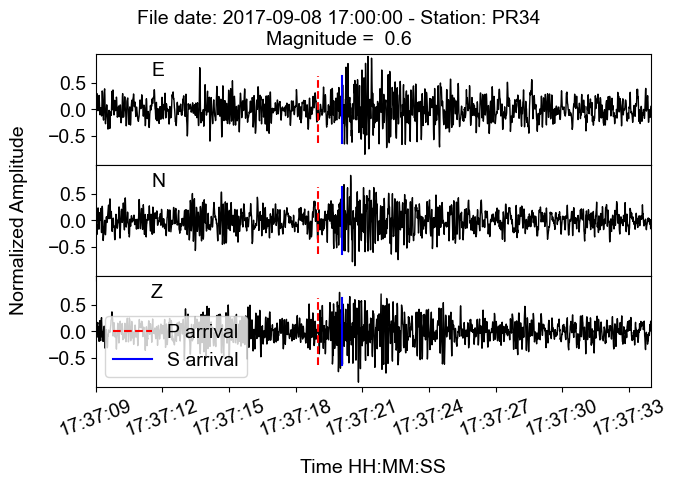

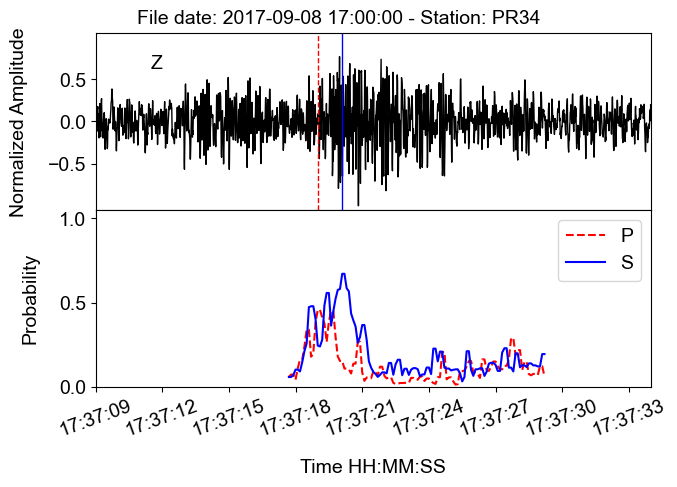

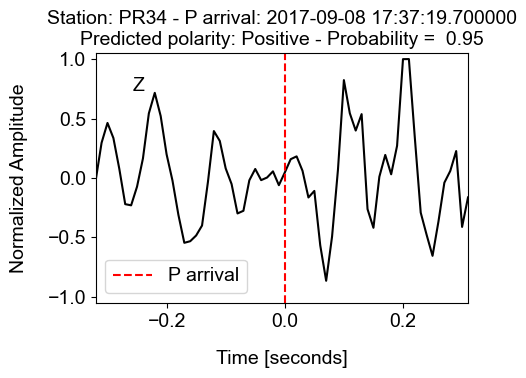


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [22544, 22545, 22546, 22547, 22548]
Continuity check result: True

____________ Event: 55 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.92 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 226ms/step
Time elapsed: 0.59 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:37:44.000000Z
S-arrival: 2017-09-08T17:37:45.100000Z
Magnitude: 2.5
Polarity: Positive (Probability: 0.917)


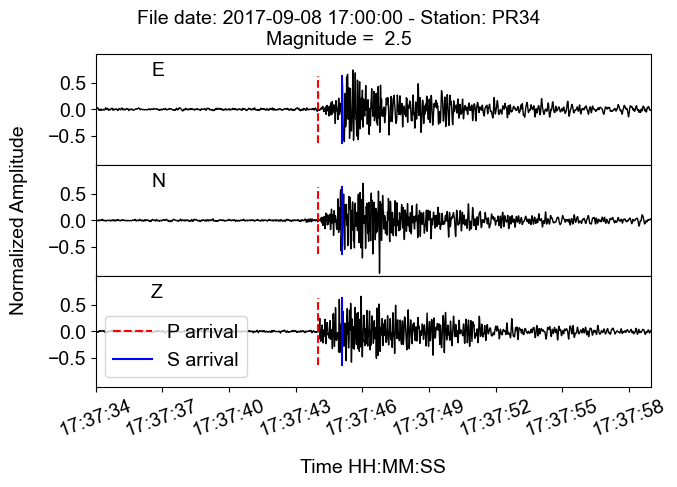

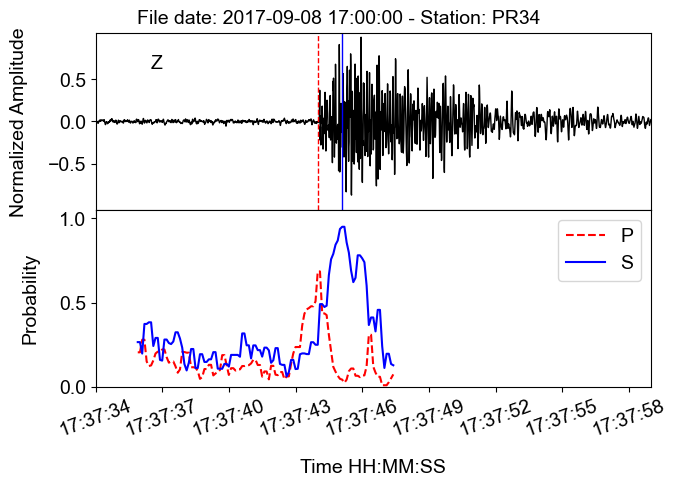

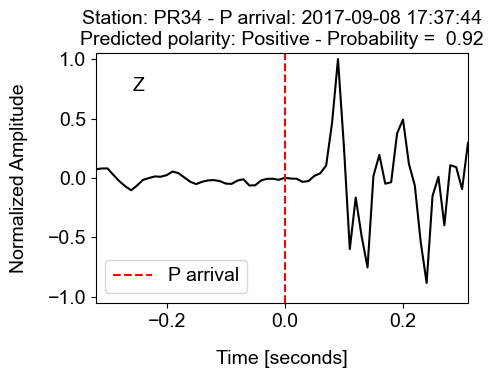


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [22924, 22925, 22930, 22931, 22932]
Continuity check result: False
No events detected till 2017-09-08T17:38:12.000000Z

___________________________________________

Detected event window indices: [22930, 22931, 22932, 22933, 22934]
Continuity check result: True

____________ Event: 56 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.59 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 317ms/step
Time elapsed: 1.01 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:38:18.400000Z
S-arrival: 2017-09-08T17:38:19.400000Z
Magnitude: 0.6000000238418579
Polarity: Positive (Probability: 0.997)


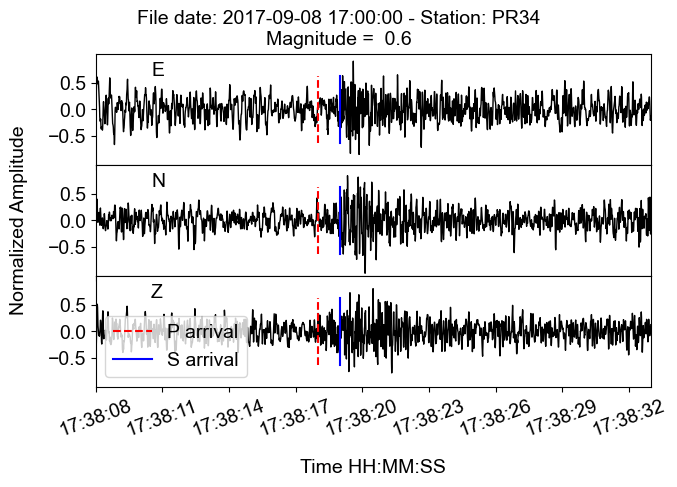

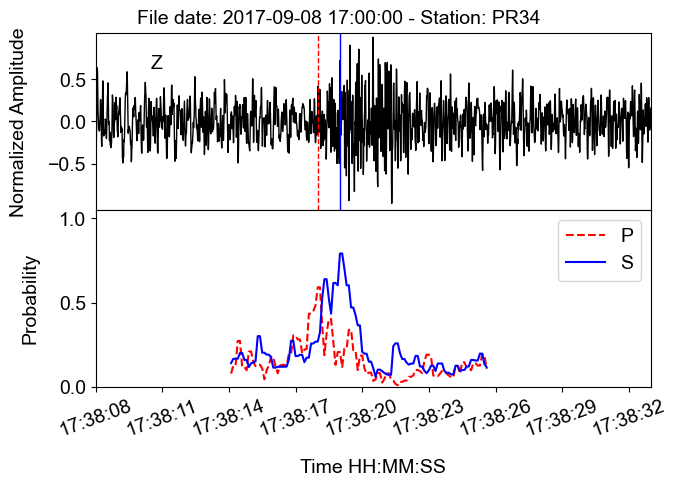

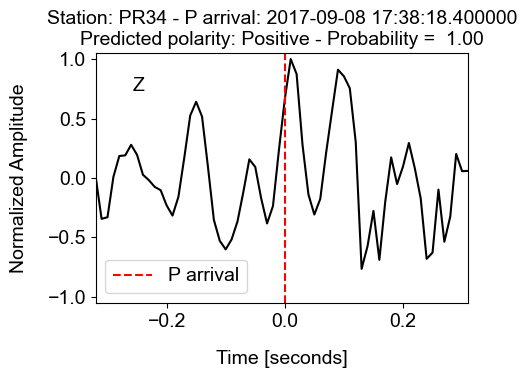


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [23089, 23090, 23091, 23092, 23093]
Continuity check result: True

____________ Event: 57 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.72 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 215ms/step
Time elapsed: 0.59 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:38:37.200000Z
S-arrival: 2017-09-08T17:38:37.700000Z
Magnitude: -0.10000000149011612
Polarity: Positive (Probability: 0.976)


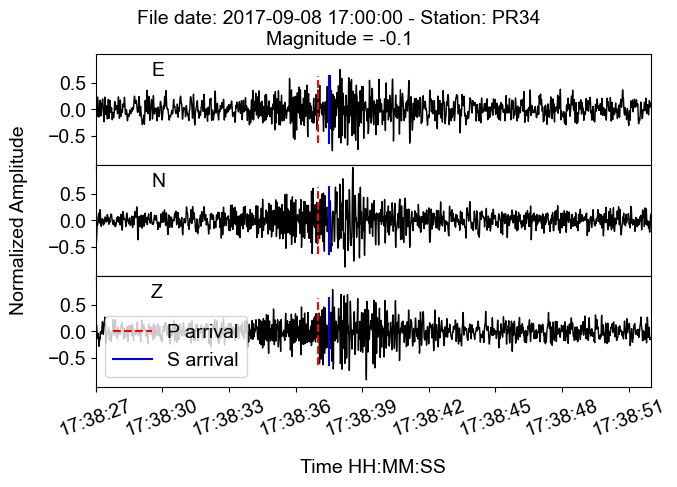

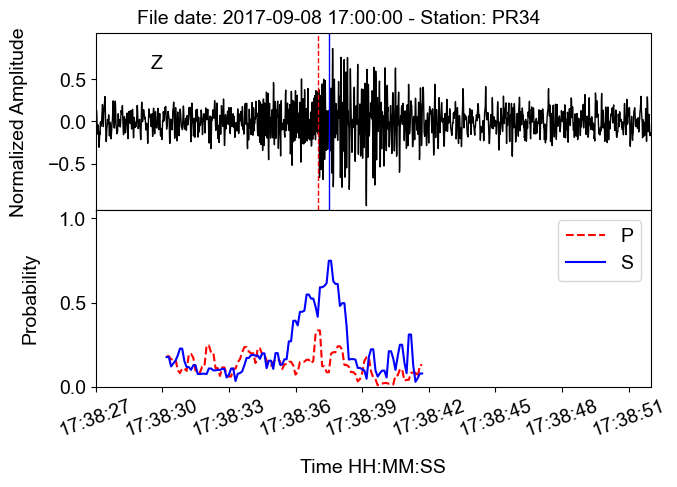

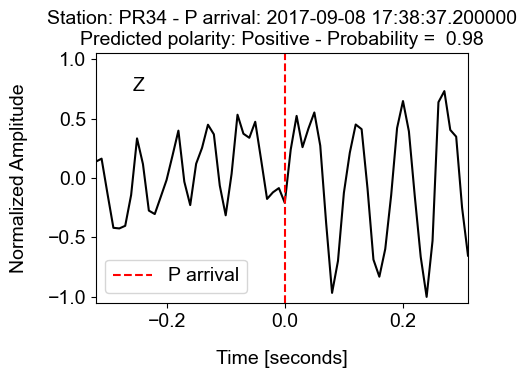


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [24409, 24410, 24411, 24421, 24422]
Continuity check result: False
No events detected till 2017-09-08T17:40:41.100000Z

___________________________________________

Detected event window indices: [24421, 24422, 24423, 24425, 24426]
Continuity check result: False
No events detected till 2017-09-08T17:40:41.500000Z

___________________________________________

Detected event window indices: [24425, 24426, 24427, 24428, 24429]
Continuity check result: True

____________ Event: 58 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.20 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 211ms/step
Time elapsed: 0.58 seconds

4) Results
Result:
P-arrival: 2017

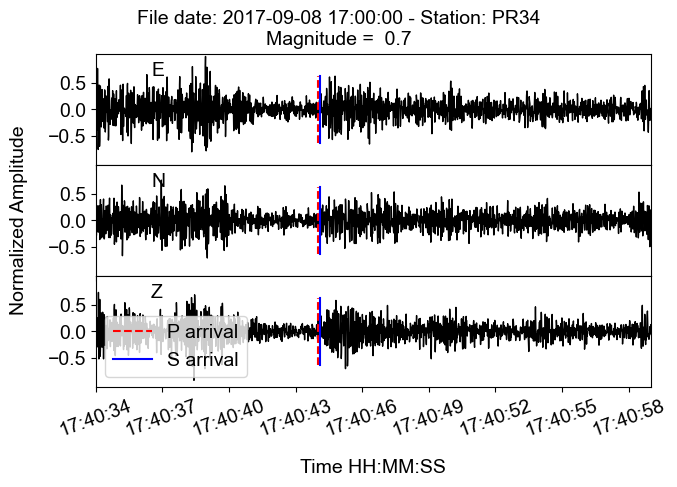

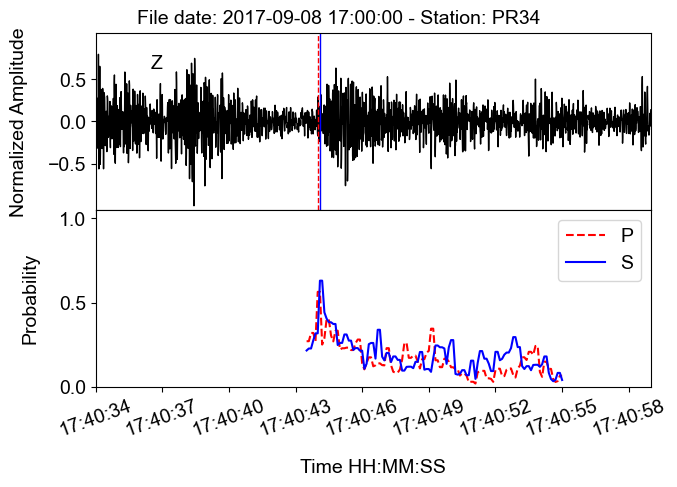

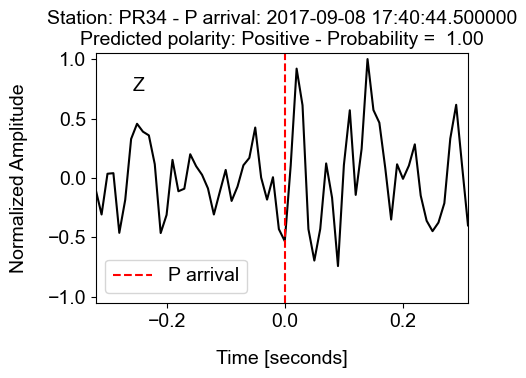


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [26082, 26083, 26084, 26085, 26086]
Continuity check result: True

____________ Event: 59 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.27 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 228ms/step
Time elapsed: 0.61 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:43:37.000000Z
S-arrival: 2017-09-08T17:43:37.900000Z
Magnitude: 1.0
Polarity: Positive (Probability: 0.987)


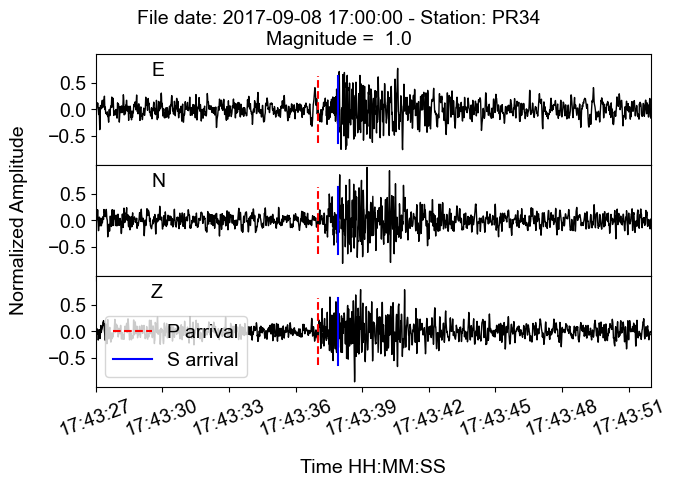

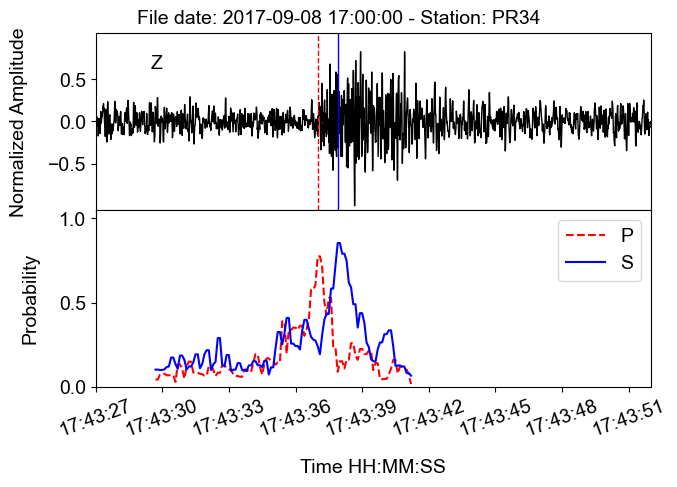

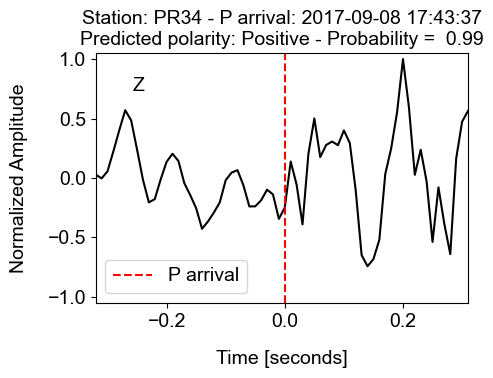


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [26535, 26536, 26538, 26539, 26540]
Continuity check result: False
No events detected till 2017-09-08T17:44:12.800000Z

___________________________________________

Detected event window indices: [26538, 26539, 26540, 26541, 26542]
Continuity check result: True

____________ Event: 60 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.34 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 216ms/step
Time elapsed: 0.59 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:44:22.800000Z
S-arrival: 2017-09-08T17:44:24.400000Z
Magnitude: 1.899999976158142
Polarity: Negative (Probability: 0.982)


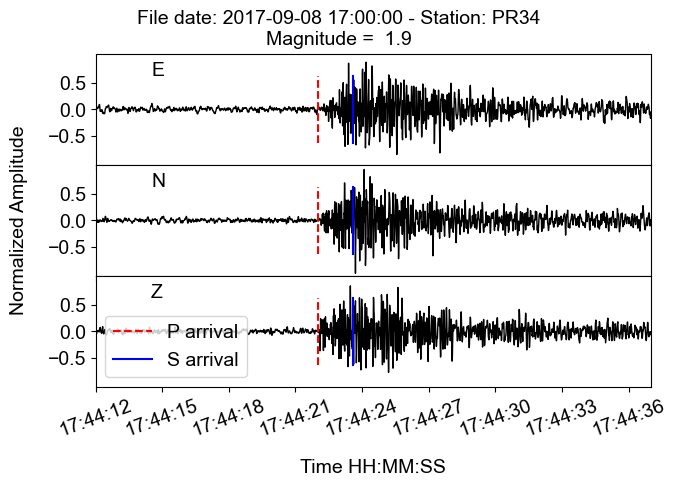

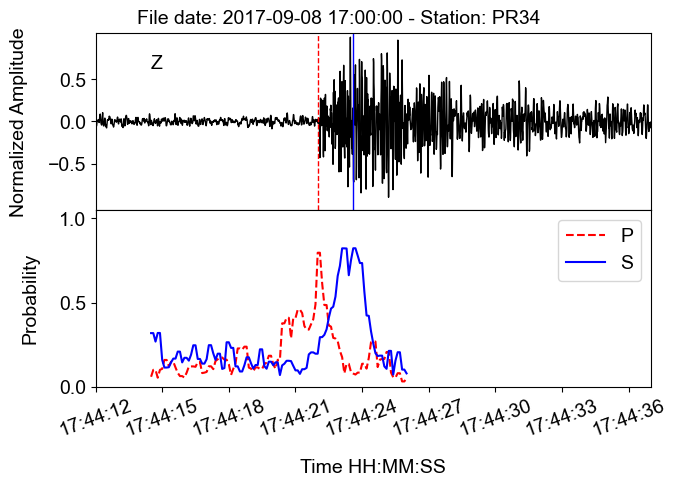

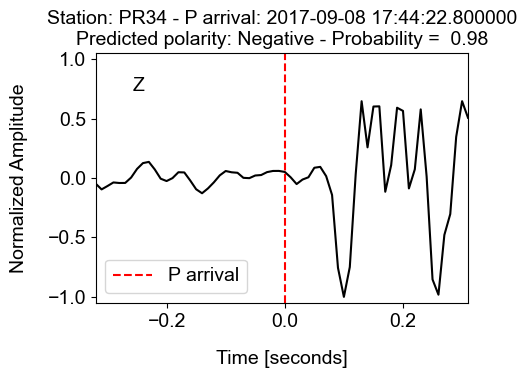


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [29753, 29755, 29757, 29758, 29759]
Continuity check result: False
No events detected till 2017-09-08T17:49:34.500000Z

___________________________________________

Detected event window indices: [29755, 29757, 29758, 29759, 29760]
Continuity check result: False
No events detected till 2017-09-08T17:49:34.700000Z

___________________________________________

Detected event window indices: [29757, 29758, 29759, 29760, 29761]
Continuity check result: True

____________ Event: 61 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.58 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 241ms/step
Time elapsed: 0.71 seconds

4) Results
Result:
P-arrival: 2017

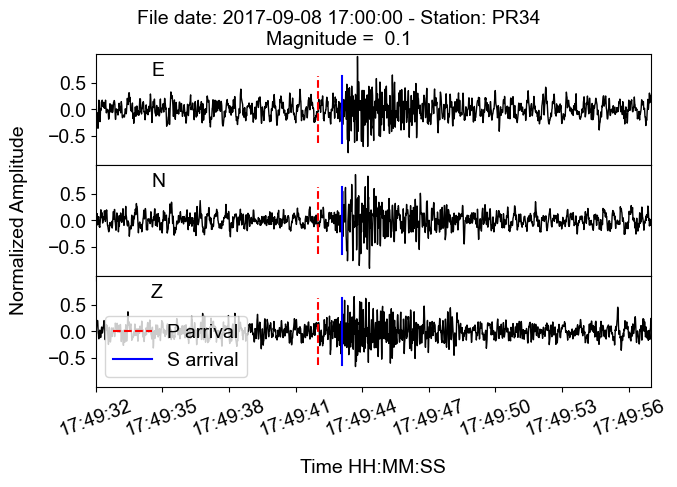

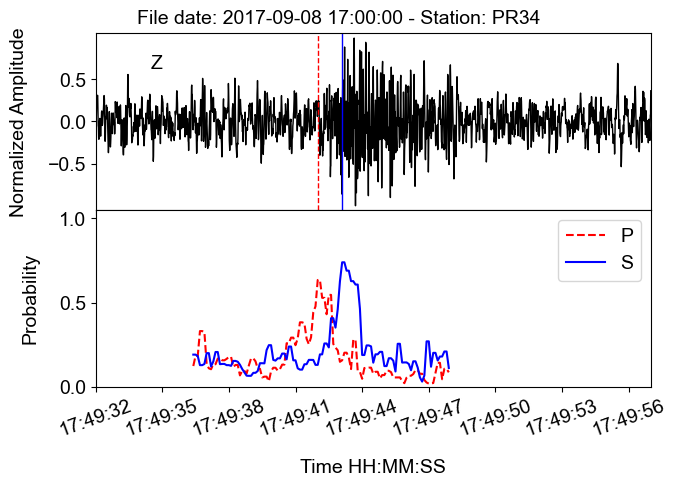

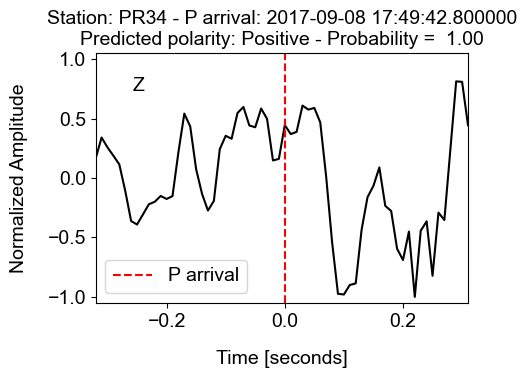


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [30238, 30240, 30250, 30251, 30252]
Continuity check result: False
No events detected till 2017-09-08T17:50:23.000000Z

___________________________________________

Detected event window indices: [30240, 30250, 30251, 30252, 30253]
Continuity check result: False
No events detected till 2017-09-08T17:50:24.000000Z

___________________________________________

Detected event window indices: [30250, 30251, 30252, 30253, 30254]
Continuity check result: True

____________ Event: 62 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.52 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 217ms/step
Time elapsed: 1.08 seconds

4) Results
Result:
P-arrival: 2017

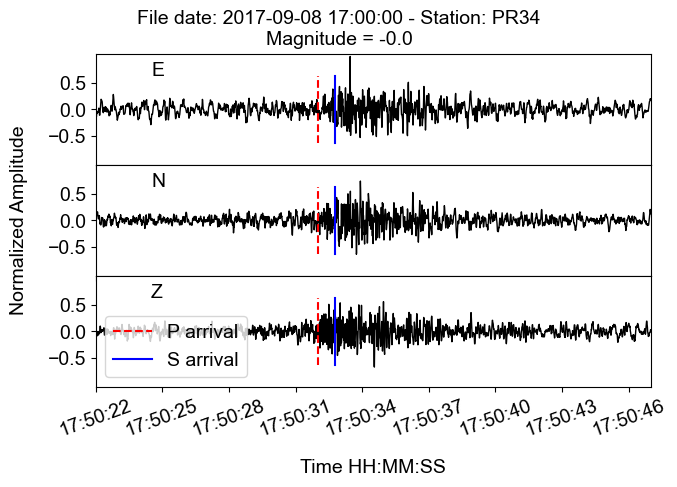

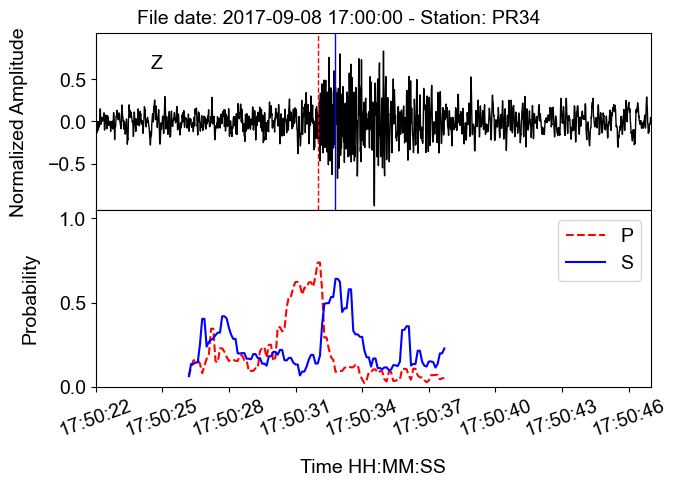

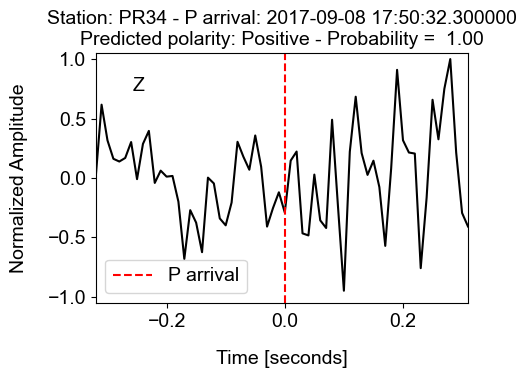


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [31034, 31035, 31036, 31037, 31038]
Continuity check result: True

____________ Event: 63 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.99 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 206ms/step
Time elapsed: 0.57 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:51:51.900000Z
S-arrival: 2017-09-08T17:51:52.400000Z
Magnitude: 0.20000000298023224
Polarity: Negative (Probability: 0.682)


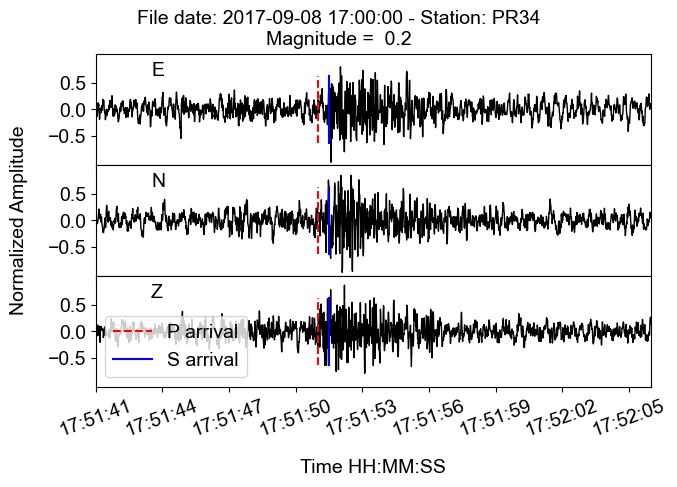

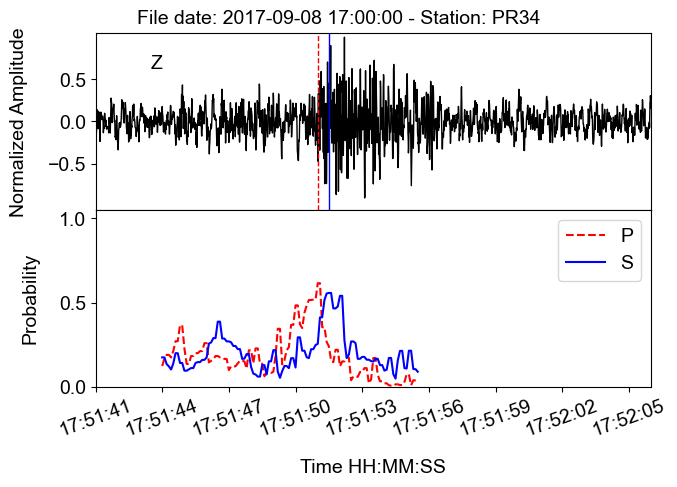

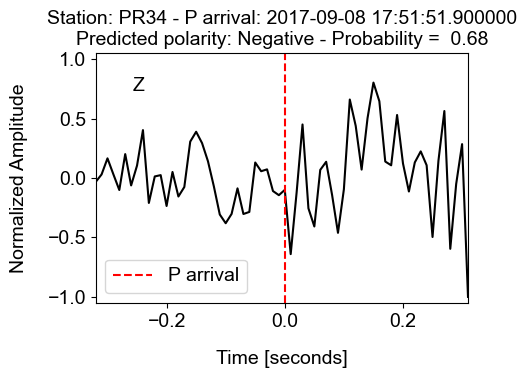


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [32352, 32353, 32355, 33425, 33426]
Continuity check result: False
No events detected till 2017-09-08T17:53:54.500000Z

___________________________________________

Detected event window indices: [32355, 33425, 33426, 33427, 33428]
Continuity check result: False
No events detected till 2017-09-08T17:55:41.500000Z

___________________________________________

Detected event window indices: [33425, 33426, 33427, 33428, 33429]
Continuity check result: True

____________ Event: 64 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.65 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 208ms/step
Time elapsed: 0.60 seconds

4) Results
Result:
P-arrival: 2017

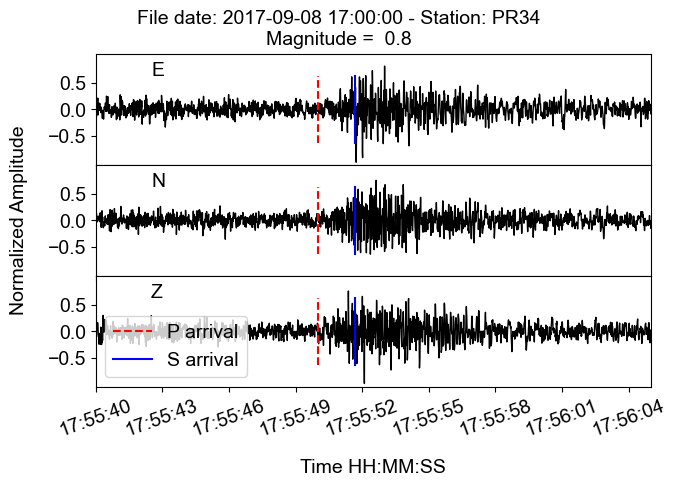

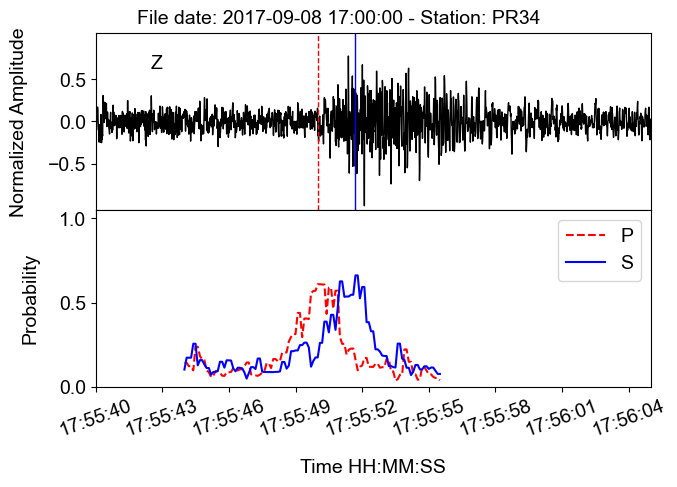

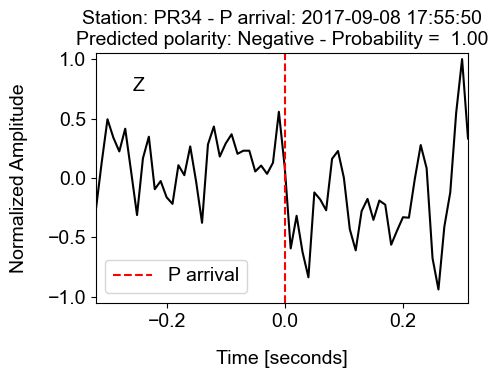


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [33721, 33722, 33723, 33724, 33725]
Continuity check result: True

____________ Event: 65 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.81 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 279ms/step
Time elapsed: 0.68 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:56:20.500000Z
S-arrival: 2017-09-08T17:56:21.500000Z
Magnitude: 0.800000011920929
Polarity: Negative (Probability: 0.977)


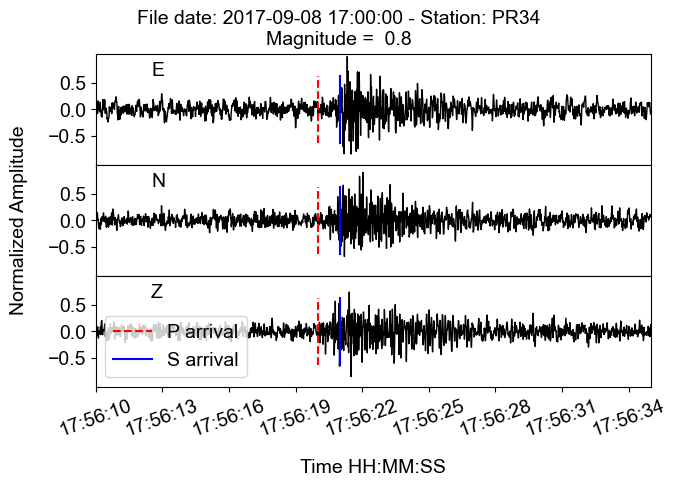

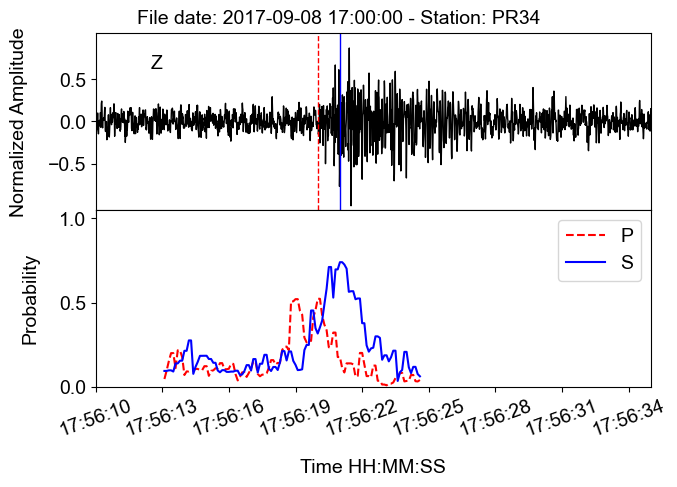

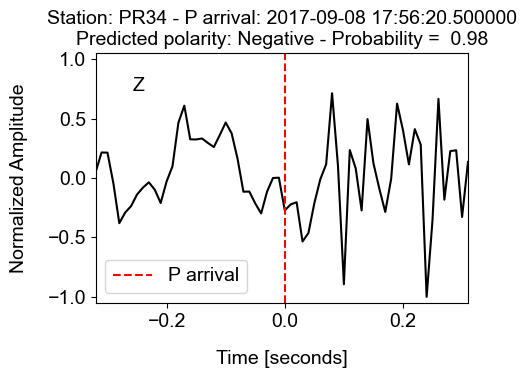


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000

___________________________________________

Detected event window indices: [34276, 34277, 34278, 34279, 34280]
Continuity check result: True

____________ Event: 66 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.21 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 232ms/step
Time elapsed: 0.62 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:57:16.200000Z
S-arrival: 2017-09-08T17:57:20.000000Z
Magnitude: 0.5
Polarity: Positive (Probability: 0.981)


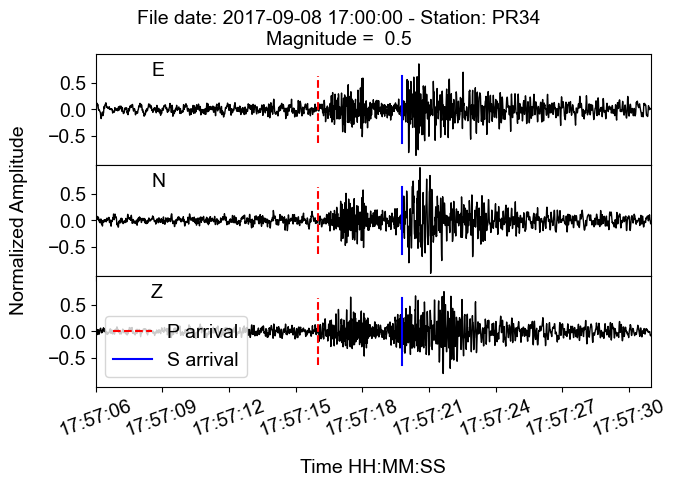

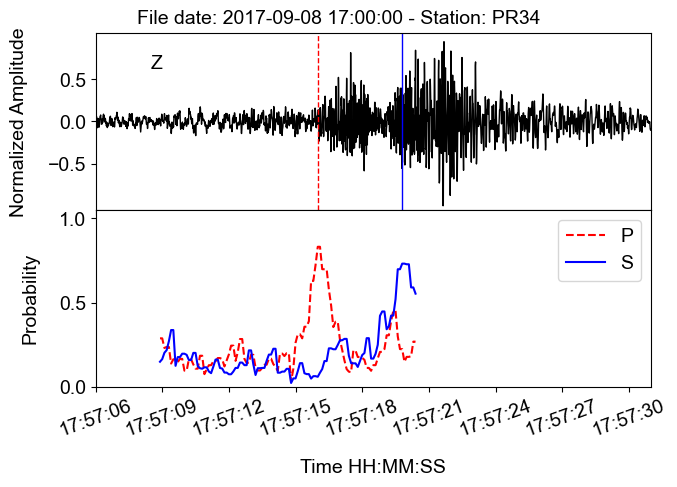

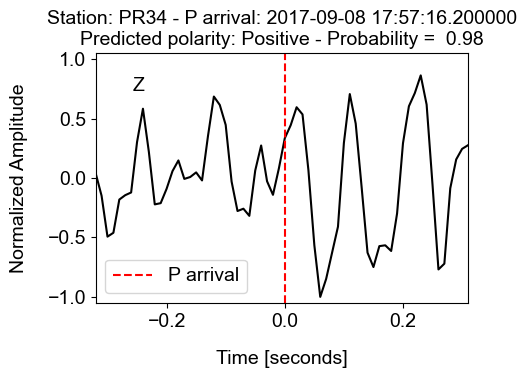


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000results_PR34_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_170000
Analysis completed. No more events detected.
Total time elapsed: 1866.12 seconds

** Reading data: station PR44, date 2017-09-08 17:00:00... **

** Preprocessing data... **
Time elapsed: 0.15430402755737305 

** Monitoring data... **
Earthquake scan time window: 15 seconds
Stepsize for detection: 10 samples
Earthquake detected with 5 consecutive positive detections
Stepsize for picking: 10 samples

1) Running Creime_rt for event detection and magnitude


/Volumes/GUAN_YIN/SAIPy_Network_Paper/SAIPy_network/venv_saipy/lib/python3.8/site-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


141/141 [==============================] - 548s 4s/step
Time elapsed: 564.93 seconds
Number of detected earthquake windows: 584

___________________________________________

Detected event window indices: [1073, 1074, 1075, 1076, 9694]
Continuity check result: False
No events detected till 2017-09-08T17:16:08.400000Z

___________________________________________

Detected event window indices: [9694, 9695, 9696, 9700, 9701]
Continuity check result: False
No events detected till 2017-09-08T17:16:09.000000Z

___________________________________________

Detected event window indices: [9700, 9701, 9702, 9703, 9704]
Continuity check result: True

____________ Event: 1 _____________

2) Running DynaPicker for phase picking
Time elapsed: 28.50 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 308ms/step
Time elapsed: 0.91 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:16:17.600000Z
S-arrival: 2017-09-08T17:16:18.900000Z
Magnitude: 1.1000000238

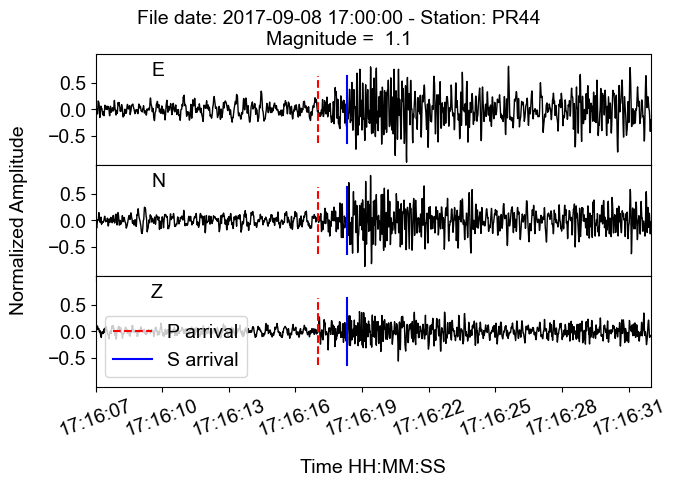

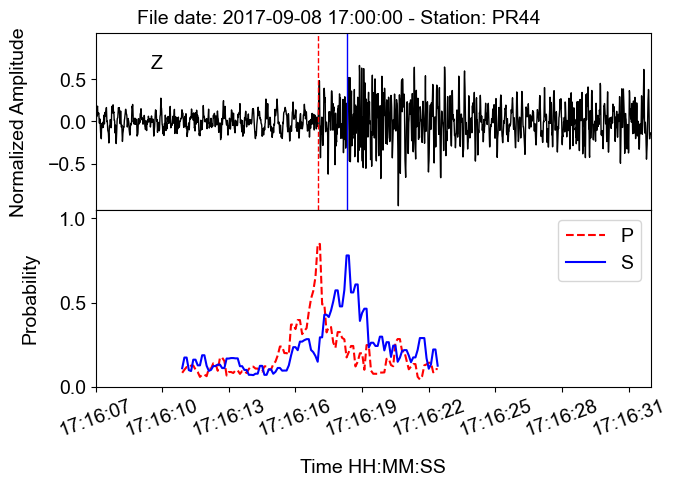

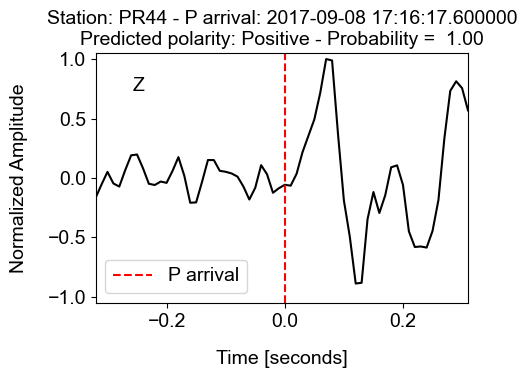


Saving results in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000results_PR44_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000

___________________________________________

Detected event window indices: [10269, 10270, 10271, 10272, 10273]
Continuity check result: True

____________ Event: 2 _____________

2) Running DynaPicker for phase picking
Time elapsed: 18.59 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 231ms/step
Time elapsed: 0.62 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:17:13.600000Z
S-arrival: 2017-09-08T17:17:15.000000Z
Magnitude: 0.4000000059604645
Polarity: Positive (Probability: 0.857)


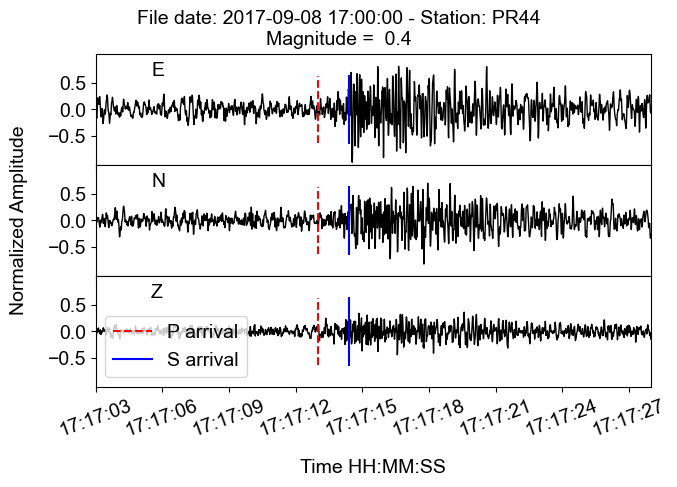

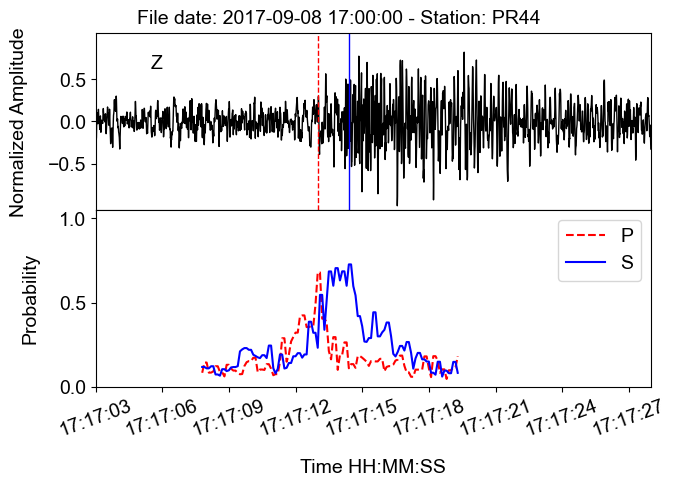

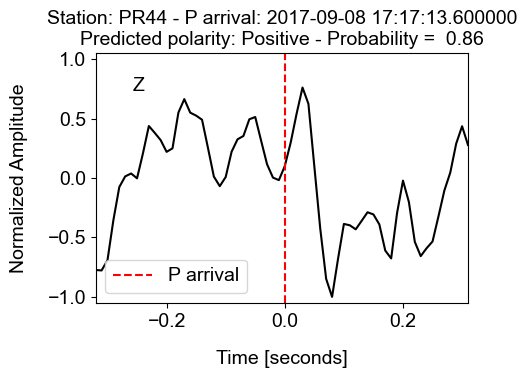


Saving results in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000results_PR44_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000

___________________________________________

Detected event window indices: [11417, 11418, 11419, 11420, 11421]
Continuity check result: True

____________ Event: 3 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.45 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 247ms/step
Time elapsed: 0.74 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:19:10.600000Z
S-arrival: 2017-09-08T17:19:11.900000Z
Magnitude: 1.100000023841858
Polarity: Positive (Probability: 0.995)


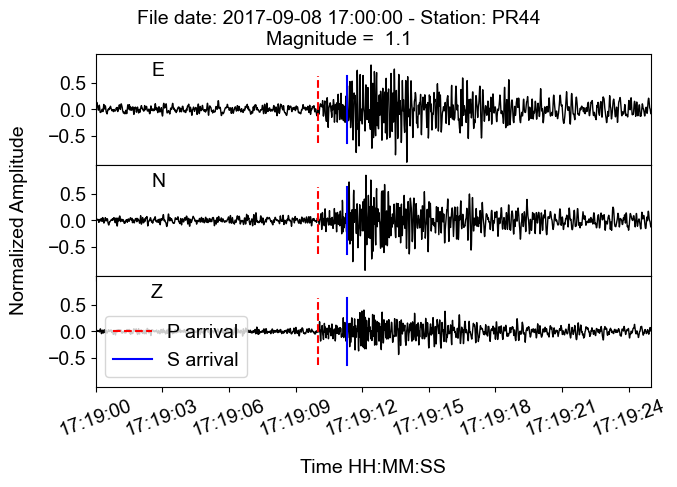

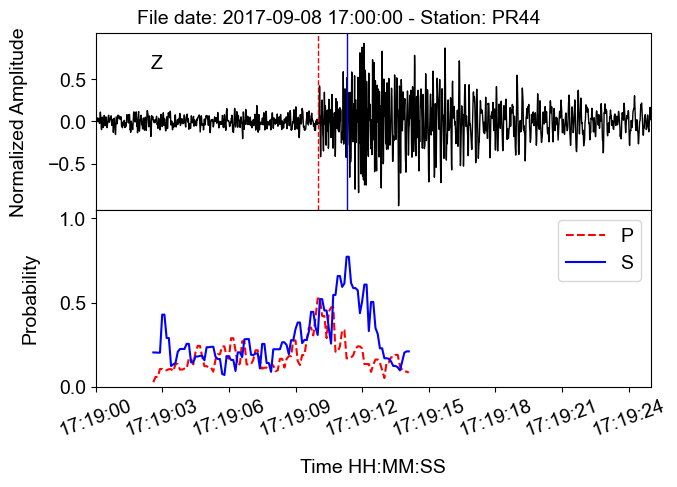

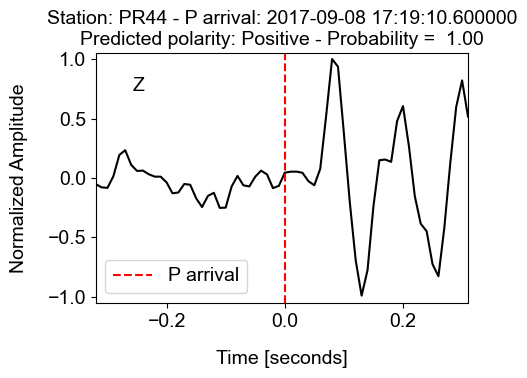


Saving results in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000results_PR44_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000

___________________________________________

Detected event window indices: [11925, 11926, 11927, 11928, 11929]
Continuity check result: True

____________ Event: 4 _____________

2) Running DynaPicker for phase picking
Time elapsed: 15.45 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 280ms/step
Time elapsed: 0.89 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:20:01.500000Z
S-arrival: 2017-09-08T17:20:02.800000Z
Magnitude: 1.899999976158142
Polarity: Positive (Probability: 1.000)


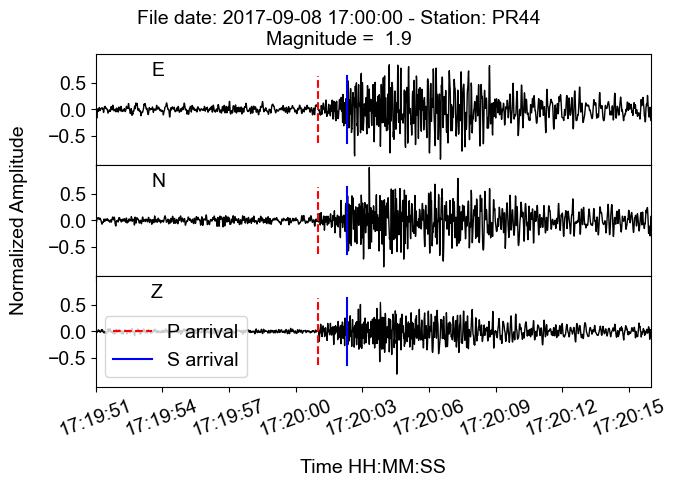

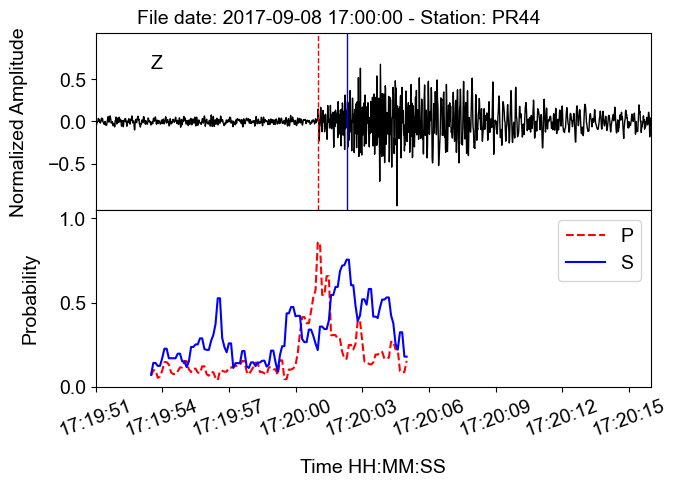

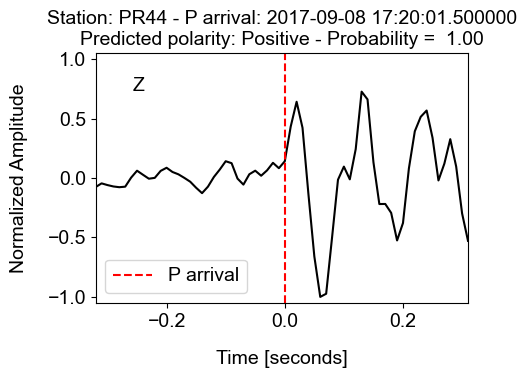


Saving results in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000results_PR44_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000

___________________________________________

Detected event window indices: [13897, 13899, 13900, 13901, 13902]
Continuity check result: False
No events detected till 2017-09-08T17:23:08.900000Z

___________________________________________

Detected event window indices: [13899, 13900, 13901, 13902, 13903]
Continuity check result: True

____________ Event: 5 _____________

2) Running DynaPicker for phase picking
Time elapsed: 15.09 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 280ms/step
Time elapsed: 1.96 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:23:22.600000Z
S-arrival: 2017-09-08T17:23:22.900000Z
Magnitude: 0.5
Polarity: Positive (Probability: 1.000)


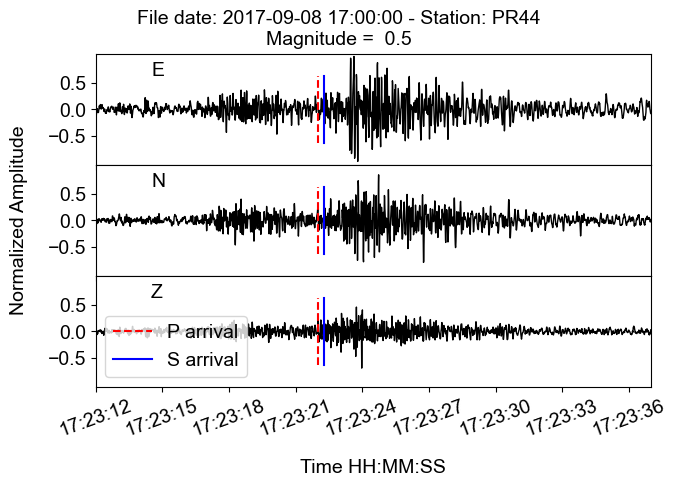

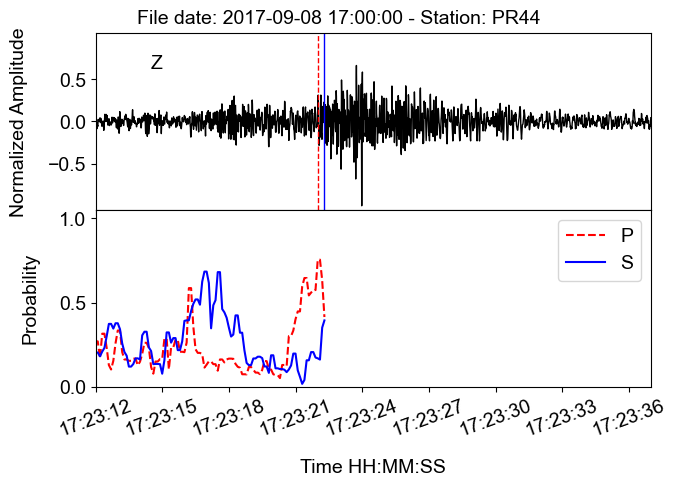

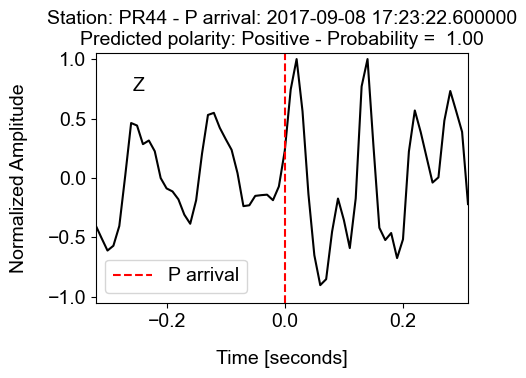


Saving results in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000results_PR44_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000

___________________________________________

Detected event window indices: [14386, 14389, 14390, 14391, 14392]
Continuity check result: False
No events detected till 2017-09-08T17:23:57.900000Z

___________________________________________

Detected event window indices: [14389, 14390, 14391, 14392, 14393]
Continuity check result: True

____________ Event: 6 _____________

2) Running DynaPicker for phase picking
Time elapsed: 15.48 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 239ms/step
Time elapsed: 0.74 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:24:00.600000Z
S-arrival: 2017-09-08T17:24:01.600000Z
Magnitude: 1.2999999523162842
Polarity: Positive (Probability: 0.906)


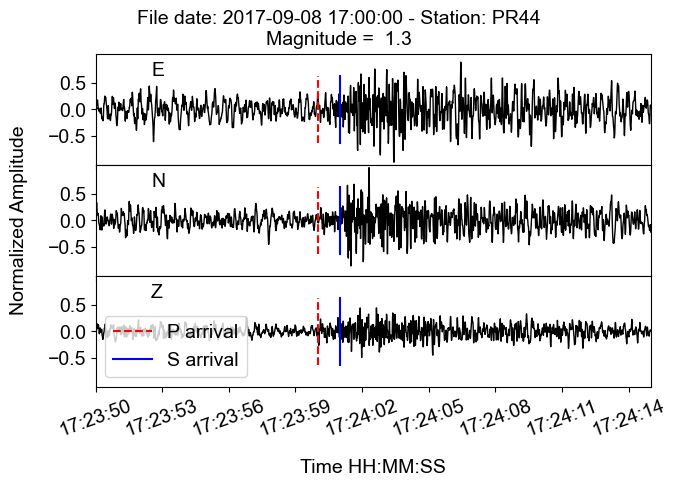

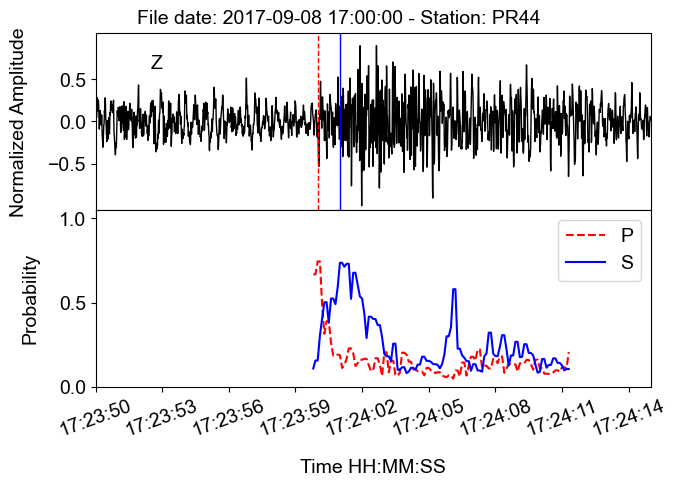

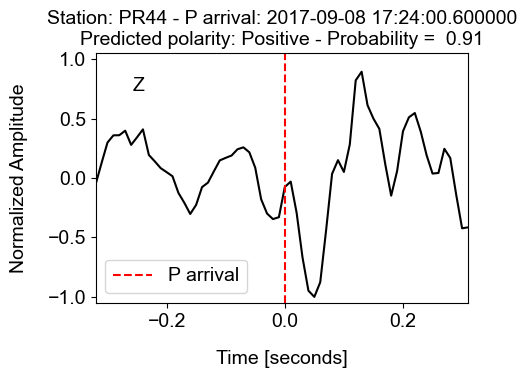


Saving results in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000results_PR44_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000

___________________________________________

Detected event window indices: [17960, 22555, 22556, 22557, 22558]
Continuity check result: False
No events detected till 2017-09-08T17:37:34.500000Z

___________________________________________

Detected event window indices: [22555, 22556, 22557, 22558, 22559]
Continuity check result: True

____________ Event: 7 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.24 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 240ms/step
Time elapsed: 0.66 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:37:44.400000Z
S-arrival: 2017-09-08T17:37:45.700000Z
Magnitude: 1.899999976158142
Polarity: Positive (Probability: 1.000)


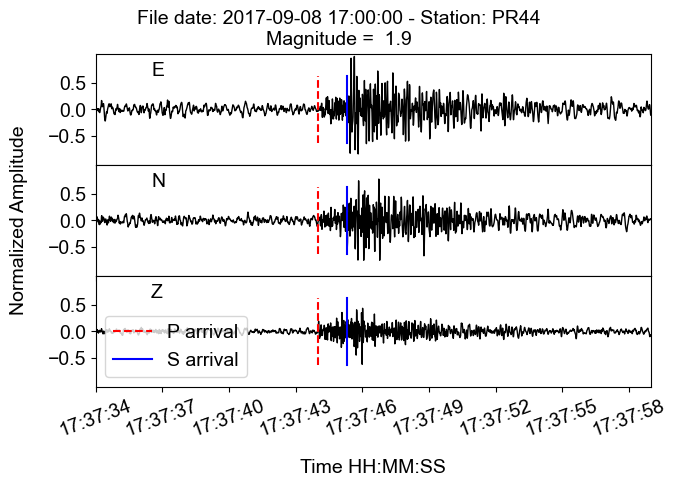

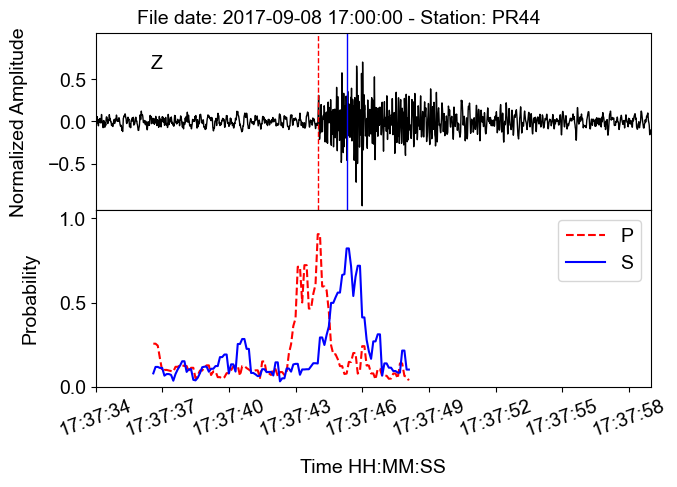

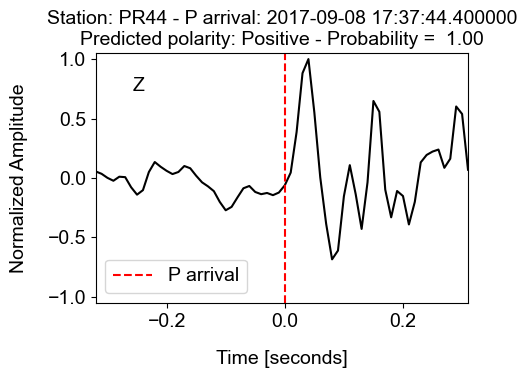


Saving results in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000results_PR44_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000

___________________________________________

Detected event window indices: [26552, 26553, 26554, 26555, 26556]
Continuity check result: True

____________ Event: 8 _____________

2) Running DynaPicker for phase picking
Time elapsed: 15.10 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 337ms/step
Time elapsed: 0.95 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:44:24.300000Z
S-arrival: 2017-09-08T17:44:24.500000Z
Magnitude: 0.10000000149011612
Polarity: Positive (Probability: 0.997)


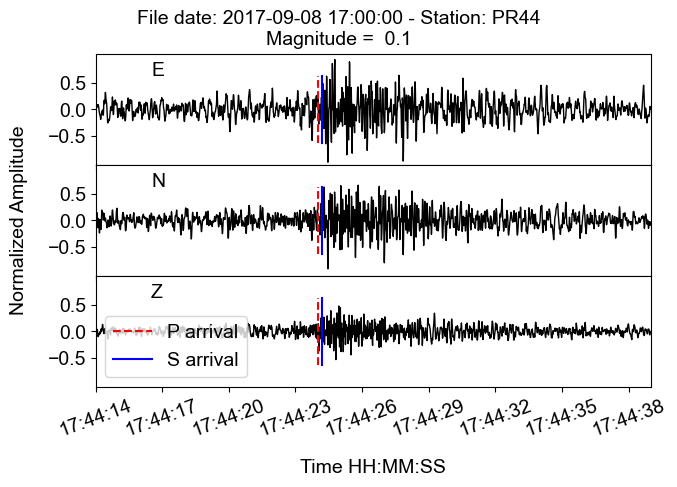

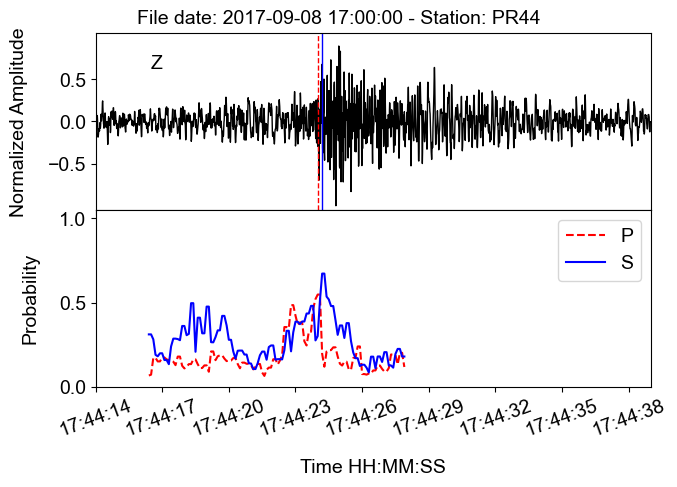

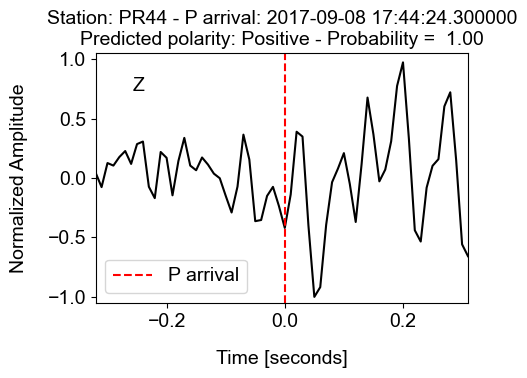


Saving results in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000results_PR44_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR44/20170908_170000
Analysis completed. No more events detected.
Total time elapsed: 739.99 seconds

** End of Single-station monitoring: station PR44, date 2017-09-08 17:00:00. *******************************


** Reading data: station PR34, date 2017-09-08 19:00:00... **

** Preprocessing data... **
Time elapsed: 0.1850121021270752 

** Monitoring data... **
Earthquake scan time window: 15 seconds
Stepsize for detection: 10 samples
Earthquake detected with 5 consecutive positive detections
Stepsize for picking: 10 samples

1) Running Creime_rt for event detection and magnitude


/Volumes/GUAN_YIN/SAIPy_Network_Paper/SAIPy_network/venv_saipy/lib/python3.8/site-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


141/141 [==============================] - 545s 4s/step
Time elapsed: 558.57 seconds
Number of detected earthquake windows: 35

___________________________________________

Detected event window indices: [29594, 29603, 29604, 29605, 29606]
Continuity check result: False
No events detected till 2017-09-08T19:49:19.300000Z

___________________________________________

Detected event window indices: [29603, 29604, 29605, 29606, 29608]
Continuity check result: False
No events detected till 2017-09-08T19:49:19.800000Z

___________________________________________

Detected event window indices: [29608, 29609, 29610, 29611, 29612]
Continuity check result: True

____________ Event: 1 _____________

2) Running DynaPicker for phase picking
Time elapsed: 36.35 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 251ms/step
Time elapsed: 1.89 seconds

4) Results
Result:
P-arrival: 2017-09-08T19:49:25.400000Z
S-arrival: 2017-09-08T19:49:26.900000Z
Magnitude

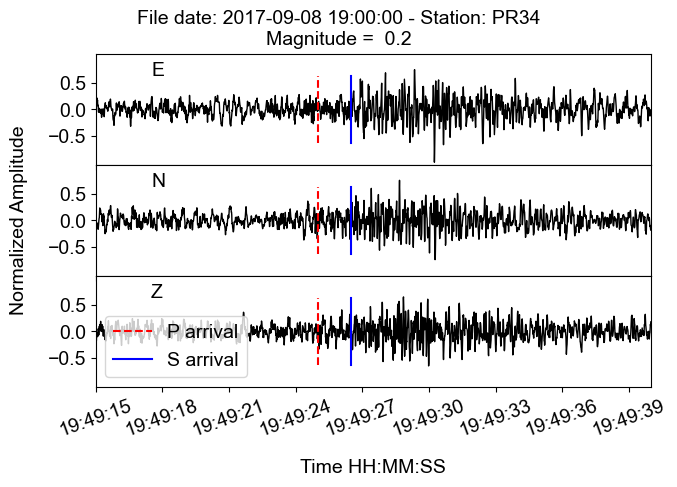

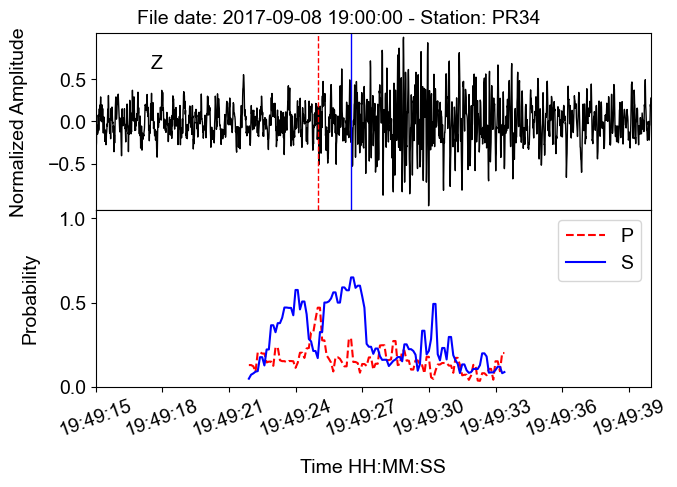

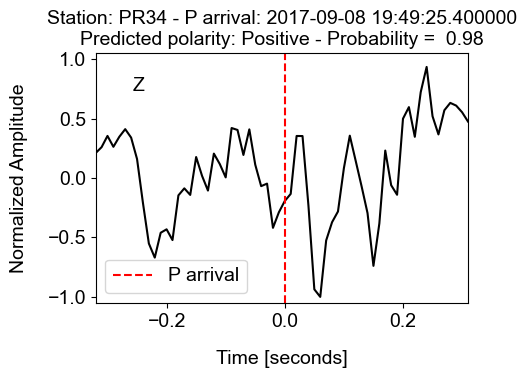


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_190000results_PR34_20170908_190000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170908_190000
Analysis completed. No more events detected.
Total time elapsed: 600.00 seconds

** Reading data: station PR44, date 2017-09-08 19:00:00... **

** Preprocessing data... **
Time elapsed: 0.14966201782226562 

** Monitoring data... **
Earthquake scan time window: 15 seconds
Stepsize for detection: 10 samples
Earthquake detected with 5 consecutive positive detections
Stepsize for picking: 10 samples

1) Running Creime_rt for event detection and magnitude


/Volumes/GUAN_YIN/SAIPy_Network_Paper/SAIPy_network/venv_saipy/lib/python3.8/site-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


141/141 [==============================] - 527s 4s/step
Time elapsed: 540.12 seconds
Number of detected earthquake windows: 1
Total time elapsed: 540.13 seconds

** End of Single-station monitoring: station PR44, date 2017-09-08 19:00:00. *******************************


** Reading data: station PR34, date 2017-09-09 06:00:00... **

** Preprocessing data... **
Time elapsed: 0.16763806343078613 

** Monitoring data... **
Earthquake scan time window: 15 seconds
Stepsize for detection: 10 samples
Earthquake detected with 5 consecutive positive detections
Stepsize for picking: 10 samples

1) Running Creime_rt for event detection and magnitude
141/141 [==============================] - 564s 4s/step
Time elapsed: 578.22 seconds
Number of detected earthquake windows: 557

___________________________________________

Detected event window indices: [1380, 1431, 15929, 15930, 15931]
Continuity check result: False
No events detected till 2017-09-09T06:02:22.100000Z

_____________________________

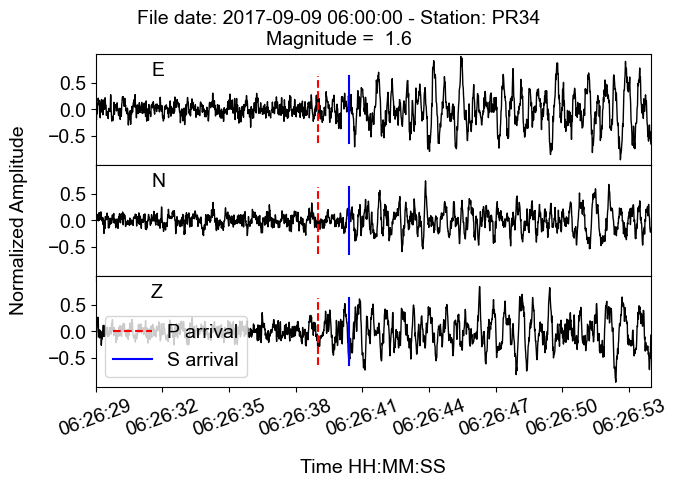

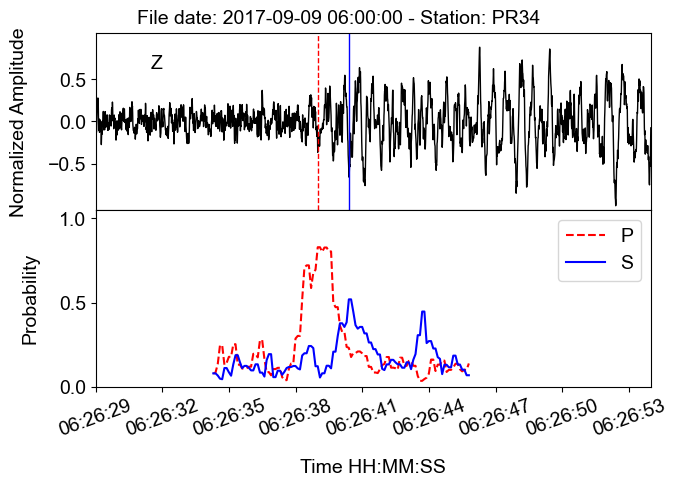

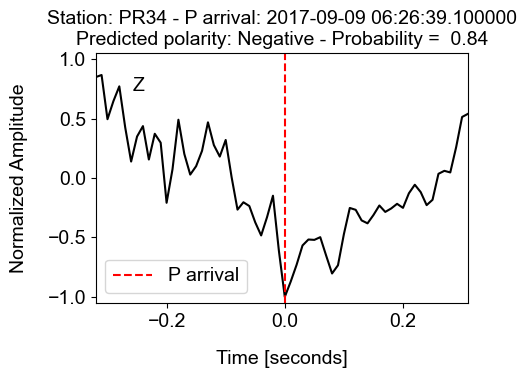


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000results_PR34_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000

___________________________________________

Detected event window indices: [20815, 20816, 20817, 20818, 20819]
Continuity check result: True

____________ Event: 2 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.69 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 272ms/step
Time elapsed: 0.82 seconds

4) Results
Result:
P-arrival: 2017-09-09T06:34:50.500000Z
S-arrival: 2017-09-09T06:34:52.400000Z
Magnitude: 0.30000001192092896
Polarity: Positive (Probability: 0.803)


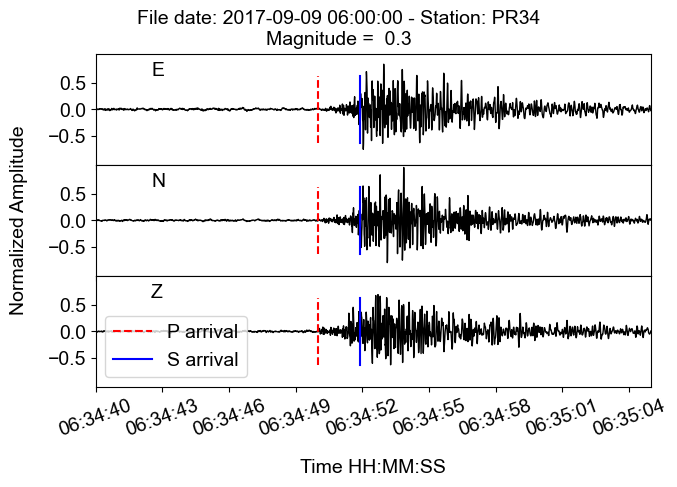

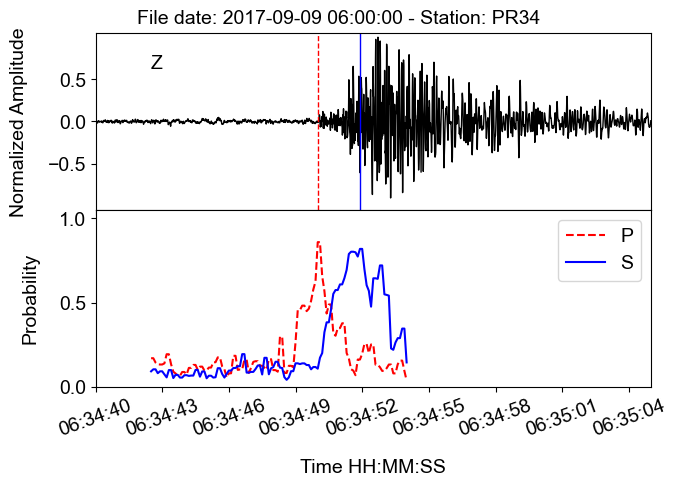

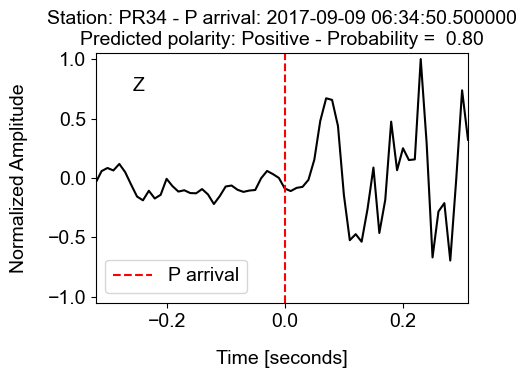


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000results_PR34_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000

___________________________________________

Detected event window indices: [23773, 23774, 23775, 23776, 23777]
Continuity check result: True

____________ Event: 3 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.81 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 237ms/step
Time elapsed: 0.65 seconds

4) Results
Result:
P-arrival: 2017-09-09T06:39:45.200000Z
S-arrival: 2017-09-09T06:39:46.200000Z
Magnitude: 1.0
Polarity: Negative (Probability: 0.992)


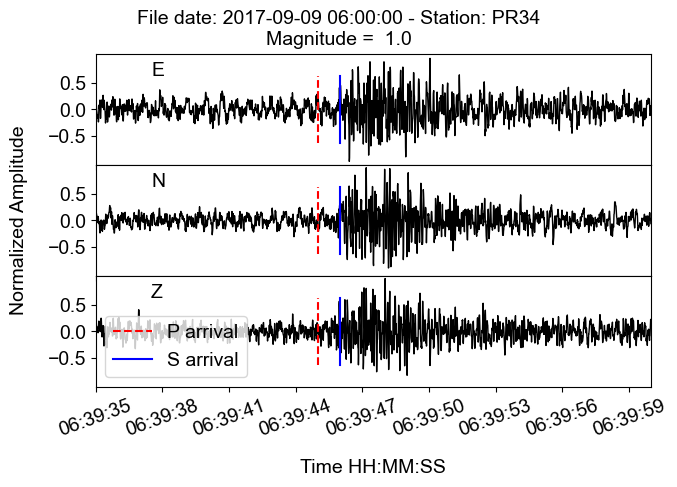

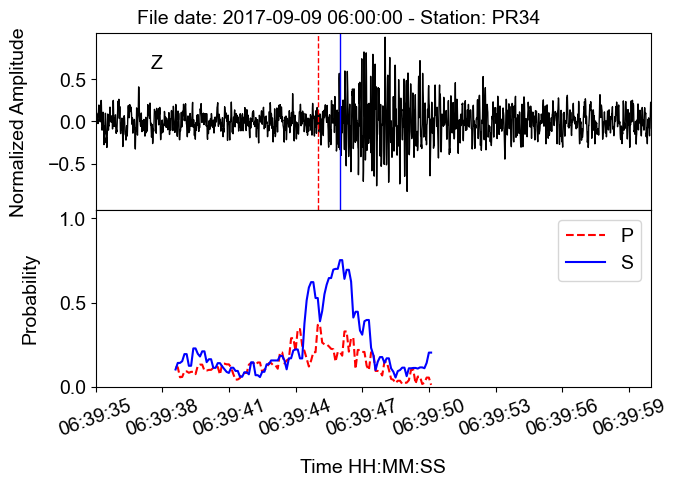

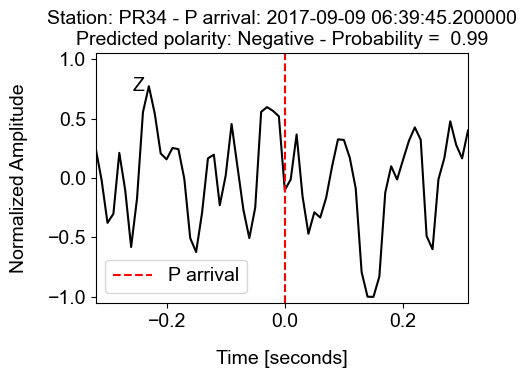


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000results_PR34_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000

___________________________________________

Detected event window indices: [24537, 24538, 24539, 24540, 24541]
Continuity check result: True

____________ Event: 4 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.91 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 310ms/step
Time elapsed: 0.88 seconds

4) Results
Result:
P-arrival: 2017-09-09T06:41:01.900000Z
S-arrival: 2017-09-09T06:41:02.200000Z
Magnitude: 0.30000001192092896
Polarity: Positive (Probability: 1.000)


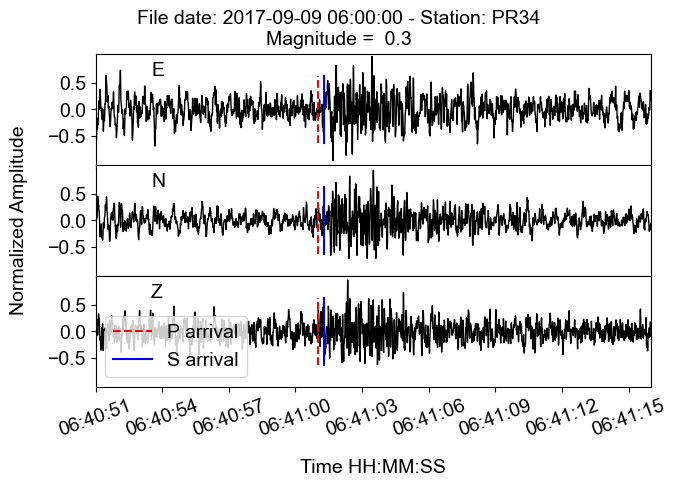

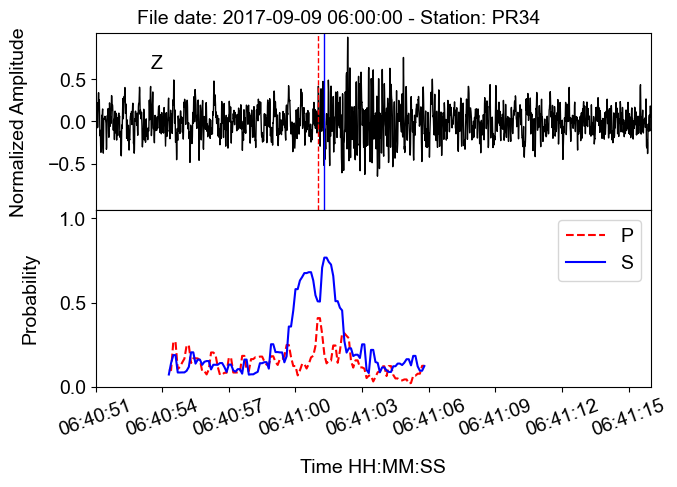

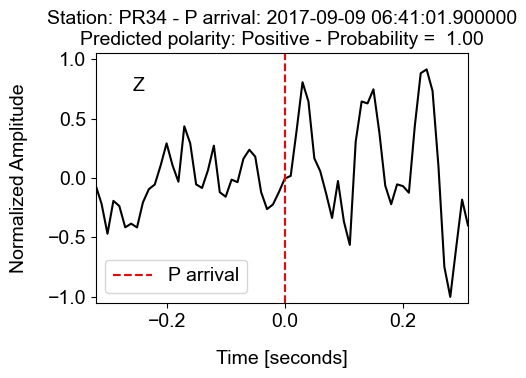


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000results_PR34_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000

___________________________________________

Detected event window indices: [26863, 26864, 26865, 26866, 26867]
Continuity check result: True

____________ Event: 5 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.83 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 278ms/step
Time elapsed: 0.83 seconds

4) Results
Result:
P-arrival: 2017-09-09T06:44:55.400000Z
S-arrival: 2017-09-09T06:44:57.400000Z
Magnitude: -0.0
Polarity: Positive (Probability: 1.000)


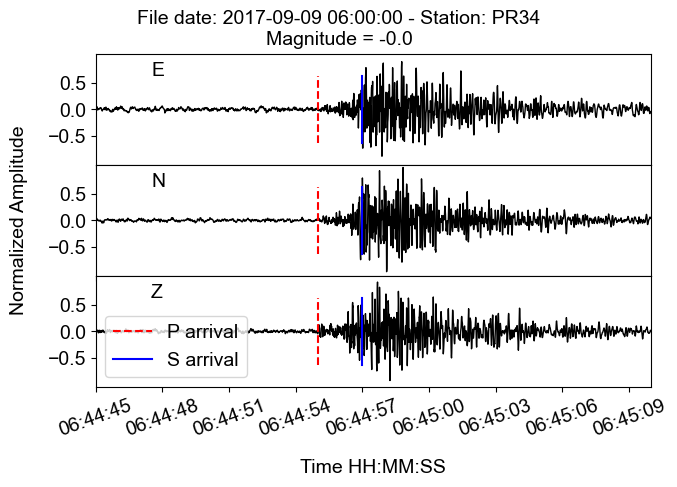

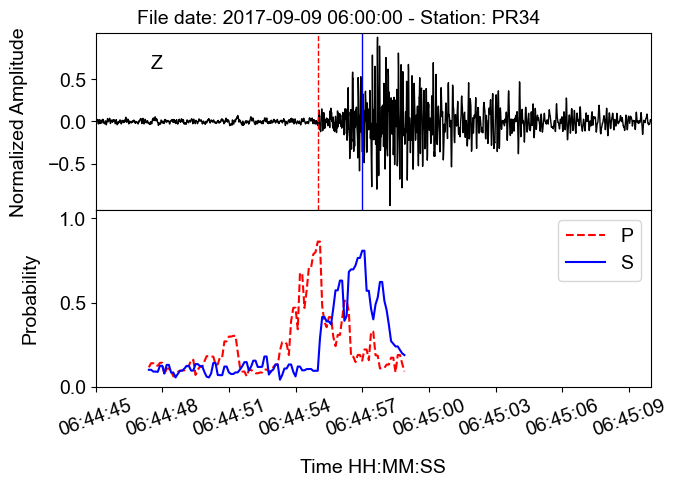

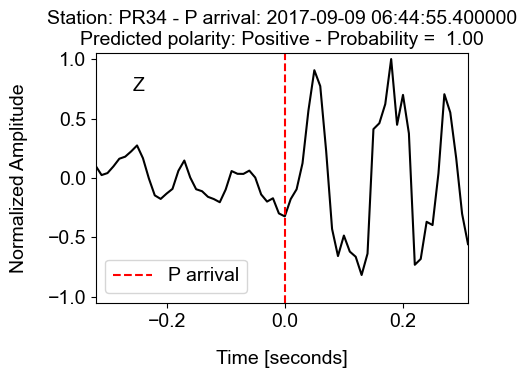


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000results_PR34_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000

___________________________________________

Detected event window indices: [27121, 27122, 27123, 27124, 27125]
Continuity check result: True

____________ Event: 6 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.91 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 240ms/step
Time elapsed: 0.66 seconds

4) Results
Result:
P-arrival: 2017-09-09T06:45:21.700000Z
S-arrival: 2017-09-09T06:45:23.300000Z
Magnitude: 2.4000000953674316
Polarity: Positive (Probability: 0.980)


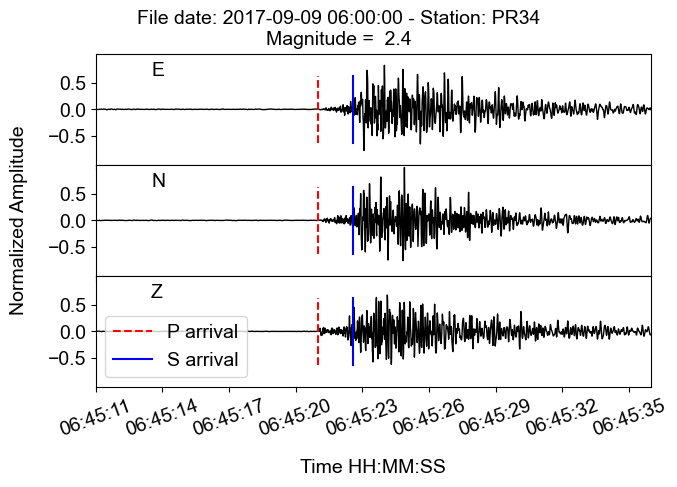

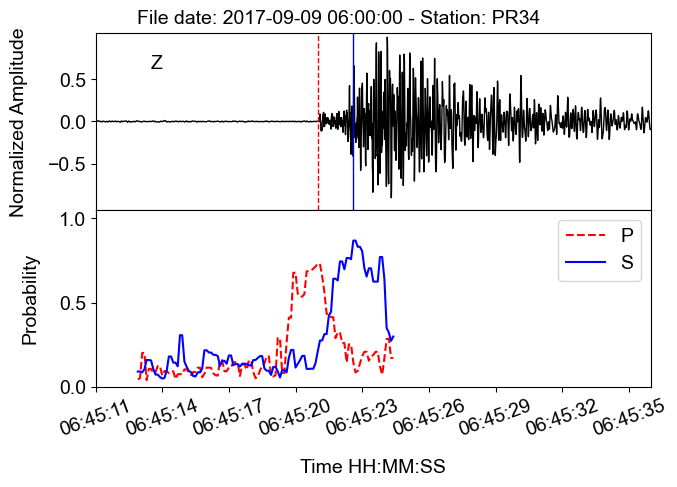

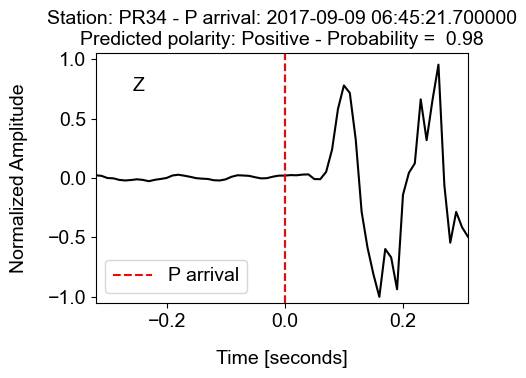


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000results_PR34_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000

___________________________________________

Detected event window indices: [29212, 29216, 29218, 29219, 29220]
Continuity check result: False
No events detected till 2017-09-09T06:48:40.600000Z

___________________________________________

Detected event window indices: [29216, 29218, 29219, 29220, 29221]
Continuity check result: False
No events detected till 2017-09-09T06:48:40.800000Z

___________________________________________

Detected event window indices: [29218, 29219, 29220, 29221, 29222]
Continuity check result: True

____________ Event: 7 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.05 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 232ms/step
Time elapsed: 0.75 seconds

4) Results
Result:
P-arrival: 2017-

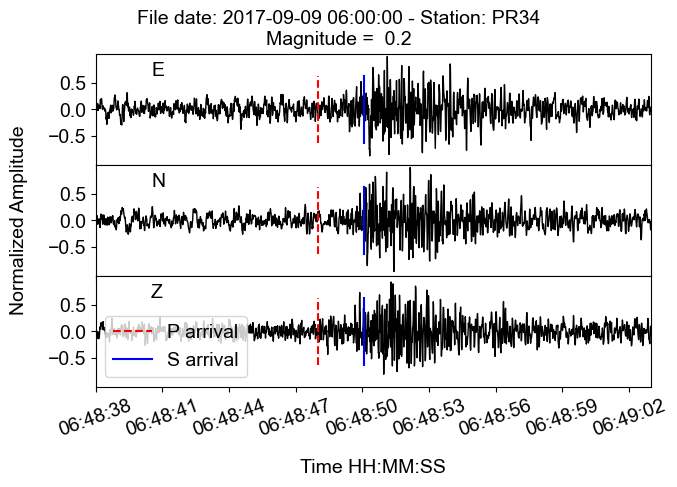

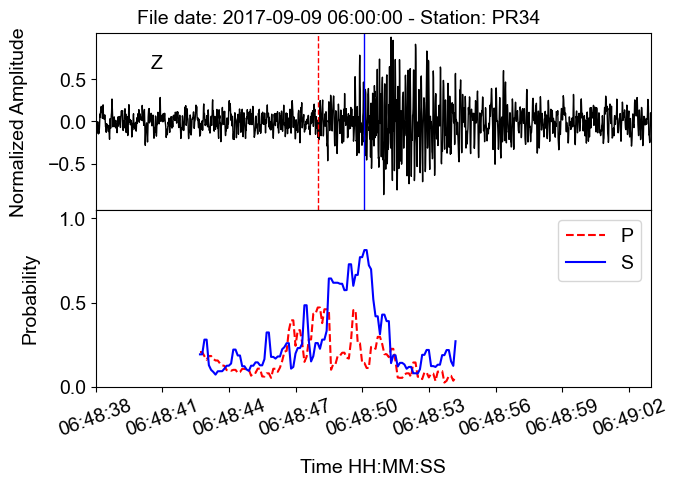

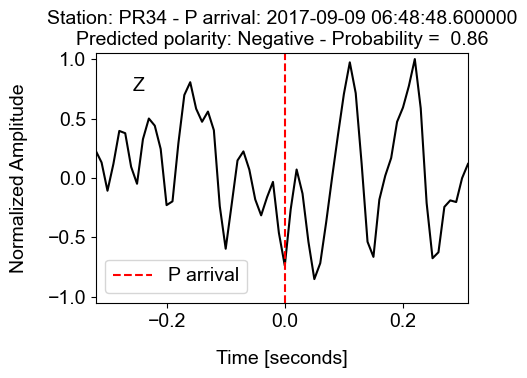


Saving results in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000results_PR34_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR34/20170909_060000
Analysis completed. No more events detected.
Total time elapsed: 775.77 seconds

** Reading data: station PR44, date 2017-09-09 06:00:00... **

** Preprocessing data... **
Time elapsed: 0.14470481872558594 

** Monitoring data... **
Earthquake scan time window: 15 seconds
Stepsize for detection: 10 samples
Earthquake detected with 5 consecutive positive detections
Stepsize for picking: 10 samples

1) Running Creime_rt for event detection and magnitude


/Volumes/GUAN_YIN/SAIPy_Network_Paper/SAIPy_network/venv_saipy/lib/python3.8/site-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


141/141 [==============================] - 511s 4s/step
Time elapsed: 526.52 seconds
Number of detected earthquake windows: 289

___________________________________________

Detected event window indices: [20817, 20818, 20819, 20820, 20821]
Continuity check result: True

____________ Event: 1 _____________

2) Running DynaPicker for phase picking
Time elapsed: 24.21 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 275ms/step
Time elapsed: 0.89 seconds

4) Results
Result:
P-arrival: 2017-09-09T06:34:50.800000Z
S-arrival: 2017-09-09T06:34:52.600000Z
Magnitude: 1.100000023841858
Polarity: Positive (Probability: 1.000)


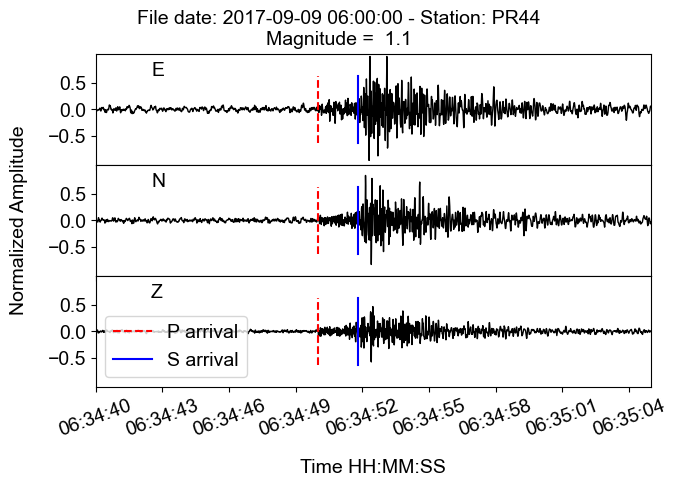

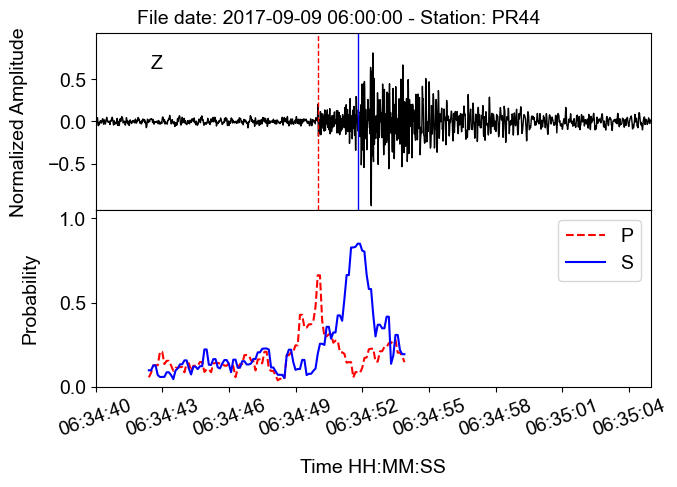

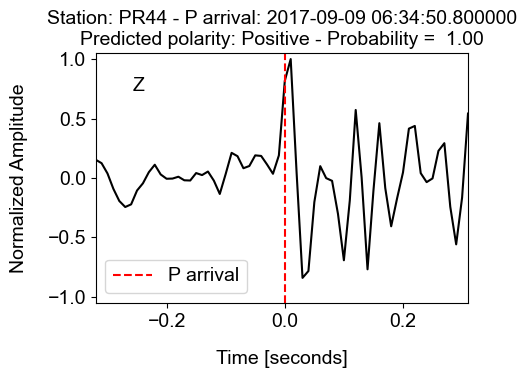


Saving results in ../results/test_network_2025-08-19_11-21-37/PR44/20170909_060000results_PR44_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR44/20170909_060000

___________________________________________

Detected event window indices: [26880, 26881, 26882, 26883, 26884]
Continuity check result: True

____________ Event: 2 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.63 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 366ms/step
Time elapsed: 0.75 seconds

4) Results
Result:
P-arrival: 2017-09-09T06:44:55.500000Z
S-arrival: 2017-09-09T06:44:57.800000Z
Magnitude: 0.4000000059604645
Polarity: Positive (Probability: 1.000)


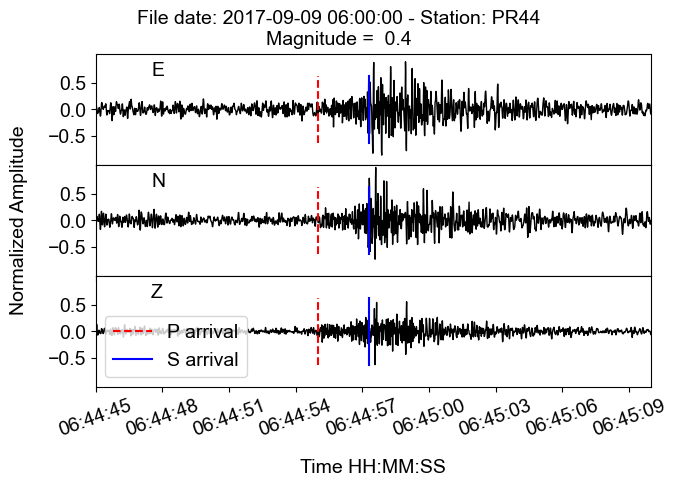

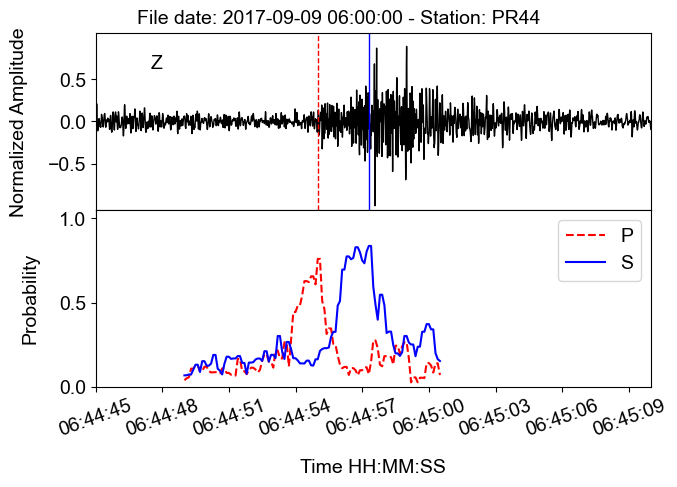

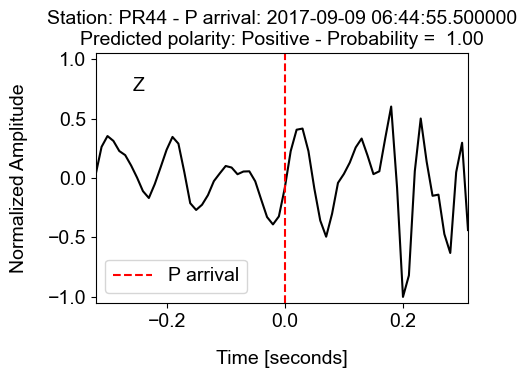


Saving results in ../results/test_network_2025-08-19_11-21-37/PR44/20170909_060000results_PR44_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR44/20170909_060000

___________________________________________

Detected event window indices: [27123, 27124, 27125, 27126, 27127]
Continuity check result: True

____________ Event: 3 _____________

2) Running DynaPicker for phase picking
Time elapsed: 14.06 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 251ms/step
Time elapsed: 0.66 seconds

4) Results
Result:
P-arrival: 2017-09-09T06:45:22.000000Z
S-arrival: 2017-09-09T06:45:23.700000Z
Magnitude: 2.299999952316284
Polarity: Positive (Probability: 1.000)


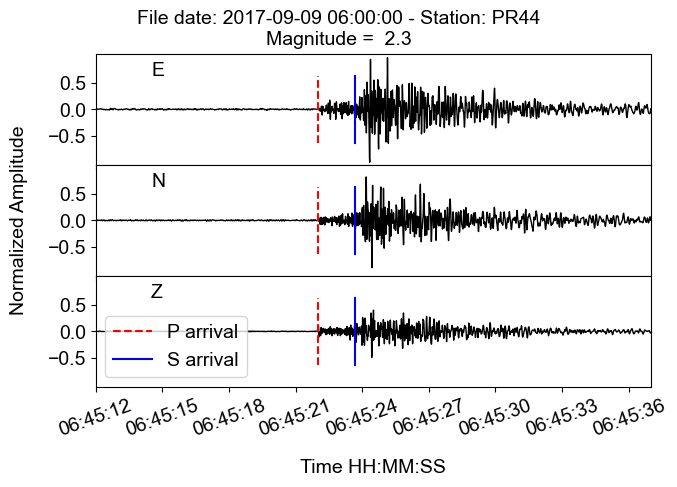

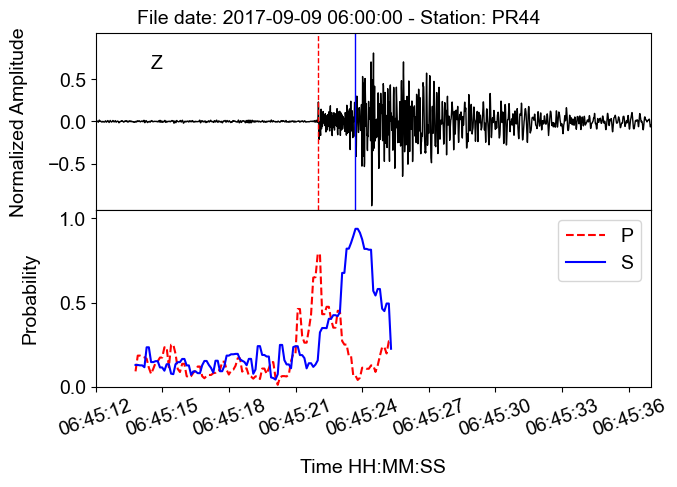

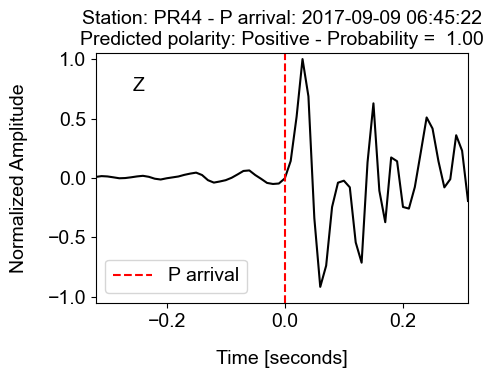


Saving results in ../results/test_network_2025-08-19_11-21-37/PR44/20170909_060000results_PR44_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR44/20170909_060000

___________________________________________

Detected event window indices: [29244, 29272, 29274, 29276, 29278]
Continuity check result: False
No events detected till 2017-09-09T06:48:46.200000Z

___________________________________________

Detected event window indices: [29272, 29274, 29276, 29278, 29282]
Continuity check result: False
No events detected till 2017-09-09T06:48:46.400000Z
Total time elapsed: 589.17 seconds

** End of Single-station monitoring: station PR44, date 2017-09-09 06:00:00. *******************************



In [7]:
# Loading, Pre-pocessing, and Analysis station by station
output_by_station = make_monitor_multistations(dirdata, dir_stat_name, station_list, channels, time_dict, format,
                              device, lw, dw, dirmodel, dirwork, dirout, save_result=True)

# to preserve the original output (just in case)
sigle_results = output_by_station.copy()

### * *The follow part is Only in case of adding*
###   *more stations and/or days,time to the input* (example):


** Reading data: station PR15, date 2017-09-08 17:00:00... **

** Preprocessing data... **
Time elapsed: 0.17995977401733398 

** Monitoring data... **
Earthquake scan time window: 15 seconds
Stepsize for detection: 10 samples
Earthquake detected with 5 consecutive positive detections
Stepsize for picking: 10 samples

1) Running Creime_rt for event detection and magnitude


/Volumes/GUAN_YIN/SAIPy_Network_Paper/SAIPy_network/venv_saipy/lib/python3.8/site-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


141/141 [==============================] - 602s 4s/step
Time elapsed: 613.36 seconds
Number of detected earthquake windows: 243

___________________________________________

Detected event window indices: [9716, 9717, 9718, 9719, 9720]
Continuity check result: True

____________ Event: 1 _____________

2) Running DynaPicker for phase picking
Time elapsed: 23.53 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 319ms/step
Time elapsed: 0.95 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:16:18.900000Z
S-arrival: 2017-09-08T17:16:19.200000Z
Magnitude: 0.699999988079071
Polarity: Negative (Probability: 0.925)


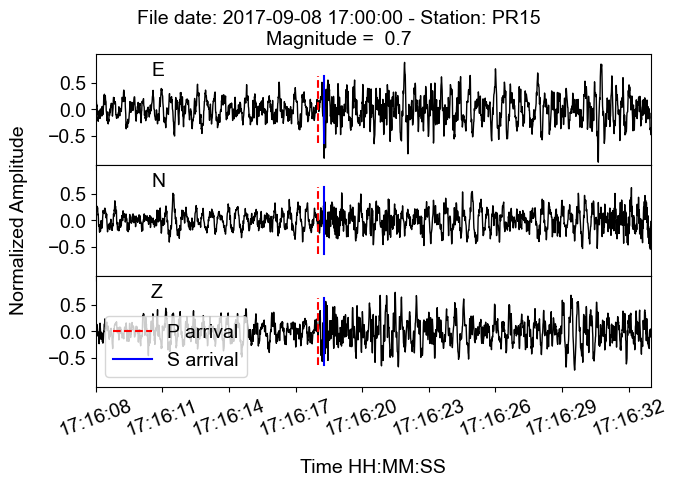

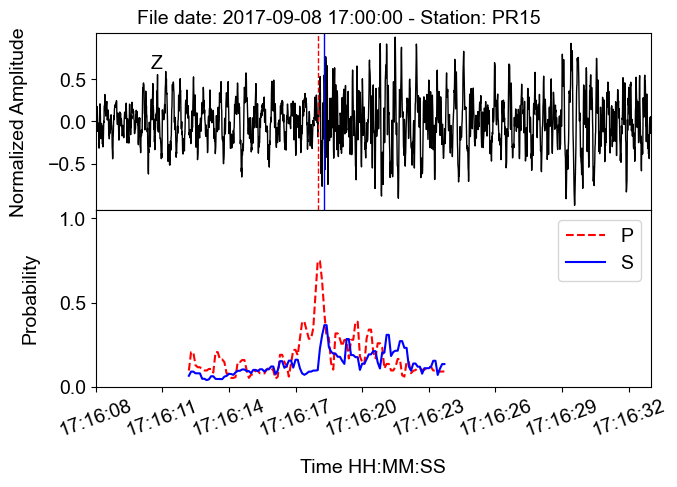

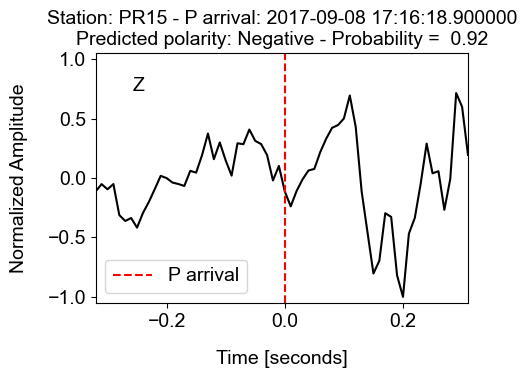


Saving results in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000results_PR15_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000

___________________________________________

Detected event window indices: [10288, 10289, 10290, 10291, 10292]
Continuity check result: True

____________ Event: 2 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.28 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 252ms/step
Time elapsed: 0.67 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:17:15.000000Z
S-arrival: 2017-09-08T17:17:17.300000Z
Magnitude: 0.0
Polarity: Positive (Probability: 0.513)


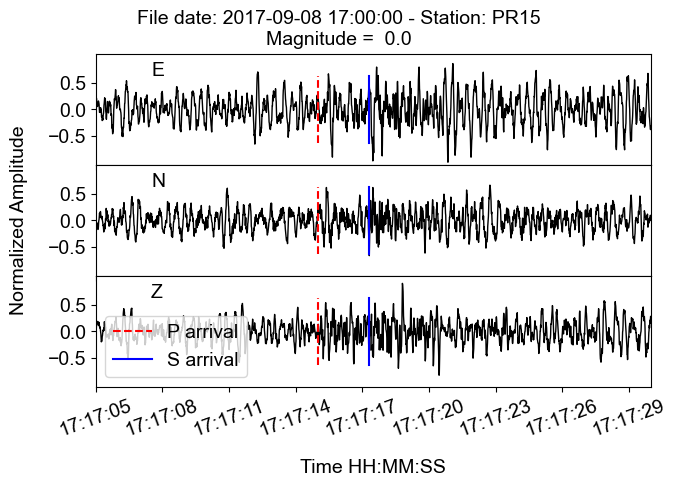

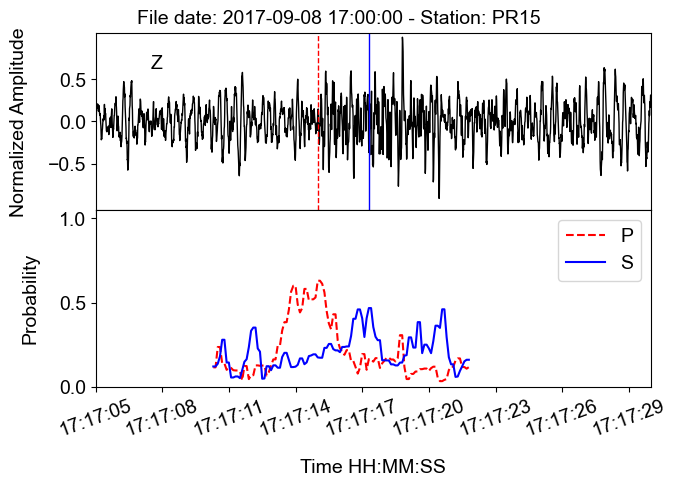

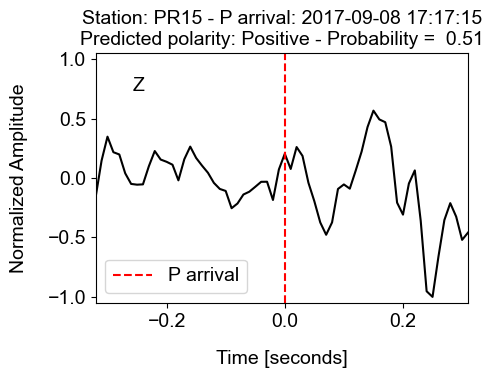


Saving results in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000results_PR15_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000

___________________________________________

Detected event window indices: [11432, 11433, 11434, 11435, 11436]
Continuity check result: True

____________ Event: 3 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.46 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 290ms/step
Time elapsed: 0.74 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:19:11.900000Z
S-arrival: 2017-09-08T17:19:14.300000Z
Magnitude: 0.20000000298023224
Polarity: Positive (Probability: 0.969)


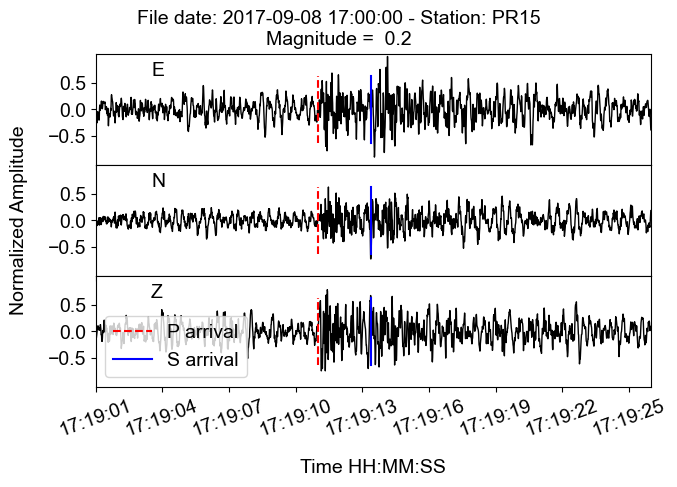

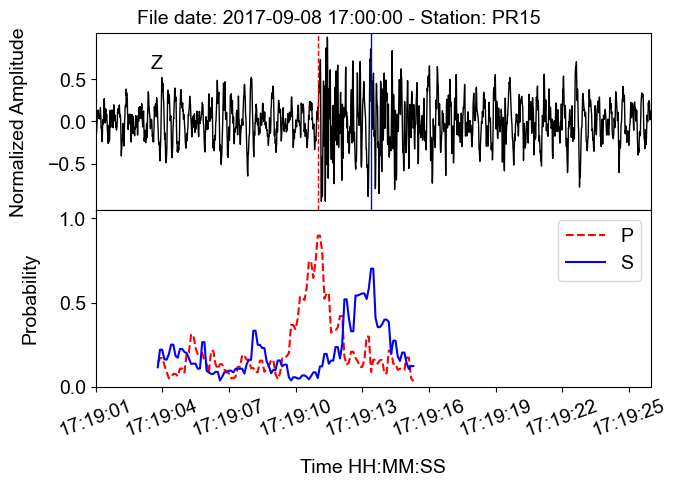

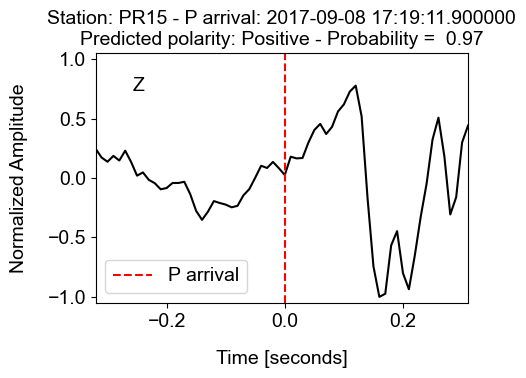


Saving results in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000results_PR15_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000

___________________________________________

Detected event window indices: [11954, 11955, 11956, 11957, 11958]
Continuity check result: True

____________ Event: 4 _____________

2) Running DynaPicker for phase picking
Time elapsed: 13.14 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 250ms/step
Time elapsed: 0.67 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:20:02.800000Z
S-arrival: 2017-09-08T17:20:05.100000Z
Magnitude: 2.4000000953674316
Polarity: Positive (Probability: 0.999)


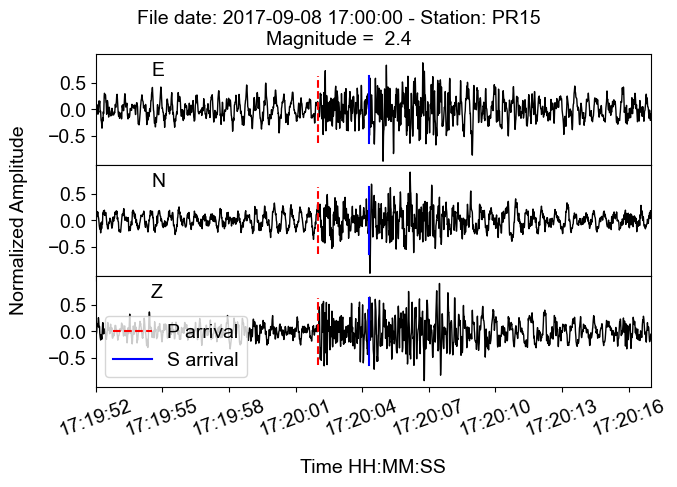

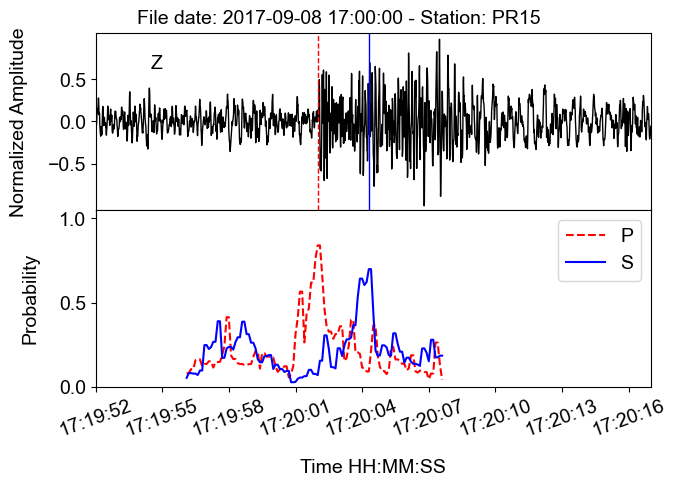

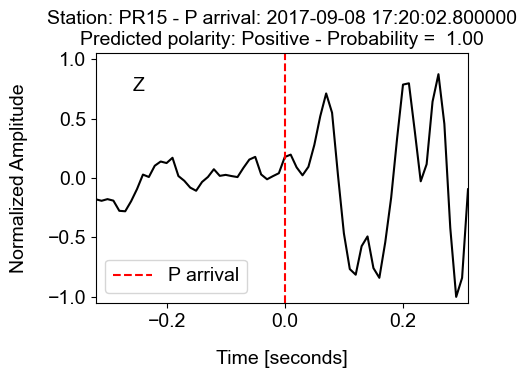


Saving results in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000results_PR15_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000

___________________________________________

Detected event window indices: [13927, 13930, 13931, 13932, 13933]
Continuity check result: False
No events detected till 2017-09-08T17:23:12.000000Z

___________________________________________

Detected event window indices: [13930, 13931, 13932, 13933, 13934]
Continuity check result: True

____________ Event: 5 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.51 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 238ms/step
Time elapsed: 0.69 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:23:18.100000Z
S-arrival: 2017-09-08T17:23:25.400000Z
Magnitude: 0.699999988079071
Polarity: Positive (Probability: 1.000)


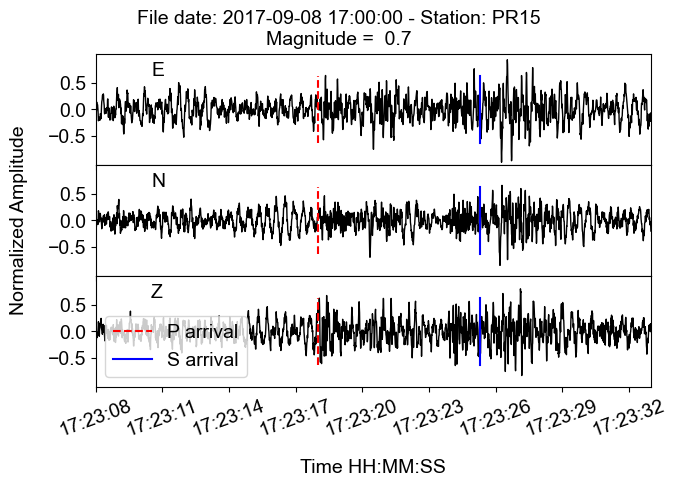

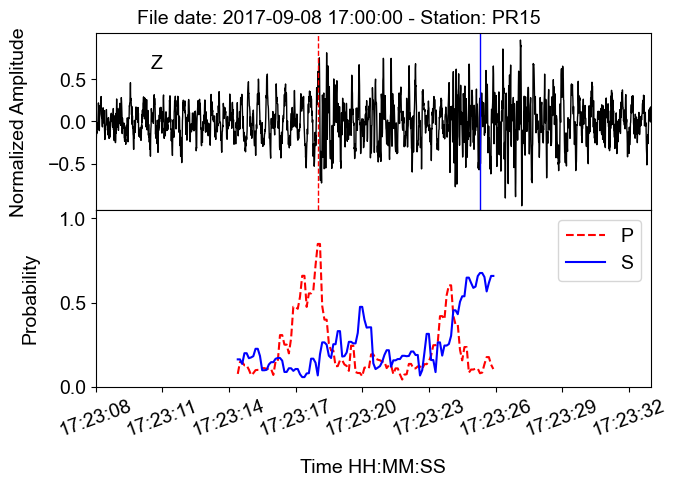

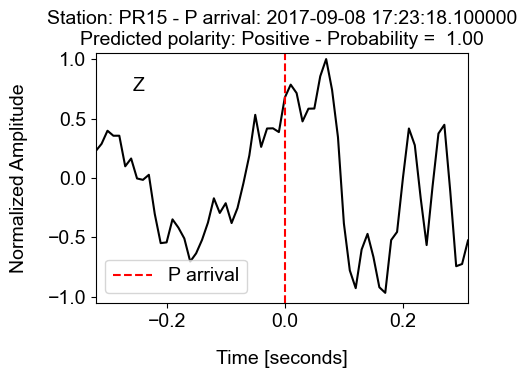


Saving results in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000results_PR15_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000

___________________________________________

Detected event window indices: [31427, 31428, 31429, 31430, 31431]
Continuity check result: True

____________ Event: 6 _____________

2) Running DynaPicker for phase picking
Time elapsed: 12.78 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 237ms/step
Time elapsed: 0.68 seconds

4) Results
Result:
P-arrival: 2017-09-08T17:52:29.800000Z
S-arrival: 2017-09-08T17:52:35.100000Z
Magnitude: 0.5
Polarity: Negative (Probability: 0.851)


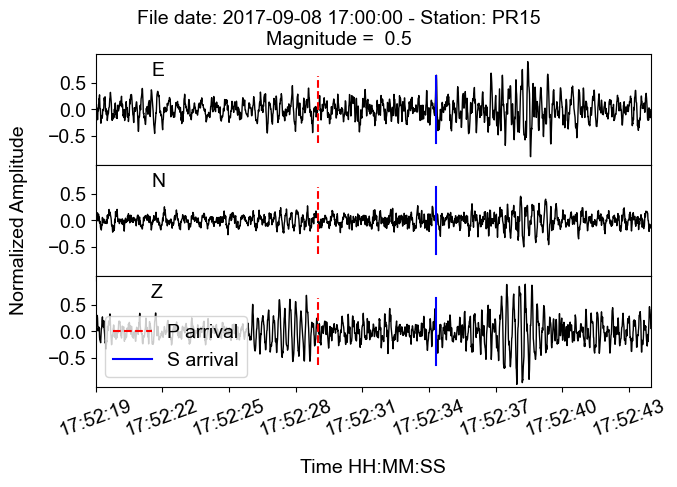

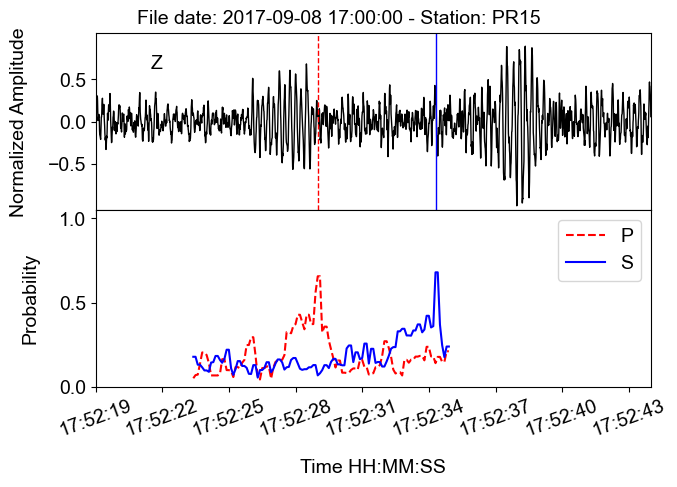

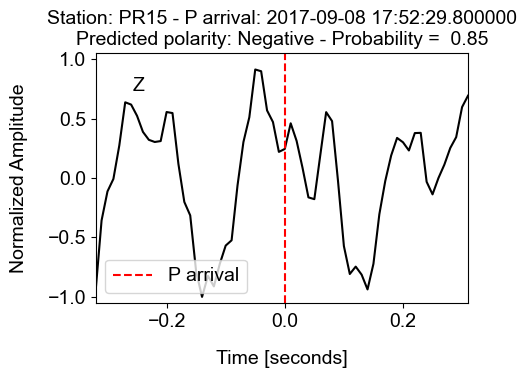


Saving results in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000results_PR15_20170908_170000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR15/20170908_170000
Analysis completed. No more events detected.
Total time elapsed: 736.82 seconds

** End of Single-station monitoring: station PR15, date 2017-09-08 17:00:00. *******************************


** Reading data: station PR15, date 2017-09-08 19:00:00... **

** Preprocessing data... **
Time elapsed: 0.1544482707977295 

** Monitoring data... **
Earthquake scan time window: 15 seconds
Stepsize for detection: 10 samples
Earthquake detected with 5 consecutive positive detections
Stepsize for picking: 10 samples

1) Running Creime_rt for event detection and magnitude


/Volumes/GUAN_YIN/SAIPy_Network_Paper/SAIPy_network/venv_saipy/lib/python3.8/site-packages/keras/src/initializers/initializers.py:120: UserWarning: The initializer GlorotNormal is unseeded and being called multiple times, which will return identical values each time (even if the initializer is unseeded). Please update your code to provide a seed to the initializer, or avoid using the same initializer instance more than once.
  warnings.warn(


141/141 [==============================] - 517s 4s/step
Time elapsed: 528.52 seconds
Number of detected earthquake windows: 0
No events detected
Total time elapsed: 528.54 seconds

** End of Single-station monitoring: station PR15, date 2017-09-08 19:00:00. *******************************


** Reading data: station PR15, date 2017-09-09 06:00:00... **

** Preprocessing data... **
Time elapsed: 0.5346989631652832 

** Monitoring data... **
Earthquake scan time window: 15 seconds
Stepsize for detection: 10 samples
Earthquake detected with 5 consecutive positive detections
Stepsize for picking: 10 samples

1) Running Creime_rt for event detection and magnitude
141/141 [==============================] - 514s 4s/step
Time elapsed: 527.73 seconds
Number of detected earthquake windows: 183

___________________________________________

Detected event window indices: [20809, 20810, 20811, 20812, 20813]
Continuity check result: True

____________ Event: 1 _____________

2) Running DynaPicker for

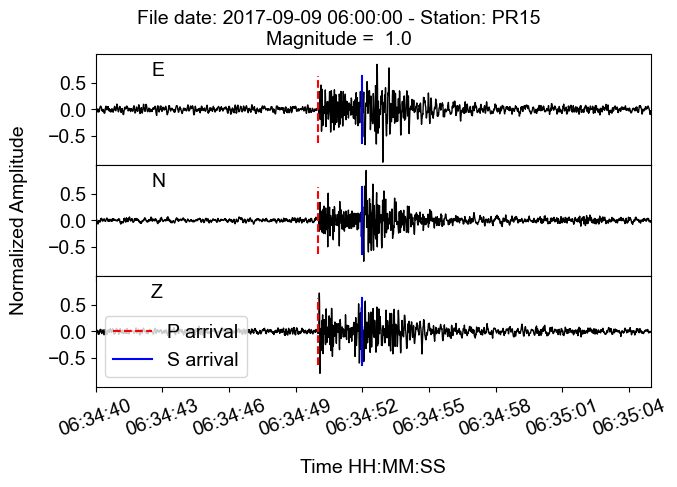

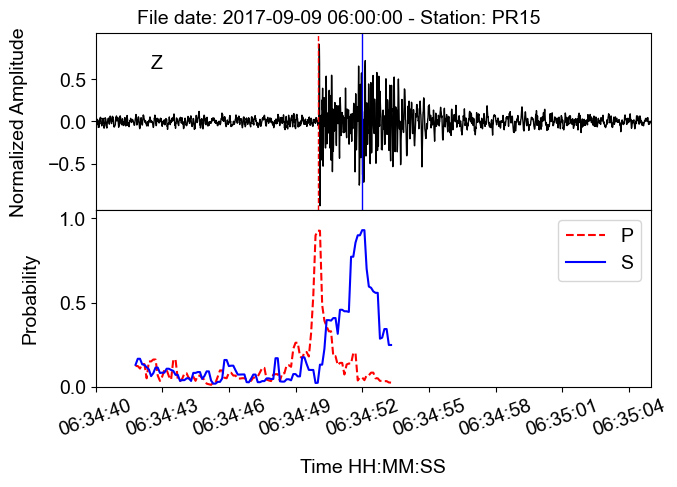

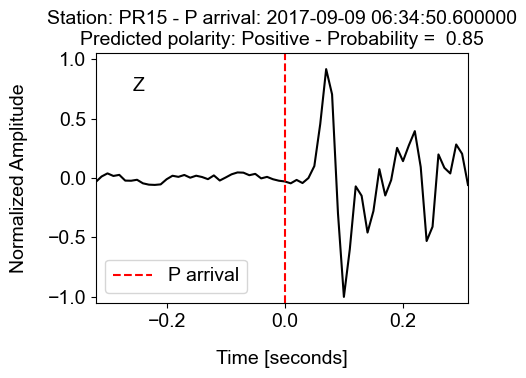


Saving results in ../results/test_network_2025-08-19_11-21-37/PR15/20170909_060000results_PR15_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR15/20170909_060000

___________________________________________

Detected event window indices: [27121, 27122, 27123, 27124, 27125]
Continuity check result: True

____________ Event: 2 _____________

2) Running DynaPicker for phase picking
Time elapsed: 15.95 seconds

3) Running PolarCAP for polarity estimation
1/1 [==============================] - 0s 363ms/step
Time elapsed: 0.86 seconds

4) Results
Result:
P-arrival: 2017-09-09T06:45:21.700000Z
S-arrival: 2017-09-09T06:45:23.800000Z
Magnitude: 2.5
Polarity: Negative (Probability: 0.997)


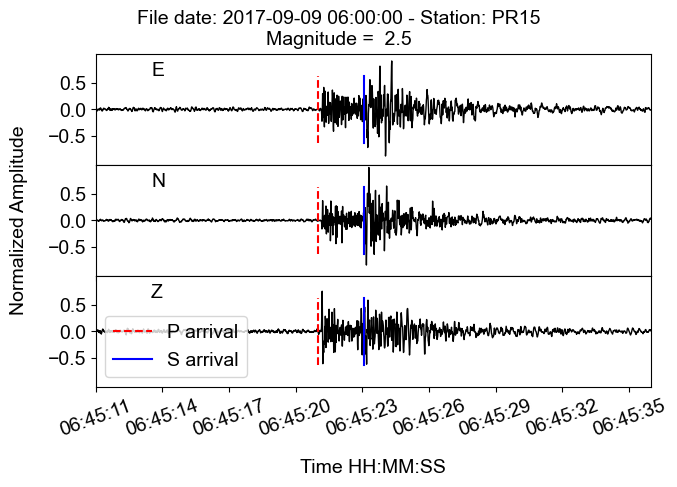

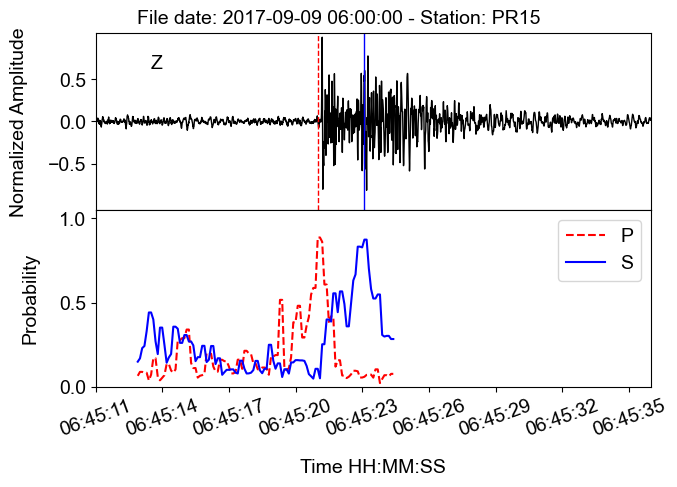

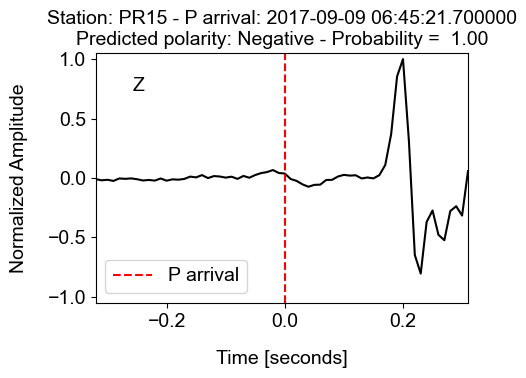


Saving results in ../results/test_network_2025-08-19_11-21-37/PR15/20170909_060000results_PR15_20170909_060000.csv

Saving plots in ../results/test_network_2025-08-19_11-21-37/PR15/20170909_060000
Analysis completed. No more events detected.
Total time elapsed: 584.28 seconds

** End of Single-station monitoring: station PR15, date 2017-09-09 06:00:00. *******************************



In [8]:
# Example: Adding data of another station:

station_list_extra = ['PR15']
dir_stat_name_extra = ['PR15_data']
time_dict_extra = {"20170908": ["170000","190000"],
             "20170909": ["060000"],
            }

# Start the processing function
extra_output_by_station = make_monitor_multistations(dirdata, dir_stat_name_extra, station_list_extra,
                                                     channels, time_dict_extra, format, 
                                                     device, lw, dw,
                                                     dirmodel, dirwork, dirout,
                                                     save_result=True)

# Include the extra data in dictionaries and lists:

def merge_dict(d1, d2):
    for key, value in d2.items():
        if key not in d1:
            d1[key] = value
        elif isinstance(d1[key], dict) and isinstance(value, dict):
            merge_dict(d1[key], value)
        # If it exists and is not a dictionary, doesn't overwrite it
    return d1
    

sigle_results = merge_dict(sigle_results, extra_output_by_station)
time_dict = merge_dict(time_dict,time_dict_extra)
station_list.extend(station_list_extra)
dir_stat_name.extend(dir_stat_name_extra)

## $(\mathrm{v})$ Multiple-stations process

In [ ]:
# Parameters
# For network detection.
dt = 3 # maximum time difference of p-wave arrival between stations
minst = 3 #minimum stations required for detecting events


Results for 20170908_170000: 4 events

CSV file 'Events_20170908_170000_output.csv' successfully updated.


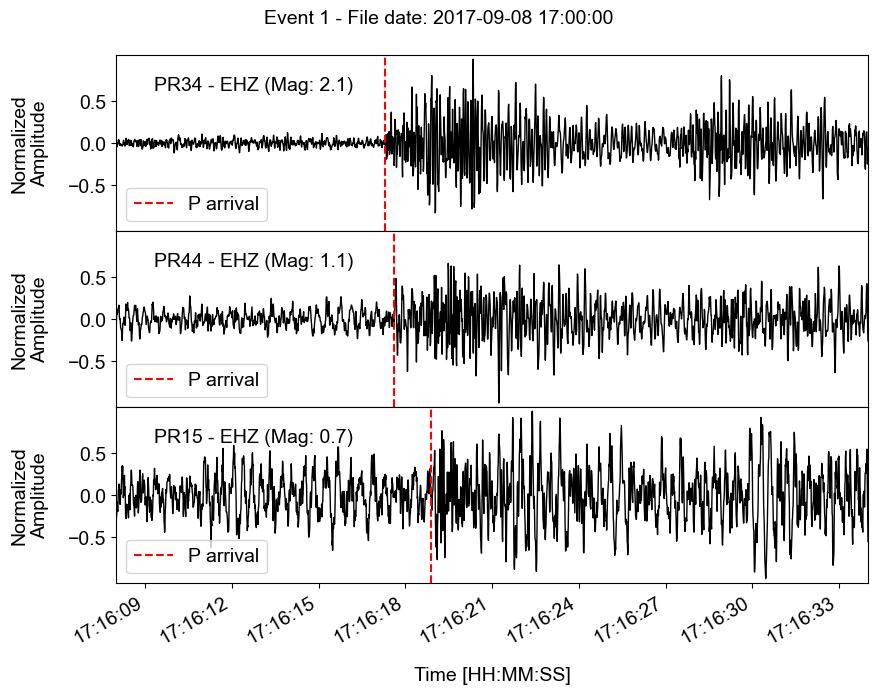

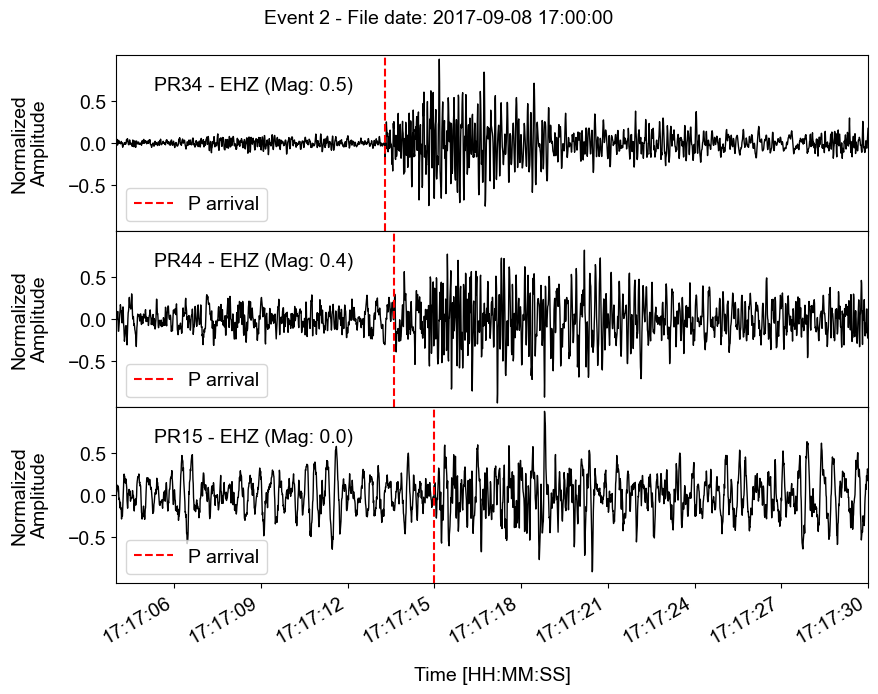

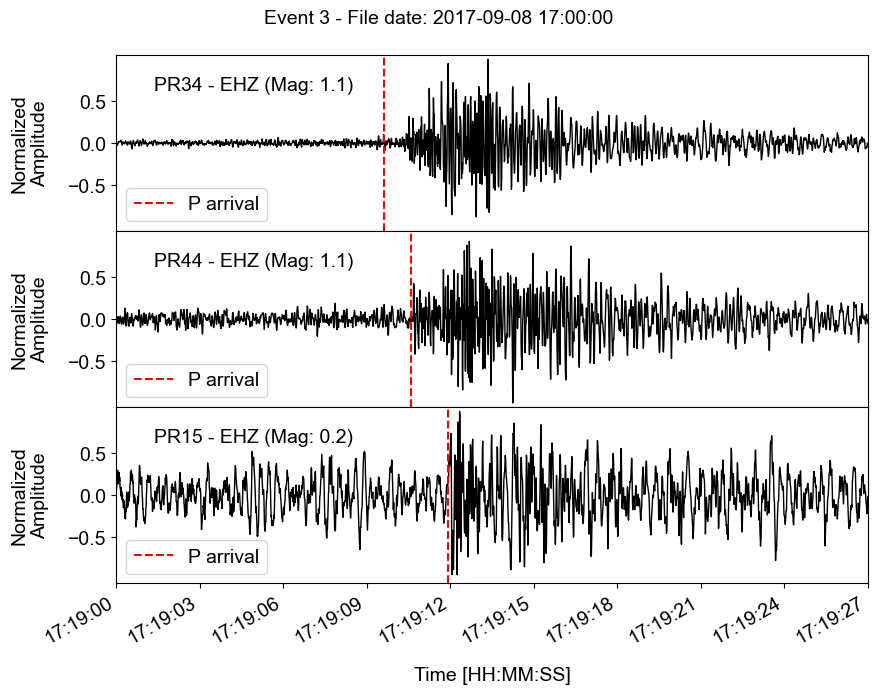

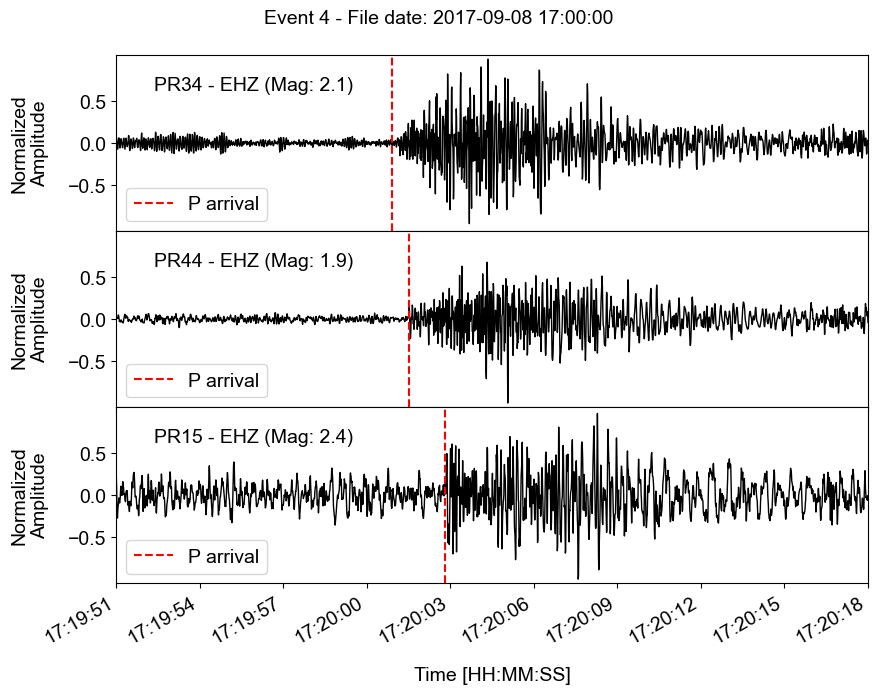


*No events for 20170908_190000*

Results for 20170909_060000: 2 events

CSV file 'Events_20170909_060000_output.csv' successfully updated.


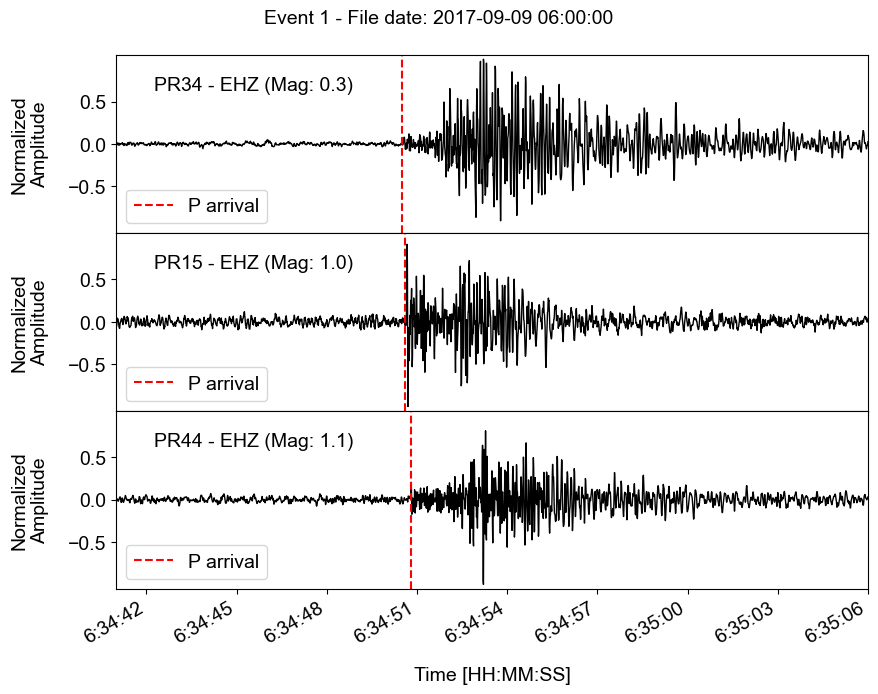

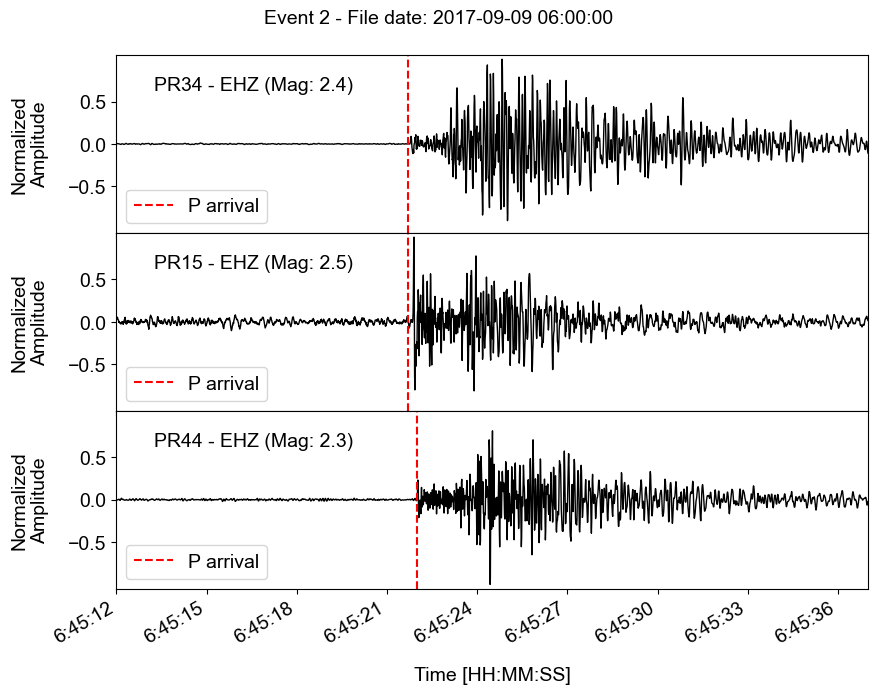

In [12]:
clusters_for_plotting, all_detect_ev = network_detect(sigle_results, dirdata, station_list, dir_stat_name,
                                                      channel='Z', format=format, min_stat=minst, delta_t=dt,
                                                      time_and_pattern=True,
                                                      save_result=True, path_out=dirout)

# channel name for plots --> vertical channel (e.g. 'Z')
# channel='' (empty), when the 3 components are in the same file.
# For Simple time_difference detections associations set time_and_pattern=False

## $(\mathrm{iv})$  Save readme

In [9]:
# Create a Readme file with key process parameters.
formatted_time_dict = "\n    ".join(
    [f"{key}: {values}" for key, values in time_dict.items()]
)

readme_content = f"""# SAIPy. Data Processing Pipeline Creime_RT-DynaPicker-PolarCap for seismic network

## Overview
This README provides key process parameters for the data processing pipeline.

## Process Parameters
- **Date of the data**:
    * Date and hours:
    {formatted_time_dict}
- **Stations names**: {station_list}
- **Processing time window length per Earthquake (seconds)**: {lw}
- **N consecutive positive outputs of Creime_RT to confirm the detection in a station**: {dw}
- **Maximum time difference of p-wave arrival between stations for cluster events (seconds)**: {dt}

"""

# Save to README.md
with open(os.path.join(dirout,'README.md'), 'w') as file:
    file.write(readme_content)

## $(\mathrm{vi})$ Examples of customized plots

### *Single-station Monitoring*

In [ ]:
# Necessary previous variables : station_list, dirdata, time_dict, format, comp, lw, sampling, output_by_station

# Load data
station_id = 'PR43' #station_list[index_stat]
dir_station = 'PR43_data' # name of the station folder
dirstat = os.path.join(dirdata,f"{dir_station}/")
day = '20170909'
stime = '060000'
day_time = f"{day}_{stime}"

stream = load_streams(dirstat, station_id, day_time, format, channels)
_, prepro_wave_array = preprocessing(stream)

In [ ]:
# From results
index = 2 # detection index
data_inf = output_by_station[day_time][station_id]
p_pick = data_inf['P_picks'][index]
s_pick = data_inf['S_picks'][index]
init_ref_pick = data_inf['init_window'][index]
prob_p = data_inf['picks_prob'][index][0]
prob_s = data_inf['picks_prob'][index][1]
mag_pred = data_inf['magnitudes'][index]
polarity = data_inf['polarities'][index]

In [ ]:
# Visualization parameters
# (100Hz sampling rate)
plot_range = np.arange(
    max(0, p_pick - 300 ),
    min(len(prepro_wave_array), p_pick + 700)
)

dat = prepro_wave_array[plot_range, :]

date_utc, _ = date_format_object(day=day, time=stime)
starttime_str = date_utc.strftime("%Y-%m-%d %H:%M:%S")

In [ ]:
fig1 = plot_data(dat, station_id, date_utc, starttime_str, samples=plot_range,
                     P_arr=p_pick, S_arr=s_pick, magnitude=mag_pred)
# By default samples=None for X ticks in samples 

In [ ]:
# Save plot
fig1.savefig(os.path.join(dirout,f"{station_id}_Ev{index+1}_zoomin.pdf"), bbox_inches='tight')

In [ ]:
fig2 = plot_dynapicker_output(dat[:,2], station_id, date_utc, starttime_str,
                              prob_p, prob_s, p_pick, s_pick,
                              samples=plot_range, timepr0=init_ref_pick)
# By default samples=None for X ticks in samples

fig3 = plot_polarcap_output(prepro_wave_array[:][:, 2], station_id, date_utc,
                          p_pick, y_pred=polarity)

# savefig to save plots fig2 and fig3

### *Overview all picks - all the statios*

In [ ]:
day_itime = '20170909_060000'

clusters_for_date = [entry['cluster'] for entry in clusters_for_plotting if entry['date_key'] == day_itime]
if len(clusters_for_date[0])!=0:
    clusters = clusters_for_date[0]
    path_datek_out = f"{dirout}Events_by_network/{day_itime}/"
    # chn --> vertical channel (e.g. 'Z')
    fig_all = plot_overview(all_detect_ev, day_itime, clusters, dirdata, format, chn='Z',
                        p_arrival=True, s_arrival=False, filter=False)# fmin=0.01, fmax=0.8,
else:
    print(f"No Clusters in {day_itime}")

In [ ]:
# Save plot
file_name = f"{day_itime}_no_filter.pdf"
fig_all.savefig(os.path.join(dirout,file_name), bbox_inches='tight')

### *Plot of a specific event (cluster_index) and date*

In [ ]:
day_itime = '20170909_060000' # day and start time of the original file data
cluster_index = 1  # Index of the cluster you want
clusters_for_date = [entry['cluster'] for entry in clusters_for_plotting if entry['date_key'] == day_itime]
n_clusters = len(clusters_for_date[0])
if clusters_for_date and cluster_index < n_clusters:
    cluster = [clusters_for_date[0][cluster_index]][0]
    #p, s, station, idx, start_time, mag
    detections_for_date = next(detections for key, detections in all_detect_ev if key == day_itime)
    
    fig_cluster = plot_multi_stations(detections_for_date, day_itime,
                                      cluster, cluster_index, dirdata, format, chn='Z',
                                      t_before=10, t_after=15,
                                      p_arrival=True, s_arrival=True, mag_legd=True)
    # chn --> vertical channel (e.g. 'Z')
else:
    print(f"No Cluster {cluster_index} in {day_itime}")

In [ ]:
# save plot
path_datek_out = f"{dirout}Events_by_network/{day_itime}/"
subnm_fileplt = '_bp_1_45_closeup'
fig_cluster.savefig(f"{path_datek_out}/Event_{cluster_index+1}_{date_key}{subnm_fileplt}.pdf", bbox_inches='tight')

### *Plots for all the events of an specific day-time file*

In [ ]:
day_itime = '20170909_060000' # day and start time of the original file data
clusters_for_date = [entry['cluster'] for entry in clusters_for_plotting if entry['date_key'] == day_itime]
if len(clusters_for_date)!=0:
    clusters = clusters_for_date[0]
    path_datek_out = f"{dirout}Events_by_network/{day_itime}/"
    subnm_fileplt = '_closeup'
    #p, s, station, idx, start_time, mag
    detections_for_date = next(detections for key, detections in all_detect_ev if key == day_itime)
    
    # Iterate through the clusters and fetch the corresponding signals
    for i_cl, cluster in enumerate(clusters):
        fig_cluster = plot_multi_stations(detections_for_date, day_itime,
                            cluster, i_cl, dirdata, station_list, dir_stat_name, format, chn='Z',
                            t_before=5, t_after=10, p_arrival=True, s_arrival=True, mag_legd=True)
        # chn --> vertical channel (e.g. 'Z')

        # if save:        
        #fig_cluster.savefig(f"{path_datek_out}/Event_{i_cl+1}_{date_key}{subnm_fileplt}.pdf", bbox_inches='tight')
else:
    print(f"No Clusters in {day_itime}")

## $(\mathrm{vii})$ Magnitude Statistics

In [13]:
def statistics(path, date_k):
    
    df = pd.read_csv(os.path.join(path, f"Events_{date_k}_output.csv"), header=0)

    df.columns = ['event_id', 'col2', 'col3', 'col4', 'col5', 'p_utc', 'col7', 'magnitude', 'col9']

    df = df[['event_id', 'p_utc', 'magnitude']]

    df['magnitude'] = pd.to_numeric(df['magnitude'], errors='coerce')
    df['p_utc'] = pd.to_datetime(df['p_utc'], errors='coerce')
    df = df.dropna(subset=['magnitude', 'p_utc'])

    grouped_stats = df.groupby('event_id').agg(
        earliest_p_utc=('p_utc', 'min'),
        mag_mean=('magnitude', 'mean'),
        std=('magnitude', 'std'),
        n_stations=('magnitude', 'count')
    )

    grouped_stats[['mag_mean', 'std']] = grouped_stats[['mag_mean', 'std']].round(1)

    grouped_stats['earliest_p_utc'] = grouped_stats['earliest_p_utc'].apply(
    lambda x: x.strftime('%Y-%m-%d %H:%M:%S.') + f"{x.microsecond // 100000:.1f}"
    )

    print(f"\n{date_k}")
    print(grouped_stats)

    return grouped_stats
    
#print(f" From : {dirout}\n")

date_k = '20170909_060000'
path = f"{dirout}Events_by_network/{date_k}/"
try:
    grouped_stats = statistics(path, date_k)
except FileNotFoundError:
    print(f"No events for {date_k}")



20170909_060000
                   earliest_p_utc  mag_mean  std  n_stations
event_id                                                    
1         2017-09-09 06:34:50.5.0       0.8  0.4           3
2         2017-09-09 06:45:21.7.0       2.4  0.1           3
